## Main code

In [2]:
import pandas as pd
import numpy as np
import anndata as ad
import scanpy as sc
import squidpy as sq

from popari.io import save_anndata, load_anndata

from popari.simulation_framework import MultiReplicateSyntheticDataset, SyntheticDataset, DomainCanvas

from pathlib import Path

import matplotlib.pyplot as plt
import random
import seaborn as sns

In [3]:
from popari.io import save_anndata, load_anndata
from popari.components import PopariDataset
from popari._dataset_utils import _plot_all_embeddings, _spatial_binning, _plot_in_situ, _multireplicate_heatmap, _compute_empirical_correlations

In [4]:
cell_type_definitions = {
    "Excitatory L1":         [0.5, 0, 0, 0, 0, 1, 0, 0, 0],
    "Excitatory L2":         [0.5, 0, 0, 0, 0, 0, 1, 0, 0],
    "Excitatory L3":         [0.5, 0, 0, 0, 0, 0, 0, 1, 0],
    "Excitatory L4":         [0.5, 0, 0, 0, 0, 0, 0, 0, 1],
    "Inhibitory 1":          [0, 0.5, 0, 1, 0, 0, 0, 0, 0],
    "Inhibitory 2":          [0, 0.5, 0, 0, 1, 0, 0, 0, 0],
# #     "Excitatory L4 shifted": [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1],
#     "Inhibitory 1":          [0, 1, 1, 0, 0, 0, 0, 0, 0, 0],
#     "Inhibitory 2":          [0, 1, 0, 1, 0, 0, 0, 0, 0, 0],
#     "Non-Neuron L1 normal":  [0, 0, 0, 0, 1, 0, 0, 0, 0, 0],
# #     "Non-Neuron L1 shifted": [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0],
    "Non-Neuron L1":         [0, 0, 1, 0, 0, 0.5, 0, 0, 0],
    "Non-Neuron Ubiquitous": [0, 0, 1, 0, 0, 0, 0, 0, 0],
}

layer_distributions = {
    "L1": {
        "Excitatory L1": 0.43,
        "Inhibitory 1": 0.1,
        "Non-Neuron L1": 0.4,
        "Non-Neuron Ubiquitous": 0.07,
    },
    "L2": {
        "Excitatory L2": 0.93,
        "Non-Neuron Ubiquitous": 0.07,
    },
    "L3": {
        "Excitatory L3": 0.53,
        "Inhibitory 1": 0.1,
        "Inhibitory 2": 0.3,
        "Non-Neuron Ubiquitous": 0.07,
    },
    "L4": {
        "Excitatory L4": 0.73,
        "Inhibitory 1": 0.1,
        "Inhibitory 2": 0.1,
        "Non-Neuron Ubiquitous": 0.07,
    },
}

simulation_parameters = {
#     "name": f"{variance_option}_variance_{beta_option}_covariance_{replicate_variability}_replicate_variability_random_seed_{run}",
#     'num_cells': 500,
#     'num_genes': 100,
    'num_real_metagenes': 9,
    'num_noise_metagenes': 0,
#     'num_replicates': 4,
#     'sigY_scale': {
#         cell_type: covariance_matrix for cell_type, covariance_matrix in zip(range(len(cell_type_names)), covariance_matrices)
#     },
    'sigY_scale': 1.0,
    'sigX_scale': 1.0,
#                 "gamma_shape": 4.0,
    "real_metagene_parameter": 8.0,
    "noise_metagene_parameter": 4.0,
    'lambda_s': 1.,
#     "cell_type_names": cell_type_names,
#     "gene_replace_prob": 0,
#     "replicate_variability": replicate_variability
}

metagene_variation_probabilities = [0, 0.3, 0, 0, 0.3, 0, 0.3, 0.3, 0.3]

In [5]:
grid_size = 36
replicate_parameters = {
        "layer": {
            "spatial_distributions": layer_distributions,
            "cell_type_definitions": cell_type_definitions,
            "metagene_variation_probabilities": metagene_variation_probabilities,
            "width": 1,
            "height": 1,
            "grid_size": grid_size,
        }
        
    }

In [6]:
multireplicate_dataset = MultiReplicateSyntheticDataset(100, replicate_parameters, SyntheticDataset, random_state=101, verbose=1)

In [10]:
multireplicate_dataset.annotate_replicate_layer("layer")

Annotating replicate layer


Choose a domain to annotate (enter an integer):
0: L1
1: L2
2: L3
3: L4
 3


Output()

Canvas(height=600, image_data=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x02X\x00\x00\x02X\x08\x06\x00\x00\…

In [12]:
# layer_domains = multireplicate_dataset.datasets["layer"].domain_canvas.domains
multireplicate_dataset.datasets["layer"].domain_canvas.load_domains(layer_domains)

In [12]:
multireplicate_dataset.assign_layer_labels()

In [13]:
# Same parameters for each replicate (for now)

replicate_simulation_parameters = {
    "layer": simulation_parameters
}

multireplicate_dataset.simulate_expression(replicate_simulation_parameters)

layer
Simulating layer-annotated expression...


In [14]:
multireplicate_dataset.calculate_neighbors(coord_type="grid", n_neighs=4, delaunay=False)

In [17]:
def sample_graph_iid(adjacency_list, indices_remaining, sample_size):                              
    valid_indices = []                                                                             
    excluded_indices = set()                                                                       
    effective_batch_size = min(sample_size, len(indices_remaining))                                
    candidate_indices = np.random.choice(list(indices_remaining),                                  
        size=effective_batch_size,                                                                 
        replace=False,                                                                             
    )                                                                                              
    for index in candidate_indices:                                                                
        if index not in excluded_indices:                                                                                                                                                                                                                                       
            valid_indices.append(index)                                                            
            excluded_indices |= set(adjacency_list[index])                                         
                                                                                                   
    return valid_indices   

def adjacency_matrix_to_list(adjacency_matrix):
    """
    """
    adjacency_matrix = adjacency_matrix.tocoo()                                

    num_cells, _ = adjacency_matrix.shape                                                      
    adjacency_list = [[] for _ in range(num_cells)]                                                                                                                                                                                                                         
    for x, y in zip(*adjacency_matrix.nonzero()):                                              
        adjacency_list[x].append(y)                                                            

    return adjacency_list   

In [16]:
# Actually spatial downsampling
# Only handles sparsity up to a certain level, due to method of choosing independent set

rng = np.random.default_rng(seed=0)
sparsity = 0.15
for name, dataset in multireplicate_dataset.datasets.items():
    num_cells, num_genes = dataset.shape
    num_dropout_cells = np.rint(sparsity * num_cells).astype(int)
    
    adjacency_list = adjacency_matrix_to_list(dataset.obsp["adjacency_matrix"])
    
    for gene_index in range(num_genes):
        independent_set = sample_graph_iid(adjacency_list, set(range(num_cells)), num_cells)
    
        dropout_cells = independent_set[:num_dropout_cells]
        dataset.X[dropout_cells, gene_index] = 0

In [17]:
(replicate_names, datasets) = zip(*multireplicate_dataset.datasets.items())

         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


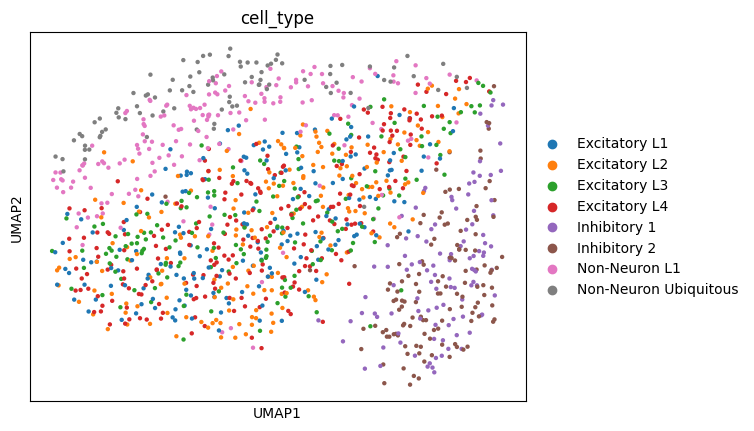

In [18]:
fig, ax = plt.subplots()
sc.pp.neighbors(datasets[0])
sc.tl.umap(datasets[0])
sc.pl.umap(datasets[0], color="cell_type", ax=ax, size=40)

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


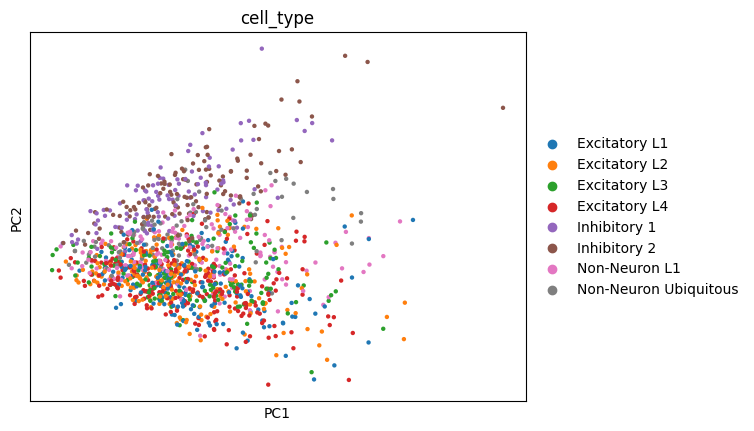

In [19]:
fig, ax = plt.subplots()
sc.tl.pca(datasets[0])
sc.pl.pca(datasets[0], color="cell_type", ax=ax, size=40)

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


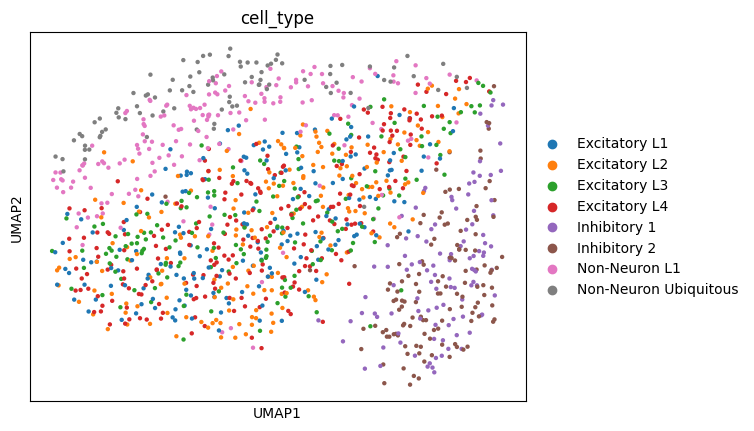

In [20]:
replicate_names, dataset_copies = zip(*multireplicate_dataset.datasets.items())
merged_dataset = ad.concat(dataset_copies, label="batch", keys=replicate_names, merge="unique", uns_merge="unique", pairwise=True)                                                                                                                                        
fig, ax = plt.subplots()
sc.pp.neighbors(merged_dataset)
sc.tl.umap(merged_dataset)
sc.pl.umap(merged_dataset, color="cell_type", ax=ax, size=40)

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


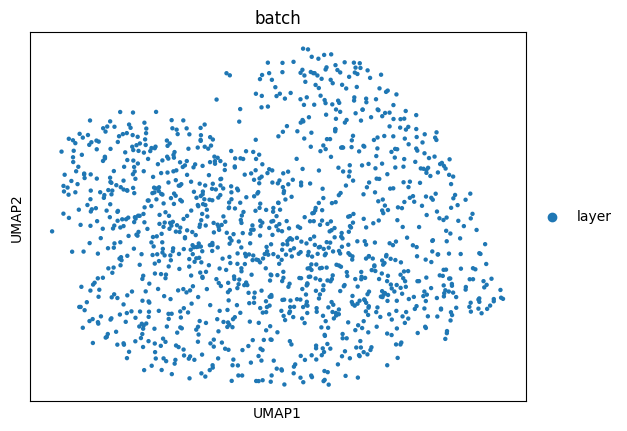

In [143]:
fig, ax = plt.subplots()
sc.pl.umap(merged_dataset, color="batch", ax=ax, size=40)

In [21]:
save_directory = Path("../../data/synthetic_cortex/final_hierarchical/")
save_directory.mkdir(exist_ok=True)
filepath = save_directory/ "processed_dataset.h5ad"
result = save_anndata(filepath, datasets)

In [22]:
from popari._dataset_utils import _plot_in_situ

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


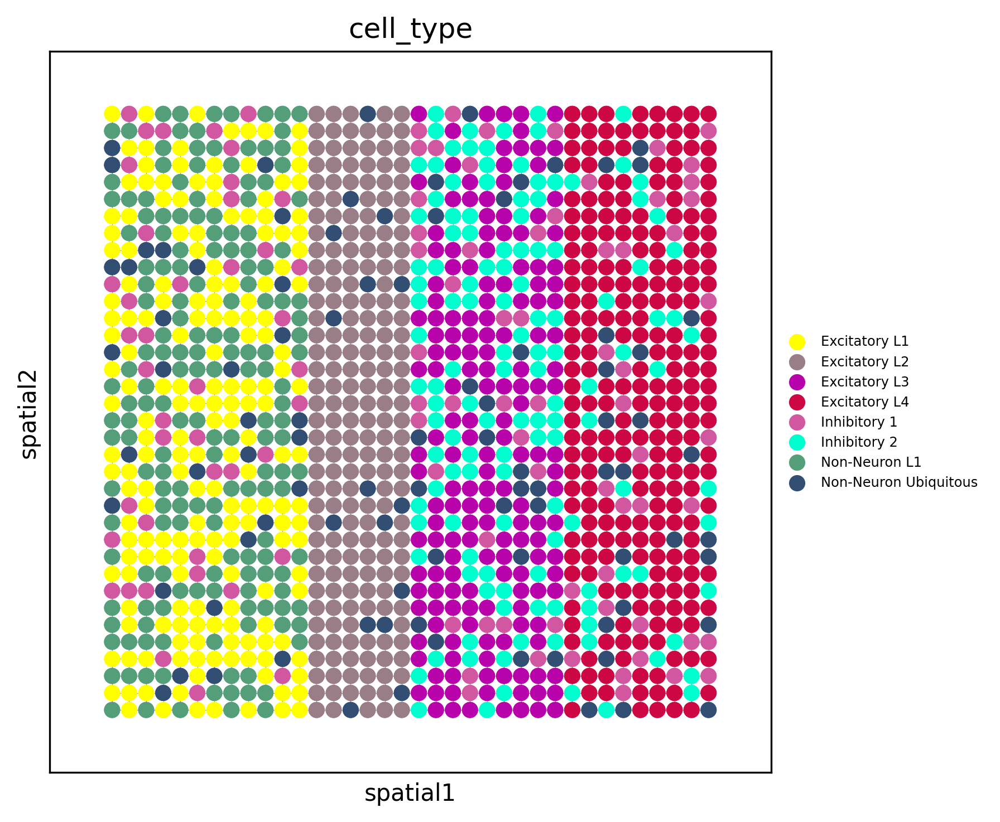

In [23]:
_ = _plot_in_situ(datasets, color="cell_type", size=25)

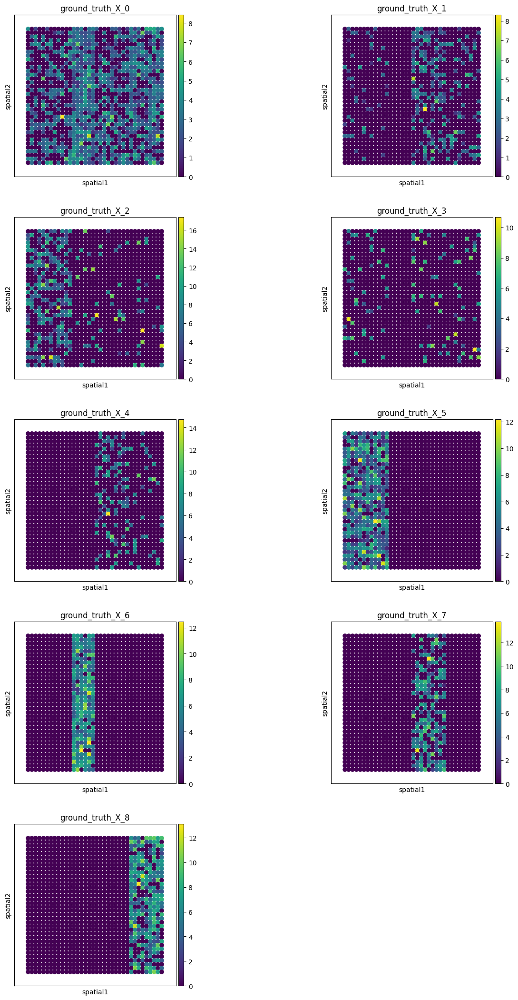

In [24]:
_ = _plot_all_embeddings(datasets[0], embedding_key="ground_truth_X", size=10)

In [25]:
# _ = _plot_all_embeddings(popari.datasets[1], embedding_key="ground_truth_X", size=20)

In [26]:
_compute_empirical_correlations(datasets, feature="ground_truth_X", output="ground_truth_correlation", scaling=10)   

(AnnData object with n_obs × n_vars = 1296 × 100
     obs: 'layer', 'cell_type', 'cell_type_encoded', 'adjacency_list'
     uns: 'domain_names', 'width', 'height', 'domain_distributions', 'metagene_variation_probabilities', 'cell_type_names', 'cell_type_definitions', 'domain_landmarks', 'ground_truth_M', 'spatial_neighbors', 'neighbors', 'umap', 'cell_type_colors', 'pca', 'adjacency_matrix', 'dataset_name', 'ground_truth_correlation'
     obsm: 'spatial', 'ground_truth_X', 'X_pca', 'X_umap'
     varm: 'PCs'
     obsp: 'spatial_connectivities', 'spatial_distances', 'adjacency_matrix', 'distances', 'connectivities',)

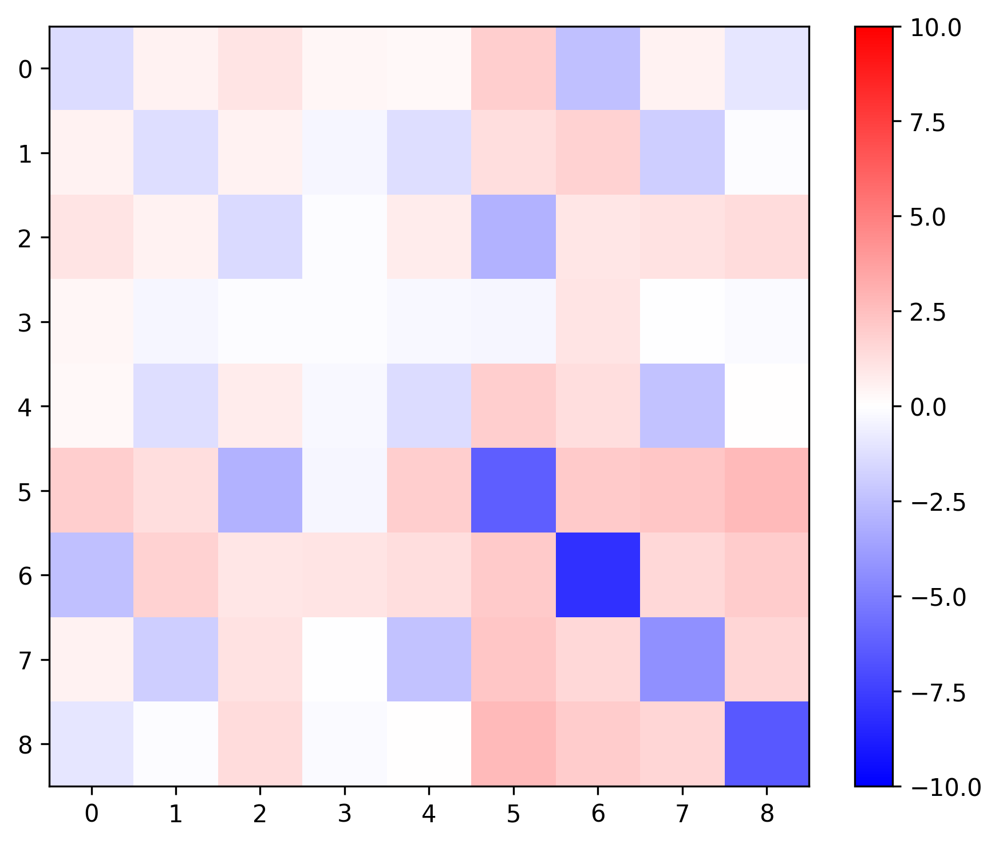

In [27]:
from popari._dataset_utils import _multireplicate_heatmap
_ = _multireplicate_heatmap(datasets, uns="ground_truth_correlation", cmap="bwr", vmin=-10, vmax=10)

## Test

In [28]:
import torch
from popari.model import Popari
from popari import pl, tl

from matplotlib import pyplot as plt

from popari._dataset_utils import _plot_all_embeddings

In [29]:
dataset_names = [dataset_name for dataset_name, _ in multireplicate_dataset.datasets.items()]

In [30]:
lambda_Sigma_x_inv=1e-4
torch_context={
    "dtype": torch.float64,
    "device": "cuda:0"
}
dataset_path = "../../data/synthetic_cortex/final_hierarchical/processed_dataset.h5ad"
K = 9
seed = 42
binning_downsample_rate = 0.2

nmf_preiterations = 10
num_iterations = 200

groups = {dataset_name: [dataset_name] for dataset_name in dataset_names}

In [31]:
# Initialize                                                                    
nmf = Popari(                                                                   
    K=K,                                                                        
    dataset_path=dataset_path,                                                                     
    lambda_Sigma_x_inv=lambda_Sigma_x_inv,                                      
    initial_context=torch_context,                                              
    torch_context=torch_context,
    initialization_method="leiden",
    verbose=1,               
    hierarchical_levels=1,  
    random_state=seed                                                           
)

spicemix = Popari(                                                              
    K=K,                                                                        
    dataset_path=dataset_path,                                                                        
    lambda_Sigma_x_inv=lambda_Sigma_x_inv,                                      
    initial_context=torch_context,                                              
    torch_context=torch_context,
    initialization_method="leiden",
    hierarchical_levels=1,
    verbose=1,                                                                  
    random_state=seed                                                           
)

hierarchical_spicemix = Popari(                                                              
    K=K,                                                                        
    dataset_path=dataset_path,                                                                        
    lambda_Sigma_x_inv=lambda_Sigma_x_inv,                                      
    initial_context=torch_context,                                              
    torch_context=torch_context,
    initialization_method="leiden",
    hierarchical_levels=2,
    superresolution_lr=1e-1,
    binning_downsample_rate=binning_downsample_rate,
    verbose=1,                                                                  
    random_state=seed                                                           
)    



models = (nmf, spicemix, hierarchical_spicemix)                                 
# models = (nmf, popari_hierarchical)   

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/popari/util.py:499: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:230.)
  i = torch.LongTensor(indices)


[2023/12/18 18:02:20]	 Initializing MetageneState
[2023/12/18 18:02:20]	 Initializing SpatialAffinityState
[2023/12/18 18:02:20]	 Initializing EmbeddingOptimizer
[2023/12/18 18:02:20]	 Initializing EmbeddingState
[2023/12/18 18:02:20]	 Initializing metagenes and hidden states using leiden method
Current number of clusters: 6
Resolution: 1.0
Current number of clusters: 37
Resolution: 3.1622776601683795
Current number of clusters: 12
Resolution: 1.7782794100389228
Current number of clusters: 9
Resolution: 1.333521432163324
[2023/12/18 18:02:28]	 Initializing Sigma_x_inv with empirical correlations
[2023/12/18 18:02:29]	 Initializing MetageneState
[2023/12/18 18:02:29]	 Initializing SpatialAffinityState
[2023/12/18 18:02:29]	 Initializing EmbeddingOptimizer
[2023/12/18 18:02:29]	 Initializing EmbeddingState
[2023/12/18 18:02:29]	 Initializing metagenes and hidden states using leiden method
Current number of clusters: 6
Resolution: 1.0
Current number of clusters: 37
Resolution: 3.162277660

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scipy/sparse/_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


[2023/12/18 18:02:32]	 Downsized dataset from 1296 to 289 spots.
[2023/12/18 18:02:32]	 Initializing MetageneState
[2023/12/18 18:02:32]	 Initializing SpatialAffinityState
[2023/12/18 18:02:32]	 Initializing EmbeddingOptimizer
[2023/12/18 18:02:32]	 Initializing EmbeddingState
[2023/12/18 18:02:32]	 Initializing metagenes and hidden states using leiden method
Current number of clusters: 7
Resolution: 1.0
Current number of clusters: 19
Resolution: 3.1622776601683795
Current number of clusters: 9
Resolution: 1.7782794100389228
[2023/12/18 18:02:32]	 Initializing Sigma_x_inv with empirical correlations


In [32]:
for iteration in range(nmf_preiterations): #NMF Initialization                  
    print(f"---- Iteration {iteration} ----")                                   
    for model in models:                                                        
        model.estimate_parameters(update_spatial_affinities=False)              
        model.estimate_weights(use_neighbors=False)                             

---- Iteration 0 ----
[2023/12/18 18:02:32]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:35]	 Updating sigma_yx
[2023/12/18 18:02:35]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:35]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:35]	 Updating sigma_yx
[2023/12/18 18:02:35]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:36]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:36]	 Updating sigma_yx
[2023/12/18 18:02:36]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 1 ----
[2023/12/18 18:02:36]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:36]	 Updating sigma_yx
[2023/12/18 18:02:36]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:37]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:37]	 Updating sigma_yx
[2023/12/18 18:02:37]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:38]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:38]	 Updating sigma_yx
[2023/12/18 18:02:38]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 2 ----
[2023/12/18 18:02:39]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:39]	 Updating sigma_yx
[2023/12/18 18:02:39]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:39]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:39]	 Updating sigma_yx
[2023/12/18 18:02:39]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:40]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:40]	 Updating sigma_yx
[2023/12/18 18:02:40]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 3 ----
[2023/12/18 18:02:40]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:40]	 Updating sigma_yx
[2023/12/18 18:02:40]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:41]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:41]	 Updating sigma_yx
[2023/12/18 18:02:41]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:41]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:41]	 Updating sigma_yx
[2023/12/18 18:02:41]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 4 ----
[2023/12/18 18:02:42]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:42]	 Updating sigma_yx
[2023/12/18 18:02:42]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:42]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:42]	 Updating sigma_yx
[2023/12/18 18:02:42]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:42]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:43]	 Updating sigma_yx
[2023/12/18 18:02:43]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 5 ----
[2023/12/18 18:02:43]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:43]	 Updating sigma_yx
[2023/12/18 18:02:43]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:44]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:44]	 Updating sigma_yx
[2023/12/18 18:02:44]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:44]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:44]	 Updating sigma_yx
[2023/12/18 18:02:44]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 6 ----
[2023/12/18 18:02:44]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:45]	 Updating sigma_yx
[2023/12/18 18:02:45]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:45]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:45]	 Updating sigma_yx
[2023/12/18 18:02:45]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:45]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:45]	 Updating sigma_yx
[2023/12/18 18:02:45]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 7 ----
[2023/12/18 18:02:46]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:46]	 Updating sigma_yx
[2023/12/18 18:02:46]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:46]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:46]	 Updating sigma_yx
[2023/12/18 18:02:46]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:46]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:46]	 Updating sigma_yx
[2023/12/18 18:02:46]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 8 ----
[2023/12/18 18:02:47]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:47]	 Updating sigma_yx
[2023/12/18 18:02:47]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:47]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:47]	 Updating sigma_yx
[2023/12/18 18:02:47]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:47]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:47]	 Updating sigma_yx
[2023/12/18 18:02:47]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 9 ----
[2023/12/18 18:02:48]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:48]	 Updating sigma_yx
[2023/12/18 18:02:48]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:48]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:48]	 Updating sigma_yx
[2023/12/18 18:02:48]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:02:48]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:48]	 Updating sigma_yx
[2023/12/18 18:02:48]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

In [33]:
for model in models:                                                            
    model.parameter_optimizer.reinitialize_spatial_affinities()                 
    model.synchronize_datasets()                                                

In [34]:
for iteration in range(num_iterations): #Finish training NMF                    
    print(f"---- Iteration {iteration} ----")                                   
    nmf.estimate_parameters(update_spatial_affinities=False)                    
    nmf.estimate_weights(use_neighbors=False)                                   

---- Iteration 0 ----
[2023/12/18 18:02:49]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:49]	 Updating sigma_yx
[2023/12/18 18:02:49]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 1 ----
[2023/12/18 18:02:49]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:49]	 Updating sigma_yx
[2023/12/18 18:02:49]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 2 ----
[2023/12/18 18:02:49]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:49]	 Updating sigma_yx
[2023/12/18 18:02:49]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 3 ----
[2023/12/18 18:02:49]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:49]	 Updating sigma_yx
[2023/12/18 18:02:49]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 4 ----
[2023/12/18 18:02:49]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:49]	 Updating sigma_yx
[2023/12/18 18:02:49]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 5 ----
[2023/12/18 18:02:50]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:50]	 Updating sigma_yx
[2023/12/18 18:02:50]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 6 ----
[2023/12/18 18:02:50]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:50]	 Updating sigma_yx
[2023/12/18 18:02:50]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 7 ----
[2023/12/18 18:02:50]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:50]	 Updating sigma_yx
[2023/12/18 18:02:50]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 8 ----
[2023/12/18 18:02:50]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:50]	 Updating sigma_yx
[2023/12/18 18:02:50]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 9 ----
[2023/12/18 18:02:50]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:50]	 Updating sigma_yx
[2023/12/18 18:02:50]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 10 ----
[2023/12/18 18:02:50]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:50]	 Updating sigma_yx
[2023/12/18 18:02:50]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 11 ----
[2023/12/18 18:02:51]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:51]	 Updating sigma_yx
[2023/12/18 18:02:51]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 12 ----
[2023/12/18 18:02:51]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:51]	 Updating sigma_yx
[2023/12/18 18:02:51]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 13 ----
[2023/12/18 18:02:51]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:51]	 Updating sigma_yx
[2023/12/18 18:02:51]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 14 ----
[2023/12/18 18:02:51]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:51]	 Updating sigma_yx
[2023/12/18 18:02:51]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 15 ----
[2023/12/18 18:02:51]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:51]	 Updating sigma_yx
[2023/12/18 18:02:51]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 16 ----
[2023/12/18 18:02:51]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:51]	 Updating sigma_yx
[2023/12/18 18:02:51]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 17 ----
[2023/12/18 18:02:51]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:52]	 Updating sigma_yx
[2023/12/18 18:02:52]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 18 ----
[2023/12/18 18:02:52]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:52]	 Updating sigma_yx
[2023/12/18 18:02:52]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 19 ----
[2023/12/18 18:02:52]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:52]	 Updating sigma_yx
[2023/12/18 18:02:52]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 20 ----
[2023/12/18 18:02:52]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:52]	 Updating sigma_yx
[2023/12/18 18:02:52]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 21 ----
[2023/12/18 18:02:52]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:52]	 Updating sigma_yx
[2023/12/18 18:02:52]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 22 ----
[2023/12/18 18:02:52]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:52]	 Updating sigma_yx
[2023/12/18 18:02:52]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 23 ----
[2023/12/18 18:02:52]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:52]	 Updating sigma_yx
[2023/12/18 18:02:52]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 24 ----
[2023/12/18 18:02:53]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:53]	 Updating sigma_yx
[2023/12/18 18:02:53]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 25 ----
[2023/12/18 18:02:53]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:53]	 Updating sigma_yx
[2023/12/18 18:02:53]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 26 ----
[2023/12/18 18:02:53]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:53]	 Updating sigma_yx
[2023/12/18 18:02:53]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 27 ----
[2023/12/18 18:02:53]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:53]	 Updating sigma_yx
[2023/12/18 18:02:53]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 28 ----
[2023/12/18 18:02:53]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:53]	 Updating sigma_yx
[2023/12/18 18:02:53]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 29 ----
[2023/12/18 18:02:53]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:53]	 Updating sigma_yx
[2023/12/18 18:02:53]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 30 ----
[2023/12/18 18:02:53]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:54]	 Updating sigma_yx
[2023/12/18 18:02:54]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 31 ----
[2023/12/18 18:02:54]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:54]	 Updating sigma_yx
[2023/12/18 18:02:54]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 32 ----
[2023/12/18 18:02:54]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:54]	 Updating sigma_yx
[2023/12/18 18:02:54]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 33 ----
[2023/12/18 18:02:54]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:54]	 Updating sigma_yx
[2023/12/18 18:02:54]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 34 ----
[2023/12/18 18:02:54]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:54]	 Updating sigma_yx
[2023/12/18 18:02:54]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 35 ----
[2023/12/18 18:02:54]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:54]	 Updating sigma_yx
[2023/12/18 18:02:54]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 36 ----
[2023/12/18 18:02:54]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:54]	 Updating sigma_yx
[2023/12/18 18:02:54]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 37 ----
[2023/12/18 18:02:55]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:55]	 Updating sigma_yx
[2023/12/18 18:02:55]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 38 ----
[2023/12/18 18:02:55]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:55]	 Updating sigma_yx
[2023/12/18 18:02:55]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 39 ----
[2023/12/18 18:02:55]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:55]	 Updating sigma_yx
[2023/12/18 18:02:55]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 40 ----
[2023/12/18 18:02:55]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:55]	 Updating sigma_yx
[2023/12/18 18:02:55]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 41 ----
[2023/12/18 18:02:55]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:55]	 Updating sigma_yx
[2023/12/18 18:02:55]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 42 ----
[2023/12/18 18:02:55]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:55]	 Updating sigma_yx
[2023/12/18 18:02:55]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 43 ----
[2023/12/18 18:02:55]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:55]	 Updating sigma_yx
[2023/12/18 18:02:55]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 44 ----
[2023/12/18 18:02:56]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:56]	 Updating sigma_yx
[2023/12/18 18:02:56]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 45 ----
[2023/12/18 18:02:56]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:56]	 Updating sigma_yx
[2023/12/18 18:02:56]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 46 ----
[2023/12/18 18:02:56]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:56]	 Updating sigma_yx
[2023/12/18 18:02:56]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 47 ----
[2023/12/18 18:02:56]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:56]	 Updating sigma_yx
[2023/12/18 18:02:56]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 48 ----
[2023/12/18 18:02:56]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:56]	 Updating sigma_yx
[2023/12/18 18:02:56]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 49 ----
[2023/12/18 18:02:56]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:56]	 Updating sigma_yx
[2023/12/18 18:02:56]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 50 ----
[2023/12/18 18:02:56]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:56]	 Updating sigma_yx
[2023/12/18 18:02:56]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 51 ----
[2023/12/18 18:02:57]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:57]	 Updating sigma_yx
[2023/12/18 18:02:57]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 52 ----
[2023/12/18 18:02:57]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:57]	 Updating sigma_yx
[2023/12/18 18:02:57]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 53 ----
[2023/12/18 18:02:57]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:57]	 Updating sigma_yx
[2023/12/18 18:02:57]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 54 ----
[2023/12/18 18:02:57]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:57]	 Updating sigma_yx
[2023/12/18 18:02:57]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 55 ----
[2023/12/18 18:02:57]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:57]	 Updating sigma_yx
[2023/12/18 18:02:57]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 56 ----
[2023/12/18 18:02:57]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:57]	 Updating sigma_yx
[2023/12/18 18:02:57]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 57 ----
[2023/12/18 18:02:57]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:57]	 Updating sigma_yx
[2023/12/18 18:02:57]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 58 ----
[2023/12/18 18:02:57]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:58]	 Updating sigma_yx
[2023/12/18 18:02:58]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 59 ----
[2023/12/18 18:02:58]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:58]	 Updating sigma_yx
[2023/12/18 18:02:58]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 60 ----
[2023/12/18 18:02:58]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:58]	 Updating sigma_yx
[2023/12/18 18:02:58]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 61 ----
[2023/12/18 18:02:58]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:58]	 Updating sigma_yx
[2023/12/18 18:02:58]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 62 ----
[2023/12/18 18:02:58]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:58]	 Updating sigma_yx
[2023/12/18 18:02:58]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 63 ----
[2023/12/18 18:02:58]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:58]	 Updating sigma_yx
[2023/12/18 18:02:58]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 64 ----
[2023/12/18 18:02:58]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:58]	 Updating sigma_yx
[2023/12/18 18:02:58]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 65 ----
[2023/12/18 18:02:58]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:58]	 Updating sigma_yx
[2023/12/18 18:02:58]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 66 ----
[2023/12/18 18:02:59]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:59]	 Updating sigma_yx
[2023/12/18 18:02:59]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 67 ----
[2023/12/18 18:02:59]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:59]	 Updating sigma_yx
[2023/12/18 18:02:59]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 68 ----
[2023/12/18 18:02:59]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:59]	 Updating sigma_yx
[2023/12/18 18:02:59]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 69 ----
[2023/12/18 18:02:59]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:59]	 Updating sigma_yx
[2023/12/18 18:02:59]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 70 ----
[2023/12/18 18:02:59]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:59]	 Updating sigma_yx
[2023/12/18 18:02:59]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 71 ----
[2023/12/18 18:02:59]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:59]	 Updating sigma_yx
[2023/12/18 18:02:59]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 72 ----
[2023/12/18 18:02:59]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:02:59]	 Updating sigma_yx
[2023/12/18 18:02:59]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 73 ----
[2023/12/18 18:03:00]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:00]	 Updating sigma_yx
[2023/12/18 18:03:00]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 74 ----
[2023/12/18 18:03:00]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:00]	 Updating sigma_yx
[2023/12/18 18:03:00]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 75 ----
[2023/12/18 18:03:00]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:00]	 Updating sigma_yx
[2023/12/18 18:03:00]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 76 ----
[2023/12/18 18:03:00]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:00]	 Updating sigma_yx
[2023/12/18 18:03:00]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 77 ----
[2023/12/18 18:03:00]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:00]	 Updating sigma_yx
[2023/12/18 18:03:00]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 78 ----
[2023/12/18 18:03:00]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:00]	 Updating sigma_yx
[2023/12/18 18:03:00]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 79 ----
[2023/12/18 18:03:00]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:00]	 Updating sigma_yx
[2023/12/18 18:03:00]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 80 ----
[2023/12/18 18:03:00]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:01]	 Updating sigma_yx
[2023/12/18 18:03:01]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 81 ----
[2023/12/18 18:03:01]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:01]	 Updating sigma_yx
[2023/12/18 18:03:01]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 82 ----
[2023/12/18 18:03:01]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:01]	 Updating sigma_yx
[2023/12/18 18:03:01]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 83 ----
[2023/12/18 18:03:01]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:01]	 Updating sigma_yx
[2023/12/18 18:03:01]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 84 ----
[2023/12/18 18:03:01]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:01]	 Updating sigma_yx
[2023/12/18 18:03:01]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 85 ----
[2023/12/18 18:03:01]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:01]	 Updating sigma_yx
[2023/12/18 18:03:01]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 86 ----
[2023/12/18 18:03:01]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:01]	 Updating sigma_yx
[2023/12/18 18:03:01]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 87 ----
[2023/12/18 18:03:01]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:02]	 Updating sigma_yx
[2023/12/18 18:03:02]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 88 ----
[2023/12/18 18:03:02]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:02]	 Updating sigma_yx
[2023/12/18 18:03:02]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 89 ----
[2023/12/18 18:03:02]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:02]	 Updating sigma_yx
[2023/12/18 18:03:02]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 90 ----
[2023/12/18 18:03:02]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:02]	 Updating sigma_yx
[2023/12/18 18:03:02]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 91 ----
[2023/12/18 18:03:02]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:02]	 Updating sigma_yx
[2023/12/18 18:03:02]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 92 ----
[2023/12/18 18:03:02]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:02]	 Updating sigma_yx
[2023/12/18 18:03:02]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 93 ----
[2023/12/18 18:03:02]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:02]	 Updating sigma_yx
[2023/12/18 18:03:02]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 94 ----
[2023/12/18 18:03:02]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:02]	 Updating sigma_yx
[2023/12/18 18:03:02]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 95 ----
[2023/12/18 18:03:03]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:03]	 Updating sigma_yx
[2023/12/18 18:03:03]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 96 ----
[2023/12/18 18:03:03]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:03]	 Updating sigma_yx
[2023/12/18 18:03:03]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 97 ----
[2023/12/18 18:03:03]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:03]	 Updating sigma_yx
[2023/12/18 18:03:03]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 98 ----
[2023/12/18 18:03:03]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:03]	 Updating sigma_yx
[2023/12/18 18:03:03]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 99 ----
[2023/12/18 18:03:03]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:03]	 Updating sigma_yx
[2023/12/18 18:03:03]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 100 ----
[2023/12/18 18:03:03]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:03]	 Updating sigma_yx
[2023/12/18 18:03:03]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 101 ----
[2023/12/18 18:03:03]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:03]	 Updating sigma_yx
[2023/12/18 18:03:03]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 102 ----
[2023/12/18 18:03:03]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:03]	 Updating sigma_yx
[2023/12/18 18:03:03]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 103 ----
[2023/12/18 18:03:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:04]	 Updating sigma_yx
[2023/12/18 18:03:04]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 104 ----
[2023/12/18 18:03:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:04]	 Updating sigma_yx
[2023/12/18 18:03:04]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 105 ----
[2023/12/18 18:03:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:04]	 Updating sigma_yx
[2023/12/18 18:03:04]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 106 ----
[2023/12/18 18:03:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:04]	 Updating sigma_yx
[2023/12/18 18:03:04]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 107 ----
[2023/12/18 18:03:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:04]	 Updating sigma_yx
[2023/12/18 18:03:04]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 108 ----
[2023/12/18 18:03:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:04]	 Updating sigma_yx
[2023/12/18 18:03:04]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 109 ----
[2023/12/18 18:03:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:04]	 Updating sigma_yx
[2023/12/18 18:03:04]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 110 ----
[2023/12/18 18:03:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:04]	 Updating sigma_yx
[2023/12/18 18:03:04]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 111 ----
[2023/12/18 18:03:05]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:05]	 Updating sigma_yx
[2023/12/18 18:03:05]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 112 ----
[2023/12/18 18:03:05]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:05]	 Updating sigma_yx
[2023/12/18 18:03:05]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 113 ----
[2023/12/18 18:03:05]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:05]	 Updating sigma_yx
[2023/12/18 18:03:05]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 114 ----
[2023/12/18 18:03:05]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:05]	 Updating sigma_yx
[2023/12/18 18:03:05]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 115 ----
[2023/12/18 18:03:05]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:05]	 Updating sigma_yx
[2023/12/18 18:03:05]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 116 ----
[2023/12/18 18:03:05]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:05]	 Updating sigma_yx
[2023/12/18 18:03:05]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 117 ----
[2023/12/18 18:03:05]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:05]	 Updating sigma_yx
[2023/12/18 18:03:05]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 118 ----
[2023/12/18 18:03:05]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:05]	 Updating sigma_yx
[2023/12/18 18:03:05]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 119 ----
[2023/12/18 18:03:06]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:06]	 Updating sigma_yx
[2023/12/18 18:03:06]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 120 ----
[2023/12/18 18:03:06]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:06]	 Updating sigma_yx
[2023/12/18 18:03:06]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 121 ----
[2023/12/18 18:03:06]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:06]	 Updating sigma_yx
[2023/12/18 18:03:06]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 122 ----
[2023/12/18 18:03:06]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:06]	 Updating sigma_yx
[2023/12/18 18:03:06]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 123 ----
[2023/12/18 18:03:06]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:06]	 Updating sigma_yx
[2023/12/18 18:03:06]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 124 ----
[2023/12/18 18:03:06]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:06]	 Updating sigma_yx
[2023/12/18 18:03:06]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 125 ----
[2023/12/18 18:03:06]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:06]	 Updating sigma_yx
[2023/12/18 18:03:06]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 126 ----
[2023/12/18 18:03:06]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:06]	 Updating sigma_yx
[2023/12/18 18:03:06]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 127 ----
[2023/12/18 18:03:06]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:07]	 Updating sigma_yx
[2023/12/18 18:03:07]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 128 ----
[2023/12/18 18:03:07]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:07]	 Updating sigma_yx
[2023/12/18 18:03:07]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 129 ----
[2023/12/18 18:03:07]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:07]	 Updating sigma_yx
[2023/12/18 18:03:07]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 130 ----
[2023/12/18 18:03:07]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:07]	 Updating sigma_yx
[2023/12/18 18:03:07]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 131 ----
[2023/12/18 18:03:07]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:07]	 Updating sigma_yx
[2023/12/18 18:03:07]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 132 ----
[2023/12/18 18:03:07]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:07]	 Updating sigma_yx
[2023/12/18 18:03:07]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 133 ----
[2023/12/18 18:03:07]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:07]	 Updating sigma_yx
[2023/12/18 18:03:07]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 134 ----
[2023/12/18 18:03:07]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:07]	 Updating sigma_yx
[2023/12/18 18:03:07]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 135 ----
[2023/12/18 18:03:07]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:07]	 Updating sigma_yx
[2023/12/18 18:03:07]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 136 ----
[2023/12/18 18:03:08]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:08]	 Updating sigma_yx
[2023/12/18 18:03:08]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 137 ----
[2023/12/18 18:03:08]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:08]	 Updating sigma_yx
[2023/12/18 18:03:08]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 138 ----
[2023/12/18 18:03:08]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:08]	 Updating sigma_yx
[2023/12/18 18:03:08]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 139 ----
[2023/12/18 18:03:08]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:08]	 Updating sigma_yx
[2023/12/18 18:03:08]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 140 ----
[2023/12/18 18:03:08]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:08]	 Updating sigma_yx
[2023/12/18 18:03:08]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 141 ----
[2023/12/18 18:03:08]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:08]	 Updating sigma_yx
[2023/12/18 18:03:08]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 142 ----
[2023/12/18 18:03:08]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:08]	 Updating sigma_yx
[2023/12/18 18:03:08]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 143 ----
[2023/12/18 18:03:08]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:08]	 Updating sigma_yx
[2023/12/18 18:03:08]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 144 ----
[2023/12/18 18:03:08]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:08]	 Updating sigma_yx
[2023/12/18 18:03:08]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 145 ----
[2023/12/18 18:03:09]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:09]	 Updating sigma_yx
[2023/12/18 18:03:09]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 146 ----
[2023/12/18 18:03:09]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:09]	 Updating sigma_yx
[2023/12/18 18:03:09]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 147 ----
[2023/12/18 18:03:09]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:09]	 Updating sigma_yx
[2023/12/18 18:03:09]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 148 ----
[2023/12/18 18:03:09]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:09]	 Updating sigma_yx
[2023/12/18 18:03:09]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 149 ----
[2023/12/18 18:03:09]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:09]	 Updating sigma_yx
[2023/12/18 18:03:09]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 150 ----
[2023/12/18 18:03:09]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:09]	 Updating sigma_yx
[2023/12/18 18:03:09]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 151 ----
[2023/12/18 18:03:09]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:09]	 Updating sigma_yx
[2023/12/18 18:03:09]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 152 ----
[2023/12/18 18:03:09]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:09]	 Updating sigma_yx
[2023/12/18 18:03:09]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 153 ----
[2023/12/18 18:03:09]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:10]	 Updating sigma_yx
[2023/12/18 18:03:10]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 154 ----
[2023/12/18 18:03:10]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:10]	 Updating sigma_yx
[2023/12/18 18:03:10]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 155 ----
[2023/12/18 18:03:10]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:10]	 Updating sigma_yx
[2023/12/18 18:03:10]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 156 ----
[2023/12/18 18:03:10]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:10]	 Updating sigma_yx
[2023/12/18 18:03:10]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 157 ----
[2023/12/18 18:03:10]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:10]	 Updating sigma_yx
[2023/12/18 18:03:10]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 158 ----
[2023/12/18 18:03:10]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:10]	 Updating sigma_yx
[2023/12/18 18:03:10]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 159 ----
[2023/12/18 18:03:10]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:10]	 Updating sigma_yx
[2023/12/18 18:03:10]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 160 ----
[2023/12/18 18:03:10]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:10]	 Updating sigma_yx
[2023/12/18 18:03:10]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 161 ----
[2023/12/18 18:03:10]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:10]	 Updating sigma_yx
[2023/12/18 18:03:10]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 162 ----
[2023/12/18 18:03:10]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:11]	 Updating sigma_yx
[2023/12/18 18:03:11]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 163 ----
[2023/12/18 18:03:11]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:11]	 Updating sigma_yx
[2023/12/18 18:03:11]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 164 ----
[2023/12/18 18:03:11]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:11]	 Updating sigma_yx
[2023/12/18 18:03:11]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 165 ----
[2023/12/18 18:03:11]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:11]	 Updating sigma_yx
[2023/12/18 18:03:11]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 166 ----
[2023/12/18 18:03:11]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:11]	 Updating sigma_yx
[2023/12/18 18:03:11]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 167 ----
[2023/12/18 18:03:11]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:11]	 Updating sigma_yx
[2023/12/18 18:03:11]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 168 ----
[2023/12/18 18:03:11]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:11]	 Updating sigma_yx
[2023/12/18 18:03:11]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 169 ----
[2023/12/18 18:03:11]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:11]	 Updating sigma_yx
[2023/12/18 18:03:11]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 170 ----
[2023/12/18 18:03:11]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:11]	 Updating sigma_yx
[2023/12/18 18:03:11]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 171 ----
[2023/12/18 18:03:11]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:12]	 Updating sigma_yx
[2023/12/18 18:03:12]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 172 ----
[2023/12/18 18:03:12]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:12]	 Updating sigma_yx
[2023/12/18 18:03:12]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 173 ----
[2023/12/18 18:03:12]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:12]	 Updating sigma_yx
[2023/12/18 18:03:12]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 174 ----
[2023/12/18 18:03:12]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:12]	 Updating sigma_yx
[2023/12/18 18:03:12]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 175 ----
[2023/12/18 18:03:12]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:12]	 Updating sigma_yx
[2023/12/18 18:03:12]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 176 ----
[2023/12/18 18:03:12]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:12]	 Updating sigma_yx
[2023/12/18 18:03:12]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 177 ----
[2023/12/18 18:03:12]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:12]	 Updating sigma_yx
[2023/12/18 18:03:12]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 178 ----
[2023/12/18 18:03:12]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:12]	 Updating sigma_yx
[2023/12/18 18:03:12]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 179 ----
[2023/12/18 18:03:12]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:12]	 Updating sigma_yx
[2023/12/18 18:03:12]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 180 ----
[2023/12/18 18:03:12]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:12]	 Updating sigma_yx
[2023/12/18 18:03:12]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 181 ----
[2023/12/18 18:03:13]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:13]	 Updating sigma_yx
[2023/12/18 18:03:13]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 182 ----
[2023/12/18 18:03:13]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:13]	 Updating sigma_yx
[2023/12/18 18:03:13]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 183 ----
[2023/12/18 18:03:13]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:13]	 Updating sigma_yx
[2023/12/18 18:03:13]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 184 ----
[2023/12/18 18:03:13]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:13]	 Updating sigma_yx
[2023/12/18 18:03:13]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 185 ----
[2023/12/18 18:03:13]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:13]	 Updating sigma_yx
[2023/12/18 18:03:13]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 186 ----
[2023/12/18 18:03:13]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:13]	 Updating sigma_yx
[2023/12/18 18:03:13]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 187 ----
[2023/12/18 18:03:13]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:13]	 Updating sigma_yx
[2023/12/18 18:03:13]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 188 ----
[2023/12/18 18:03:13]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:13]	 Updating sigma_yx
[2023/12/18 18:03:13]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 189 ----
[2023/12/18 18:03:13]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:14]	 Updating sigma_yx
[2023/12/18 18:03:14]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 190 ----
[2023/12/18 18:03:14]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:14]	 Updating sigma_yx
[2023/12/18 18:03:14]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 191 ----
[2023/12/18 18:03:14]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:14]	 Updating sigma_yx
[2023/12/18 18:03:14]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 192 ----
[2023/12/18 18:03:14]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:14]	 Updating sigma_yx
[2023/12/18 18:03:14]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 193 ----
[2023/12/18 18:03:14]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:14]	 Updating sigma_yx
[2023/12/18 18:03:14]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 194 ----
[2023/12/18 18:03:14]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:14]	 Updating sigma_yx
[2023/12/18 18:03:14]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 195 ----
[2023/12/18 18:03:14]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:14]	 Updating sigma_yx
[2023/12/18 18:03:14]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 196 ----
[2023/12/18 18:03:14]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:14]	 Updating sigma_yx
[2023/12/18 18:03:14]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 197 ----
[2023/12/18 18:03:14]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:14]	 Updating sigma_yx
[2023/12/18 18:03:14]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 198 ----
[2023/12/18 18:03:15]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:15]	 Updating sigma_yx
[2023/12/18 18:03:15]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 199 ----
[2023/12/18 18:03:15]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:15]	 Updating sigma_yx
[2023/12/18 18:03:15]	 Updating latent states


  0%|          | 0/1000 [00:00<?, ?it/s]

In [35]:
for iteration in range(num_iterations): # Train other models                    
    print(f"---- Iteration {iteration} ----") 
    for model in models[1:]:                                                    
        model.estimate_parameters()                                             
        model.estimate_weights()                                                

---- Iteration 0 ----
[2023/12/18 18:03:15]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:03:16]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:16]	 Updating sigma_yx
[2023/12/18 18:03:16]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:03:18]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:03:20]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:20]	 Updating sigma_yx
[2023/12/18 18:03:20]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 1 ----
[2023/12/18 18:03:21]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:03:22]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:22]	 Updating sigma_yx
[2023/12/18 18:03:22]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:03:23]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:03:25]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:25]	 Updating sigma_yx
[2023/12/18 18:03:25]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 2 ----
[2023/12/18 18:03:26]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:03:26]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:26]	 Updating sigma_yx
[2023/12/18 18:03:26]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:03:27]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:03:30]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:30]	 Updating sigma_yx
[2023/12/18 18:03:30]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 3 ----
[2023/12/18 18:03:31]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:03:37]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:37]	 Updating sigma_yx
[2023/12/18 18:03:37]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:03:43]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:03:48]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:48]	 Updating sigma_yx
[2023/12/18 18:03:48]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 4 ----
[2023/12/18 18:03:49]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:03:54]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:03:54]	 Updating sigma_yx
[2023/12/18 18:03:54]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:04:00]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:04:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:04:04]	 Updating sigma_yx
[2023/12/18 18:04:04]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 5 ----
[2023/12/18 18:04:05]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:04:08]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:04:08]	 Updating sigma_yx
[2023/12/18 18:04:08]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:04:15]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:04:16]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:04:16]	 Updating sigma_yx
[2023/12/18 18:04:16]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 6 ----
[2023/12/18 18:04:17]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:04:21]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:04:21]	 Updating sigma_yx
[2023/12/18 18:04:21]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:04:31]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:04:32]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:04:32]	 Updating sigma_yx
[2023/12/18 18:04:32]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 7 ----
[2023/12/18 18:04:33]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:04:37]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:04:37]	 Updating sigma_yx
[2023/12/18 18:04:37]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:04:42]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:04:43]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:04:43]	 Updating sigma_yx
[2023/12/18 18:04:43]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 8 ----
[2023/12/18 18:04:44]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:04:47]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:04:47]	 Updating sigma_yx
[2023/12/18 18:04:47]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:04:53]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:04:55]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:04:55]	 Updating sigma_yx
[2023/12/18 18:04:55]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 9 ----
[2023/12/18 18:04:56]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:04:59]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:04:59]	 Updating sigma_yx
[2023/12/18 18:04:59]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:05:04]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:05:06]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:05:06]	 Updating sigma_yx
[2023/12/18 18:05:06]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 10 ----
[2023/12/18 18:05:08]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:05:10]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:05:10]	 Updating sigma_yx
[2023/12/18 18:05:10]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:05:18]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:05:19]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:05:19]	 Updating sigma_yx
[2023/12/18 18:05:19]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 11 ----
[2023/12/18 18:05:21]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:05:23]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:05:23]	 Updating sigma_yx
[2023/12/18 18:05:23]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:05:30]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:05:31]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:05:31]	 Updating sigma_yx
[2023/12/18 18:05:32]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 12 ----
[2023/12/18 18:05:33]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:05:36]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:05:36]	 Updating sigma_yx
[2023/12/18 18:05:36]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:05:44]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:05:46]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:05:46]	 Updating sigma_yx
[2023/12/18 18:05:46]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 13 ----
[2023/12/18 18:05:54]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:05:58]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:05:58]	 Updating sigma_yx
[2023/12/18 18:05:58]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:06:06]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:06:09]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:06:09]	 Updating sigma_yx
[2023/12/18 18:06:09]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 14 ----
[2023/12/18 18:06:12]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:06:16]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:06:17]	 Updating sigma_yx
[2023/12/18 18:06:17]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:06:22]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:06:24]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:06:24]	 Updating sigma_yx
[2023/12/18 18:06:24]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 15 ----
[2023/12/18 18:06:28]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:06:35]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:06:35]	 Updating sigma_yx
[2023/12/18 18:06:35]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:06:38]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:06:41]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:06:42]	 Updating sigma_yx
[2023/12/18 18:06:42]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 16 ----
[2023/12/18 18:06:43]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:06:50]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:06:51]	 Updating sigma_yx
[2023/12/18 18:06:51]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:06:54]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:06:59]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:06:59]	 Updating sigma_yx
[2023/12/18 18:06:59]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 17 ----
[2023/12/18 18:07:01]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:07:05]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:07:06]	 Updating sigma_yx
[2023/12/18 18:07:06]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:07:11]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:07:14]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:07:14]	 Updating sigma_yx
[2023/12/18 18:07:14]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 18 ----
[2023/12/18 18:07:15]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:07:20]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:07:21]	 Updating sigma_yx
[2023/12/18 18:07:21]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:07:23]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:07:25]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:07:25]	 Updating sigma_yx
[2023/12/18 18:07:25]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 19 ----
[2023/12/18 18:07:26]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:07:31]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:07:32]	 Updating sigma_yx
[2023/12/18 18:07:32]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:07:34]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:07:35]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:07:35]	 Updating sigma_yx
[2023/12/18 18:07:35]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 20 ----
[2023/12/18 18:07:36]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:07:40]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:07:41]	 Updating sigma_yx
[2023/12/18 18:07:41]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:07:42]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:07:43]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:07:44]	 Updating sigma_yx
[2023/12/18 18:07:44]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 21 ----
[2023/12/18 18:07:45]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:07:50]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:07:51]	 Updating sigma_yx
[2023/12/18 18:07:51]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:07:52]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:07:54]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:07:54]	 Updating sigma_yx
[2023/12/18 18:07:54]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 22 ----
[2023/12/18 18:07:55]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:08:01]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:08:02]	 Updating sigma_yx
[2023/12/18 18:08:02]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:08:03]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:08:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:08:04]	 Updating sigma_yx
[2023/12/18 18:08:04]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 23 ----
[2023/12/18 18:08:05]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:08:11]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:08:12]	 Updating sigma_yx
[2023/12/18 18:08:12]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:08:13]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:08:14]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:08:15]	 Updating sigma_yx
[2023/12/18 18:08:15]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 24 ----
[2023/12/18 18:08:16]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:08:22]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:08:23]	 Updating sigma_yx
[2023/12/18 18:08:23]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:08:24]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:08:26]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:08:26]	 Updating sigma_yx
[2023/12/18 18:08:26]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 25 ----
[2023/12/18 18:08:27]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:08:33]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:08:34]	 Updating sigma_yx
[2023/12/18 18:08:34]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:08:35]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:08:36]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:08:37]	 Updating sigma_yx
[2023/12/18 18:08:37]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 26 ----
[2023/12/18 18:08:38]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:08:44]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:08:45]	 Updating sigma_yx
[2023/12/18 18:08:45]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:08:46]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:08:47]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:08:47]	 Updating sigma_yx
[2023/12/18 18:08:47]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 27 ----
[2023/12/18 18:08:50]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:08:57]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:08:58]	 Updating sigma_yx
[2023/12/18 18:08:58]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:08:58]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:00]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:00]	 Updating sigma_yx
[2023/12/18 18:09:00]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 28 ----
[2023/12/18 18:09:00]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:07]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:07]	 Updating sigma_yx
[2023/12/18 18:09:07]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:07]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:08]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:08]	 Updating sigma_yx
[2023/12/18 18:09:08]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 29 ----
[2023/12/18 18:09:09]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:15]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:15]	 Updating sigma_yx
[2023/12/18 18:09:15]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:15]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:17]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:17]	 Updating sigma_yx
[2023/12/18 18:09:17]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 30 ----
[2023/12/18 18:09:17]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:23]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:23]	 Updating sigma_yx
[2023/12/18 18:09:23]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:23]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:24]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:24]	 Updating sigma_yx
[2023/12/18 18:09:24]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 31 ----
[2023/12/18 18:09:25]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:25]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:25]	 Updating sigma_yx
[2023/12/18 18:09:25]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:25]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:26]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:27]	 Updating sigma_yx
[2023/12/18 18:09:27]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 32 ----
[2023/12/18 18:09:27]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:28]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:28]	 Updating sigma_yx
[2023/12/18 18:09:28]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:28]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:29]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:29]	 Updating sigma_yx
[2023/12/18 18:09:29]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 33 ----
[2023/12/18 18:09:29]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:30]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:30]	 Updating sigma_yx
[2023/12/18 18:09:30]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:30]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:31]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:31]	 Updating sigma_yx
[2023/12/18 18:09:31]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 34 ----
[2023/12/18 18:09:32]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:32]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:32]	 Updating sigma_yx
[2023/12/18 18:09:32]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:32]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:33]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:33]	 Updating sigma_yx
[2023/12/18 18:09:33]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 35 ----
[2023/12/18 18:09:34]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:34]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:34]	 Updating sigma_yx
[2023/12/18 18:09:34]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:34]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:36]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:36]	 Updating sigma_yx
[2023/12/18 18:09:36]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 36 ----
[2023/12/18 18:09:37]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:37]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:37]	 Updating sigma_yx
[2023/12/18 18:09:37]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:37]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:38]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:38]	 Updating sigma_yx
[2023/12/18 18:09:38]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 37 ----
[2023/12/18 18:09:39]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:39]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:39]	 Updating sigma_yx
[2023/12/18 18:09:39]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:39]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:41]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:41]	 Updating sigma_yx
[2023/12/18 18:09:41]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 38 ----
[2023/12/18 18:09:42]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:42]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:42]	 Updating sigma_yx
[2023/12/18 18:09:42]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:42]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:43]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:44]	 Updating sigma_yx
[2023/12/18 18:09:44]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 39 ----
[2023/12/18 18:09:44]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:45]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:45]	 Updating sigma_yx
[2023/12/18 18:09:45]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:45]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:46]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:46]	 Updating sigma_yx
[2023/12/18 18:09:46]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 40 ----
[2023/12/18 18:09:47]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:47]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:47]	 Updating sigma_yx
[2023/12/18 18:09:47]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:47]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:48]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:49]	 Updating sigma_yx
[2023/12/18 18:09:49]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 41 ----
[2023/12/18 18:09:49]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:50]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:50]	 Updating sigma_yx
[2023/12/18 18:09:50]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:50]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:51]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:51]	 Updating sigma_yx
[2023/12/18 18:09:51]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 42 ----
[2023/12/18 18:09:52]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:52]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:52]	 Updating sigma_yx
[2023/12/18 18:09:52]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:52]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:54]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:54]	 Updating sigma_yx
[2023/12/18 18:09:54]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 43 ----
[2023/12/18 18:09:55]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:55]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:55]	 Updating sigma_yx
[2023/12/18 18:09:55]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:55]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:57]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:57]	 Updating sigma_yx
[2023/12/18 18:09:57]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 44 ----
[2023/12/18 18:09:58]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:58]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:09:58]	 Updating sigma_yx
[2023/12/18 18:09:58]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:09:58]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:00]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:00]	 Updating sigma_yx
[2023/12/18 18:10:00]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 45 ----
[2023/12/18 18:10:01]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:01]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:01]	 Updating sigma_yx
[2023/12/18 18:10:01]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:01]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:05]	 Updating sigma_yx
[2023/12/18 18:10:05]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 46 ----
[2023/12/18 18:10:05]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:06]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:06]	 Updating sigma_yx
[2023/12/18 18:10:06]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:06]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:09]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:09]	 Updating sigma_yx
[2023/12/18 18:10:09]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 47 ----
[2023/12/18 18:10:10]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:10]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:10]	 Updating sigma_yx
[2023/12/18 18:10:10]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:10]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:13]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:14]	 Updating sigma_yx
[2023/12/18 18:10:14]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 48 ----
[2023/12/18 18:10:14]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:15]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:15]	 Updating sigma_yx
[2023/12/18 18:10:15]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:15]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:17]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:17]	 Updating sigma_yx
[2023/12/18 18:10:18]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 49 ----
[2023/12/18 18:10:18]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:18]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:18]	 Updating sigma_yx
[2023/12/18 18:10:18]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:18]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:20]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:20]	 Updating sigma_yx
[2023/12/18 18:10:20]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 50 ----
[2023/12/18 18:10:21]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:21]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:21]	 Updating sigma_yx
[2023/12/18 18:10:21]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:21]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:22]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:23]	 Updating sigma_yx
[2023/12/18 18:10:23]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 51 ----
[2023/12/18 18:10:23]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:24]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:24]	 Updating sigma_yx
[2023/12/18 18:10:24]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:24]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:24]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:25]	 Updating sigma_yx
[2023/12/18 18:10:25]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 52 ----
[2023/12/18 18:10:25]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:25]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:26]	 Updating sigma_yx
[2023/12/18 18:10:26]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:26]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:26]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:27]	 Updating sigma_yx
[2023/12/18 18:10:27]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 53 ----
[2023/12/18 18:10:27]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:27]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:27]	 Updating sigma_yx
[2023/12/18 18:10:27]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:27]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:28]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:29]	 Updating sigma_yx
[2023/12/18 18:10:29]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 54 ----
[2023/12/18 18:10:29]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:29]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:29]	 Updating sigma_yx
[2023/12/18 18:10:29]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:29]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:30]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:31]	 Updating sigma_yx
[2023/12/18 18:10:31]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 55 ----
[2023/12/18 18:10:31]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:31]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:31]	 Updating sigma_yx
[2023/12/18 18:10:31]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:32]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:32]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:33]	 Updating sigma_yx
[2023/12/18 18:10:33]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 56 ----
[2023/12/18 18:10:33]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:34]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:34]	 Updating sigma_yx
[2023/12/18 18:10:34]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:34]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:34]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:35]	 Updating sigma_yx
[2023/12/18 18:10:35]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 57 ----
[2023/12/18 18:10:35]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:36]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:36]	 Updating sigma_yx
[2023/12/18 18:10:36]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:36]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:36]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:37]	 Updating sigma_yx
[2023/12/18 18:10:37]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 58 ----
[2023/12/18 18:10:38]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:38]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:38]	 Updating sigma_yx
[2023/12/18 18:10:38]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:38]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:39]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:39]	 Updating sigma_yx
[2023/12/18 18:10:39]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 59 ----
[2023/12/18 18:10:40]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:40]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:40]	 Updating sigma_yx
[2023/12/18 18:10:40]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:40]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:41]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:41]	 Updating sigma_yx
[2023/12/18 18:10:41]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 60 ----
[2023/12/18 18:10:42]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:42]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:42]	 Updating sigma_yx
[2023/12/18 18:10:42]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:42]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:43]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:44]	 Updating sigma_yx
[2023/12/18 18:10:44]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 61 ----
[2023/12/18 18:10:44]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:45]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:45]	 Updating sigma_yx
[2023/12/18 18:10:45]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:45]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:45]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:46]	 Updating sigma_yx
[2023/12/18 18:10:46]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 62 ----
[2023/12/18 18:10:47]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:47]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:47]	 Updating sigma_yx
[2023/12/18 18:10:47]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:47]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:48]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:49]	 Updating sigma_yx
[2023/12/18 18:10:49]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 63 ----
[2023/12/18 18:10:49]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:49]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:49]	 Updating sigma_yx
[2023/12/18 18:10:49]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:49]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:50]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:50]	 Updating sigma_yx
[2023/12/18 18:10:50]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 64 ----
[2023/12/18 18:10:51]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:51]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:51]	 Updating sigma_yx
[2023/12/18 18:10:51]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:51]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:52]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:52]	 Updating sigma_yx
[2023/12/18 18:10:52]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 65 ----
[2023/12/18 18:10:53]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:53]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:53]	 Updating sigma_yx
[2023/12/18 18:10:53]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:53]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:54]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:54]	 Updating sigma_yx
[2023/12/18 18:10:54]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 66 ----
[2023/12/18 18:10:54]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:54]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:54]	 Updating sigma_yx
[2023/12/18 18:10:55]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:55]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:55]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:55]	 Updating sigma_yx
[2023/12/18 18:10:55]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 67 ----
[2023/12/18 18:10:56]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:56]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:56]	 Updating sigma_yx
[2023/12/18 18:10:56]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:56]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:57]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:57]	 Updating sigma_yx
[2023/12/18 18:10:57]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 68 ----
[2023/12/18 18:10:57]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:58]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:58]	 Updating sigma_yx
[2023/12/18 18:10:58]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:58]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:10:59]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:10:59]	 Updating sigma_yx
[2023/12/18 18:10:59]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 69 ----
[2023/12/18 18:11:00]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:00]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:00]	 Updating sigma_yx
[2023/12/18 18:11:00]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:00]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:01]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:01]	 Updating sigma_yx
[2023/12/18 18:11:01]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 70 ----
[2023/12/18 18:11:01]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:01]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:01]	 Updating sigma_yx
[2023/12/18 18:11:01]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:01]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:02]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:02]	 Updating sigma_yx
[2023/12/18 18:11:02]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 71 ----
[2023/12/18 18:11:03]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:03]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:03]	 Updating sigma_yx
[2023/12/18 18:11:03]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:03]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:04]	 Updating sigma_yx
[2023/12/18 18:11:04]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 72 ----
[2023/12/18 18:11:04]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:04]	 Updating sigma_yx
[2023/12/18 18:11:04]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:04]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:05]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:05]	 Updating sigma_yx
[2023/12/18 18:11:05]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 73 ----
[2023/12/18 18:11:06]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:06]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:06]	 Updating sigma_yx
[2023/12/18 18:11:06]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:06]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:07]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:07]	 Updating sigma_yx
[2023/12/18 18:11:07]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 74 ----
[2023/12/18 18:11:07]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:07]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:07]	 Updating sigma_yx
[2023/12/18 18:11:07]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:07]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:08]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:08]	 Updating sigma_yx
[2023/12/18 18:11:08]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 75 ----
[2023/12/18 18:11:09]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:09]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:09]	 Updating sigma_yx
[2023/12/18 18:11:09]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:09]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:10]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:10]	 Updating sigma_yx
[2023/12/18 18:11:10]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 76 ----
[2023/12/18 18:11:10]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:11]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:11]	 Updating sigma_yx
[2023/12/18 18:11:11]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:11]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:11]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:11]	 Updating sigma_yx
[2023/12/18 18:11:11]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 77 ----
[2023/12/18 18:11:12]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:12]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:12]	 Updating sigma_yx
[2023/12/18 18:11:12]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:12]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:13]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:13]	 Updating sigma_yx
[2023/12/18 18:11:13]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 78 ----
[2023/12/18 18:11:14]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:14]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:14]	 Updating sigma_yx
[2023/12/18 18:11:14]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:14]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:15]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:15]	 Updating sigma_yx
[2023/12/18 18:11:15]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 79 ----
[2023/12/18 18:11:15]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:15]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:15]	 Updating sigma_yx
[2023/12/18 18:11:15]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:15]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:16]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:16]	 Updating sigma_yx
[2023/12/18 18:11:16]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 80 ----
[2023/12/18 18:11:17]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:17]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:17]	 Updating sigma_yx
[2023/12/18 18:11:17]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:17]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:18]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:18]	 Updating sigma_yx
[2023/12/18 18:11:18]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 81 ----
[2023/12/18 18:11:18]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:18]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:18]	 Updating sigma_yx
[2023/12/18 18:11:18]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:19]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:19]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:19]	 Updating sigma_yx
[2023/12/18 18:11:19]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 82 ----
[2023/12/18 18:11:20]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:20]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:20]	 Updating sigma_yx
[2023/12/18 18:11:20]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:20]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:21]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:21]	 Updating sigma_yx
[2023/12/18 18:11:21]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 83 ----
[2023/12/18 18:11:21]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:21]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:22]	 Updating sigma_yx
[2023/12/18 18:11:22]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:22]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:22]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:22]	 Updating sigma_yx
[2023/12/18 18:11:22]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 84 ----
[2023/12/18 18:11:23]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:23]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:23]	 Updating sigma_yx
[2023/12/18 18:11:23]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:23]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:24]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:24]	 Updating sigma_yx
[2023/12/18 18:11:24]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 85 ----
[2023/12/18 18:11:24]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:25]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:25]	 Updating sigma_yx
[2023/12/18 18:11:25]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:25]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:25]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:25]	 Updating sigma_yx
[2023/12/18 18:11:25]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 86 ----
[2023/12/18 18:11:26]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:26]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:26]	 Updating sigma_yx
[2023/12/18 18:11:26]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:26]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:27]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:27]	 Updating sigma_yx
[2023/12/18 18:11:27]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 87 ----
[2023/12/18 18:11:27]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:28]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:28]	 Updating sigma_yx
[2023/12/18 18:11:28]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:28]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:28]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:29]	 Updating sigma_yx
[2023/12/18 18:11:29]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 88 ----
[2023/12/18 18:11:29]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:29]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:29]	 Updating sigma_yx
[2023/12/18 18:11:29]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:29]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:30]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:30]	 Updating sigma_yx
[2023/12/18 18:11:30]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 89 ----
[2023/12/18 18:11:30]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:31]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:31]	 Updating sigma_yx
[2023/12/18 18:11:31]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:31]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:31]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:32]	 Updating sigma_yx
[2023/12/18 18:11:32]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 90 ----
[2023/12/18 18:11:32]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:32]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:32]	 Updating sigma_yx
[2023/12/18 18:11:32]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:32]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:33]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:33]	 Updating sigma_yx
[2023/12/18 18:11:33]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 91 ----
[2023/12/18 18:11:34]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:34]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:34]	 Updating sigma_yx
[2023/12/18 18:11:34]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:34]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:35]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:35]	 Updating sigma_yx
[2023/12/18 18:11:35]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 92 ----
[2023/12/18 18:11:35]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:36]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:36]	 Updating sigma_yx
[2023/12/18 18:11:36]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:36]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:36]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:36]	 Updating sigma_yx
[2023/12/18 18:11:36]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 93 ----
[2023/12/18 18:11:37]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:37]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:37]	 Updating sigma_yx
[2023/12/18 18:11:37]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:37]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:38]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:38]	 Updating sigma_yx
[2023/12/18 18:11:38]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 94 ----
[2023/12/18 18:11:38]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:39]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:39]	 Updating sigma_yx
[2023/12/18 18:11:39]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:39]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:39]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:39]	 Updating sigma_yx
[2023/12/18 18:11:39]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 95 ----
[2023/12/18 18:11:40]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:40]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:40]	 Updating sigma_yx
[2023/12/18 18:11:40]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:40]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:41]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:41]	 Updating sigma_yx
[2023/12/18 18:11:41]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 96 ----
[2023/12/18 18:11:41]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:42]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:42]	 Updating sigma_yx
[2023/12/18 18:11:42]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:42]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:42]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:42]	 Updating sigma_yx
[2023/12/18 18:11:42]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 97 ----
[2023/12/18 18:11:43]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:43]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:43]	 Updating sigma_yx
[2023/12/18 18:11:43]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:43]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:44]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:44]	 Updating sigma_yx
[2023/12/18 18:11:44]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 98 ----
[2023/12/18 18:11:44]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:45]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:45]	 Updating sigma_yx
[2023/12/18 18:11:45]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:45]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:45]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:45]	 Updating sigma_yx
[2023/12/18 18:11:45]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 99 ----
[2023/12/18 18:11:46]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:46]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:46]	 Updating sigma_yx
[2023/12/18 18:11:46]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:46]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:47]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:47]	 Updating sigma_yx
[2023/12/18 18:11:47]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 100 ----
[2023/12/18 18:11:47]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:48]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:48]	 Updating sigma_yx
[2023/12/18 18:11:48]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:48]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:48]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:48]	 Updating sigma_yx
[2023/12/18 18:11:48]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 101 ----
[2023/12/18 18:11:49]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:49]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:49]	 Updating sigma_yx
[2023/12/18 18:11:49]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:49]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:50]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:50]	 Updating sigma_yx
[2023/12/18 18:11:50]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 102 ----
[2023/12/18 18:11:50]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:51]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:51]	 Updating sigma_yx
[2023/12/18 18:11:51]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:51]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:51]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:51]	 Updating sigma_yx
[2023/12/18 18:11:51]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 103 ----
[2023/12/18 18:11:52]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:52]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:52]	 Updating sigma_yx
[2023/12/18 18:11:52]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:52]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:53]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:53]	 Updating sigma_yx
[2023/12/18 18:11:53]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 104 ----
[2023/12/18 18:11:54]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:54]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:54]	 Updating sigma_yx
[2023/12/18 18:11:54]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:54]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:55]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:55]	 Updating sigma_yx
[2023/12/18 18:11:55]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 105 ----
[2023/12/18 18:11:55]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:55]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:56]	 Updating sigma_yx
[2023/12/18 18:11:56]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:56]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:56]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:56]	 Updating sigma_yx
[2023/12/18 18:11:56]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 106 ----
[2023/12/18 18:11:57]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:57]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:57]	 Updating sigma_yx
[2023/12/18 18:11:57]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:57]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:58]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:58]	 Updating sigma_yx
[2023/12/18 18:11:58]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 107 ----
[2023/12/18 18:11:58]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:59]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:59]	 Updating sigma_yx
[2023/12/18 18:11:59]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:59]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:11:59]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:11:59]	 Updating sigma_yx
[2023/12/18 18:11:59]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 108 ----
[2023/12/18 18:12:00]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:00]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:00]	 Updating sigma_yx
[2023/12/18 18:12:00]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:00]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:01]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:01]	 Updating sigma_yx
[2023/12/18 18:12:01]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 109 ----
[2023/12/18 18:12:01]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:02]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:02]	 Updating sigma_yx
[2023/12/18 18:12:02]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:02]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:02]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:02]	 Updating sigma_yx
[2023/12/18 18:12:02]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 110 ----
[2023/12/18 18:12:03]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:03]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:03]	 Updating sigma_yx
[2023/12/18 18:12:03]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:03]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:04]	 Updating sigma_yx
[2023/12/18 18:12:04]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 111 ----
[2023/12/18 18:12:04]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:05]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:05]	 Updating sigma_yx
[2023/12/18 18:12:05]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:05]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:05]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:05]	 Updating sigma_yx
[2023/12/18 18:12:05]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 112 ----
[2023/12/18 18:12:06]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:06]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:06]	 Updating sigma_yx
[2023/12/18 18:12:06]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:06]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:07]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:07]	 Updating sigma_yx
[2023/12/18 18:12:07]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 113 ----
[2023/12/18 18:12:07]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:08]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:08]	 Updating sigma_yx
[2023/12/18 18:12:08]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:08]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:08]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:08]	 Updating sigma_yx
[2023/12/18 18:12:08]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 114 ----
[2023/12/18 18:12:09]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:09]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:09]	 Updating sigma_yx
[2023/12/18 18:12:09]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:09]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:10]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:10]	 Updating sigma_yx
[2023/12/18 18:12:10]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 115 ----
[2023/12/18 18:12:10]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:11]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:11]	 Updating sigma_yx
[2023/12/18 18:12:11]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:11]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:11]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:11]	 Updating sigma_yx
[2023/12/18 18:12:12]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 116 ----
[2023/12/18 18:12:12]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:12]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:12]	 Updating sigma_yx
[2023/12/18 18:12:12]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:12]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:13]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:13]	 Updating sigma_yx
[2023/12/18 18:12:13]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 117 ----
[2023/12/18 18:12:13]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:14]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:14]	 Updating sigma_yx
[2023/12/18 18:12:14]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:14]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:14]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:15]	 Updating sigma_yx
[2023/12/18 18:12:15]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 118 ----
[2023/12/18 18:12:15]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:15]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:15]	 Updating sigma_yx
[2023/12/18 18:12:15]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:15]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:16]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:16]	 Updating sigma_yx
[2023/12/18 18:12:16]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 119 ----
[2023/12/18 18:12:17]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:17]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:17]	 Updating sigma_yx
[2023/12/18 18:12:17]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:17]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:18]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:18]	 Updating sigma_yx
[2023/12/18 18:12:18]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 120 ----
[2023/12/18 18:12:18]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:18]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:18]	 Updating sigma_yx
[2023/12/18 18:12:18]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:19]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:19]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:19]	 Updating sigma_yx
[2023/12/18 18:12:19]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 121 ----
[2023/12/18 18:12:20]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:20]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:20]	 Updating sigma_yx
[2023/12/18 18:12:20]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:20]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:21]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:21]	 Updating sigma_yx
[2023/12/18 18:12:21]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 122 ----
[2023/12/18 18:12:21]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:22]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:22]	 Updating sigma_yx
[2023/12/18 18:12:22]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:22]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:22]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:22]	 Updating sigma_yx
[2023/12/18 18:12:22]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 123 ----
[2023/12/18 18:12:23]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:23]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:23]	 Updating sigma_yx
[2023/12/18 18:12:23]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:23]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:24]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:24]	 Updating sigma_yx
[2023/12/18 18:12:24]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 124 ----
[2023/12/18 18:12:24]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:25]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:25]	 Updating sigma_yx
[2023/12/18 18:12:25]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:25]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:25]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:25]	 Updating sigma_yx
[2023/12/18 18:12:25]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 125 ----
[2023/12/18 18:12:26]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:26]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:26]	 Updating sigma_yx
[2023/12/18 18:12:26]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:26]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:27]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:27]	 Updating sigma_yx
[2023/12/18 18:12:27]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 126 ----
[2023/12/18 18:12:27]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:28]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:28]	 Updating sigma_yx
[2023/12/18 18:12:28]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:28]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:28]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:29]	 Updating sigma_yx
[2023/12/18 18:12:29]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 127 ----
[2023/12/18 18:12:29]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:29]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:29]	 Updating sigma_yx
[2023/12/18 18:12:29]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:29]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:30]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:30]	 Updating sigma_yx
[2023/12/18 18:12:30]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 128 ----
[2023/12/18 18:12:31]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:31]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:31]	 Updating sigma_yx
[2023/12/18 18:12:31]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:31]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:32]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:32]	 Updating sigma_yx
[2023/12/18 18:12:32]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 129 ----
[2023/12/18 18:12:32]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:33]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:33]	 Updating sigma_yx
[2023/12/18 18:12:33]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:33]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:33]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:33]	 Updating sigma_yx
[2023/12/18 18:12:33]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 130 ----
[2023/12/18 18:12:34]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:34]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:34]	 Updating sigma_yx
[2023/12/18 18:12:34]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:34]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:35]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:35]	 Updating sigma_yx
[2023/12/18 18:12:35]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 131 ----
[2023/12/18 18:12:36]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:36]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:36]	 Updating sigma_yx
[2023/12/18 18:12:36]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:36]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:37]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:37]	 Updating sigma_yx
[2023/12/18 18:12:37]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 132 ----
[2023/12/18 18:12:37]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:38]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:38]	 Updating sigma_yx
[2023/12/18 18:12:38]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:38]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:39]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:39]	 Updating sigma_yx
[2023/12/18 18:12:39]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 133 ----
[2023/12/18 18:12:39]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:39]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:40]	 Updating sigma_yx
[2023/12/18 18:12:40]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:40]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:40]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:41]	 Updating sigma_yx
[2023/12/18 18:12:41]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 134 ----
[2023/12/18 18:12:41]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:41]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:41]	 Updating sigma_yx
[2023/12/18 18:12:41]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:41]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:42]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:42]	 Updating sigma_yx
[2023/12/18 18:12:42]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 135 ----
[2023/12/18 18:12:43]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:43]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:43]	 Updating sigma_yx
[2023/12/18 18:12:43]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:43]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:44]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:44]	 Updating sigma_yx
[2023/12/18 18:12:44]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 136 ----
[2023/12/18 18:12:45]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:45]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:45]	 Updating sigma_yx
[2023/12/18 18:12:45]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:45]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:46]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:46]	 Updating sigma_yx
[2023/12/18 18:12:46]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 137 ----
[2023/12/18 18:12:47]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:47]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:47]	 Updating sigma_yx
[2023/12/18 18:12:47]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:47]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:48]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:48]	 Updating sigma_yx
[2023/12/18 18:12:48]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 138 ----
[2023/12/18 18:12:48]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:49]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:49]	 Updating sigma_yx
[2023/12/18 18:12:49]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:49]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:50]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:50]	 Updating sigma_yx
[2023/12/18 18:12:50]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 139 ----
[2023/12/18 18:12:50]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:51]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:51]	 Updating sigma_yx
[2023/12/18 18:12:51]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:51]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:52]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:52]	 Updating sigma_yx
[2023/12/18 18:12:52]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 140 ----
[2023/12/18 18:12:52]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:53]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:53]	 Updating sigma_yx
[2023/12/18 18:12:53]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:53]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:54]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:54]	 Updating sigma_yx
[2023/12/18 18:12:54]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 141 ----
[2023/12/18 18:12:54]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:54]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:54]	 Updating sigma_yx
[2023/12/18 18:12:54]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:54]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:55]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:55]	 Updating sigma_yx
[2023/12/18 18:12:55]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 142 ----
[2023/12/18 18:12:56]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:56]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:56]	 Updating sigma_yx
[2023/12/18 18:12:56]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:56]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:57]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:57]	 Updating sigma_yx
[2023/12/18 18:12:57]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 143 ----
[2023/12/18 18:12:58]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:58]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:58]	 Updating sigma_yx
[2023/12/18 18:12:58]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:58]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:12:59]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:12:59]	 Updating sigma_yx
[2023/12/18 18:12:59]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 144 ----
[2023/12/18 18:12:59]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:00]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:00]	 Updating sigma_yx
[2023/12/18 18:13:00]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:00]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:01]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:01]	 Updating sigma_yx
[2023/12/18 18:13:01]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 145 ----
[2023/12/18 18:13:01]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:02]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:02]	 Updating sigma_yx
[2023/12/18 18:13:02]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:02]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:03]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:03]	 Updating sigma_yx
[2023/12/18 18:13:03]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 146 ----
[2023/12/18 18:13:03]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:03]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:03]	 Updating sigma_yx
[2023/12/18 18:13:03]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:04]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:05]	 Updating sigma_yx
[2023/12/18 18:13:05]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 147 ----
[2023/12/18 18:13:05]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:06]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:06]	 Updating sigma_yx
[2023/12/18 18:13:06]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:06]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:07]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:07]	 Updating sigma_yx
[2023/12/18 18:13:07]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 148 ----
[2023/12/18 18:13:07]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:07]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:07]	 Updating sigma_yx
[2023/12/18 18:13:07]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:07]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:08]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:08]	 Updating sigma_yx
[2023/12/18 18:13:08]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 149 ----
[2023/12/18 18:13:09]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:09]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:09]	 Updating sigma_yx
[2023/12/18 18:13:09]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:09]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:10]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:10]	 Updating sigma_yx
[2023/12/18 18:13:10]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 150 ----
[2023/12/18 18:13:11]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:11]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:11]	 Updating sigma_yx
[2023/12/18 18:13:11]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:11]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:12]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:12]	 Updating sigma_yx
[2023/12/18 18:13:12]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 151 ----
[2023/12/18 18:13:13]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:13]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:13]	 Updating sigma_yx
[2023/12/18 18:13:13]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:13]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:14]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:14]	 Updating sigma_yx
[2023/12/18 18:13:14]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 152 ----
[2023/12/18 18:13:14]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:15]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:15]	 Updating sigma_yx
[2023/12/18 18:13:15]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:15]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:16]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:16]	 Updating sigma_yx
[2023/12/18 18:13:16]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 153 ----
[2023/12/18 18:13:16]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:17]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:17]	 Updating sigma_yx
[2023/12/18 18:13:17]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:17]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:17]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:17]	 Updating sigma_yx
[2023/12/18 18:13:17]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 154 ----
[2023/12/18 18:13:18]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:18]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:18]	 Updating sigma_yx
[2023/12/18 18:13:18]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:18]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:19]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:19]	 Updating sigma_yx
[2023/12/18 18:13:19]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 155 ----
[2023/12/18 18:13:19]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:20]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:20]	 Updating sigma_yx
[2023/12/18 18:13:20]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:20]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:21]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:21]	 Updating sigma_yx
[2023/12/18 18:13:21]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 156 ----
[2023/12/18 18:13:21]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:21]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:21]	 Updating sigma_yx
[2023/12/18 18:13:21]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:21]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:22]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:22]	 Updating sigma_yx
[2023/12/18 18:13:22]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 157 ----
[2023/12/18 18:13:23]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:23]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:23]	 Updating sigma_yx
[2023/12/18 18:13:23]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:23]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:24]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:24]	 Updating sigma_yx
[2023/12/18 18:13:24]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 158 ----
[2023/12/18 18:13:24]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:25]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:25]	 Updating sigma_yx
[2023/12/18 18:13:25]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:25]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:25]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:25]	 Updating sigma_yx
[2023/12/18 18:13:25]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 159 ----
[2023/12/18 18:13:26]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:26]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:26]	 Updating sigma_yx
[2023/12/18 18:13:26]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:26]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:27]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:27]	 Updating sigma_yx
[2023/12/18 18:13:27]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 160 ----
[2023/12/18 18:13:28]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:28]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:28]	 Updating sigma_yx
[2023/12/18 18:13:28]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:28]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:29]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:29]	 Updating sigma_yx
[2023/12/18 18:13:29]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 161 ----
[2023/12/18 18:13:29]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:29]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:29]	 Updating sigma_yx
[2023/12/18 18:13:29]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:29]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:30]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:30]	 Updating sigma_yx
[2023/12/18 18:13:30]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 162 ----
[2023/12/18 18:13:30]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:31]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:31]	 Updating sigma_yx
[2023/12/18 18:13:31]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:31]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:31]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:31]	 Updating sigma_yx
[2023/12/18 18:13:31]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 163 ----
[2023/12/18 18:13:32]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:32]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:32]	 Updating sigma_yx
[2023/12/18 18:13:32]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:32]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:33]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:33]	 Updating sigma_yx
[2023/12/18 18:13:33]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 164 ----
[2023/12/18 18:13:33]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:34]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:34]	 Updating sigma_yx
[2023/12/18 18:13:34]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:34]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:34]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:34]	 Updating sigma_yx
[2023/12/18 18:13:34]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 165 ----
[2023/12/18 18:13:35]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:35]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:35]	 Updating sigma_yx
[2023/12/18 18:13:35]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:35]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:36]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:36]	 Updating sigma_yx
[2023/12/18 18:13:36]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 166 ----
[2023/12/18 18:13:36]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:37]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:37]	 Updating sigma_yx
[2023/12/18 18:13:37]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:37]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:37]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:37]	 Updating sigma_yx
[2023/12/18 18:13:37]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 167 ----
[2023/12/18 18:13:38]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:38]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:38]	 Updating sigma_yx
[2023/12/18 18:13:38]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:38]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:39]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:39]	 Updating sigma_yx
[2023/12/18 18:13:39]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 168 ----
[2023/12/18 18:13:39]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:40]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:40]	 Updating sigma_yx
[2023/12/18 18:13:40]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:40]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:40]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:40]	 Updating sigma_yx
[2023/12/18 18:13:40]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 169 ----
[2023/12/18 18:13:41]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:41]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:41]	 Updating sigma_yx
[2023/12/18 18:13:41]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:41]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:42]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:42]	 Updating sigma_yx
[2023/12/18 18:13:42]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 170 ----
[2023/12/18 18:13:42]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:42]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:42]	 Updating sigma_yx
[2023/12/18 18:13:42]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:42]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:43]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:43]	 Updating sigma_yx
[2023/12/18 18:13:43]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 171 ----
[2023/12/18 18:13:43]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:44]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:44]	 Updating sigma_yx
[2023/12/18 18:13:44]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:44]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:44]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:44]	 Updating sigma_yx
[2023/12/18 18:13:44]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 172 ----
[2023/12/18 18:13:45]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:45]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:45]	 Updating sigma_yx
[2023/12/18 18:13:45]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:45]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:46]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:46]	 Updating sigma_yx
[2023/12/18 18:13:46]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 173 ----
[2023/12/18 18:13:46]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:47]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:47]	 Updating sigma_yx
[2023/12/18 18:13:47]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:47]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:47]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:47]	 Updating sigma_yx
[2023/12/18 18:13:47]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 174 ----
[2023/12/18 18:13:48]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:48]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:48]	 Updating sigma_yx
[2023/12/18 18:13:48]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:48]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:49]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:49]	 Updating sigma_yx
[2023/12/18 18:13:49]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 175 ----
[2023/12/18 18:13:49]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:49]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:49]	 Updating sigma_yx
[2023/12/18 18:13:49]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:49]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:50]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:50]	 Updating sigma_yx
[2023/12/18 18:13:50]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 176 ----
[2023/12/18 18:13:50]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:51]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:51]	 Updating sigma_yx
[2023/12/18 18:13:51]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:51]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:51]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:51]	 Updating sigma_yx
[2023/12/18 18:13:52]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 177 ----
[2023/12/18 18:13:52]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:52]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:52]	 Updating sigma_yx
[2023/12/18 18:13:52]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:52]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:53]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:53]	 Updating sigma_yx
[2023/12/18 18:13:53]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 178 ----
[2023/12/18 18:13:54]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:54]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:54]	 Updating sigma_yx
[2023/12/18 18:13:54]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:54]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:55]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:55]	 Updating sigma_yx
[2023/12/18 18:13:55]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 179 ----
[2023/12/18 18:13:55]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:55]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:55]	 Updating sigma_yx
[2023/12/18 18:13:55]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:55]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:56]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:56]	 Updating sigma_yx
[2023/12/18 18:13:56]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 180 ----
[2023/12/18 18:13:56]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:57]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:57]	 Updating sigma_yx
[2023/12/18 18:13:57]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:57]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:57]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:58]	 Updating sigma_yx
[2023/12/18 18:13:58]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 181 ----
[2023/12/18 18:13:58]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:58]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:58]	 Updating sigma_yx
[2023/12/18 18:13:58]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:59]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:13:59]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:13:59]	 Updating sigma_yx
[2023/12/18 18:13:59]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 182 ----
[2023/12/18 18:14:00]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:00]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:00]	 Updating sigma_yx
[2023/12/18 18:14:00]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:00]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:01]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:01]	 Updating sigma_yx
[2023/12/18 18:14:01]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 183 ----
[2023/12/18 18:14:01]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:01]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:01]	 Updating sigma_yx
[2023/12/18 18:14:01]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:01]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:02]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:02]	 Updating sigma_yx
[2023/12/18 18:14:02]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 184 ----
[2023/12/18 18:14:02]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:03]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:03]	 Updating sigma_yx
[2023/12/18 18:14:03]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:03]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:03]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:04]	 Updating sigma_yx
[2023/12/18 18:14:04]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 185 ----
[2023/12/18 18:14:04]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:04]	 Updating sigma_yx
[2023/12/18 18:14:04]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:04]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:05]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:05]	 Updating sigma_yx
[2023/12/18 18:14:05]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 186 ----
[2023/12/18 18:14:06]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:06]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:06]	 Updating sigma_yx
[2023/12/18 18:14:06]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:06]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:07]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:07]	 Updating sigma_yx
[2023/12/18 18:14:07]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 187 ----
[2023/12/18 18:14:07]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:07]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:07]	 Updating sigma_yx
[2023/12/18 18:14:07]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:07]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:08]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:09]	 Updating sigma_yx
[2023/12/18 18:14:09]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 188 ----
[2023/12/18 18:14:09]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:09]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:10]	 Updating sigma_yx
[2023/12/18 18:14:10]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:10]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:10]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:11]	 Updating sigma_yx
[2023/12/18 18:14:11]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 189 ----
[2023/12/18 18:14:11]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:11]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:11]	 Updating sigma_yx
[2023/12/18 18:14:11]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:11]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:13]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:13]	 Updating sigma_yx
[2023/12/18 18:14:13]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 190 ----
[2023/12/18 18:14:13]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:14]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:14]	 Updating sigma_yx
[2023/12/18 18:14:14]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:14]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:16]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:16]	 Updating sigma_yx
[2023/12/18 18:14:16]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 191 ----
[2023/12/18 18:14:17]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:17]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:17]	 Updating sigma_yx
[2023/12/18 18:14:17]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:17]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:20]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:20]	 Updating sigma_yx
[2023/12/18 18:14:20]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 192 ----
[2023/12/18 18:14:21]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:21]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:21]	 Updating sigma_yx
[2023/12/18 18:14:21]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:21]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:26]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:26]	 Updating sigma_yx
[2023/12/18 18:14:26]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 193 ----
[2023/12/18 18:14:27]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:27]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:27]	 Updating sigma_yx
[2023/12/18 18:14:27]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:27]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:34]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:34]	 Updating sigma_yx
[2023/12/18 18:14:34]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 194 ----
[2023/12/18 18:14:36]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:37]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:37]	 Updating sigma_yx
[2023/12/18 18:14:37]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:37]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:41]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:42]	 Updating sigma_yx
[2023/12/18 18:14:42]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 195 ----
[2023/12/18 18:14:53]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:53]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:53]	 Updating sigma_yx
[2023/12/18 18:14:53]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:53]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:56]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:57]	 Updating sigma_yx
[2023/12/18 18:14:57]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 196 ----
[2023/12/18 18:14:58]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:59]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:14:59]	 Updating sigma_yx
[2023/12/18 18:14:59]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:14:59]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:15:00]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:15:00]	 Updating sigma_yx
[2023/12/18 18:15:00]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 197 ----
[2023/12/18 18:15:00]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:15:01]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:15:01]	 Updating sigma_yx
[2023/12/18 18:15:01]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:15:01]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:15:01]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:15:01]	 Updating sigma_yx
[2023/12/18 18:15:01]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 198 ----
[2023/12/18 18:15:02]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:15:02]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:15:02]	 Updating sigma_yx
[2023/12/18 18:15:02]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:15:02]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:15:03]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:15:03]	 Updating sigma_yx
[2023/12/18 18:15:03]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

---- Iteration 199 ----
[2023/12/18 18:15:03]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:15:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:15:04]	 Updating sigma_yx
[2023/12/18 18:15:04]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:15:04]	 Updating spatial affinities


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

[2023/12/18 18:15:04]	 Updating metagenes


Updating M:   0%|          | 0/10000 [00:00<?, ?it/s]

[2023/12/18 18:15:04]	 Updating sigma_yx
[2023/12/18 18:15:04]	 Updating latent states


Updating weight w/ neighbors:   0%|          | 0/1000 [00:00<?, ?it/s]

In [36]:
hierarchical_spicemix.set_superresolution_lr(1e-2)
hierarchical_spicemix.superresolve(n_epochs=10000)

[2023/12/18 18:15:05]	 Superresolving level 0 embeddings


Updating weights hierarchically: loss = ['6.5e+04'] %δloss = ['-2.1e-07'] : 100%|██████████| 101/101 [00:06<00:00, 15.32it/s]


Updating Σx-1:   0%|          | 0/1000 [00:00<?, ?it/s]

Text(0, 0.5, 'NMF')

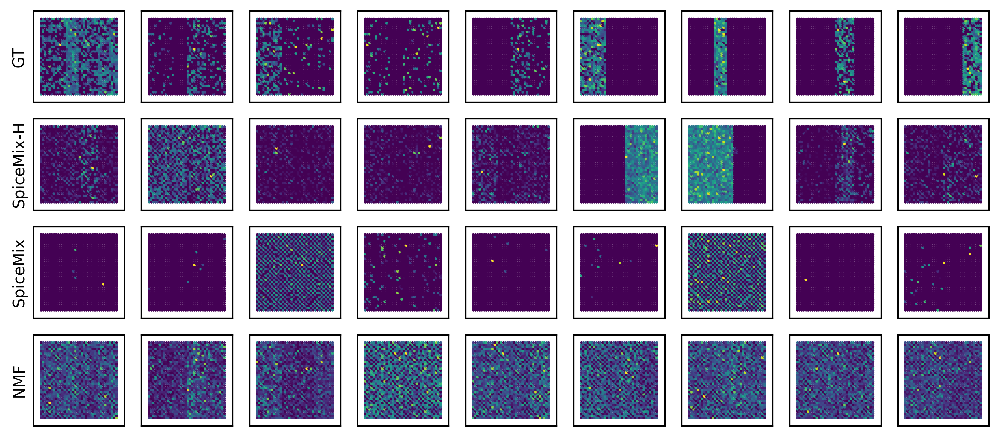

In [37]:
total_metagenes = 9
fov = 0
size= 1

fig, axes = plt.subplots(4, total_metagenes, sharex=True, sharey=True, tight_layout=True, dpi=300, figsize=(total_metagenes, 4))
_plot_all_embeddings(hierarchical_spicemix.hierarchy[0].datasets[fov], size=size, embedding_key="ground_truth_X", colorbar=False, fig=fig, ax=axes[0, :].flat, edgecolors='none')
_plot_all_embeddings(hierarchical_spicemix.hierarchy[0].datasets[fov], size=size, colorbar=False, fig=fig, ax=axes[1, :K].flat, edgecolors='none')
_plot_all_embeddings(spicemix.datasets[fov], size=size, colorbar=False, fig=fig, ax=axes[2, :K].flat, edgecolors='none')

_plot_all_embeddings(nmf.datasets[fov], size=size, colorbar=False, fig=fig, ax=axes[3, :K].flat, edgecolors='none')
for ax in axes.flat:
    ax.set_ylabel("")
    ax.set_xlabel("")
    ax.set_title("")
    
axes[0, 0].set_ylabel("GT")
axes[1, 0].set_ylabel("SpiceMix-H")
axes[2, 0].set_ylabel("SpiceMix")
axes[3, 0].set_ylabel("NMF")

In [38]:
from scipy.spatial.distance import pdist, cdist
from scipy.stats import pearsonr, spearmanr, wasserstein_distance

In [39]:
from typing import Sequence
def _compute_empirical_correlations(datasets: Sequence[PopariDataset], scaling: float, feature: str = "X", output: str = "empirical_correlation"):
    """Compute the empirical spatial correlation for a feature set across all datasets.         
                                                                                                
    Args:                                                                                       
        trained_model: the trained Popari model.                                                
        feature: key in `.obsm` of feature set for which spatial correlation should be computed.
        output: key in `.uns` where output correlation matrices should be stored.               
    """                                                                                         
                                                                                                
    num_replicates = len(datasets)                                                              
                                                                                                
    first_dataset = datasets[0]                                                                 
    _, K = first_dataset.obsm[feature].shape                                                    
    empirical_correlations = np.zeros([num_replicates, K, K])                                   
    for replicate, dataset in enumerate(datasets):                                              
        adjacency_list = dataset.obs["adjacency_list"]                                          
        X = dataset.obsm[feature]                                                               
        Z = X / np.linalg.norm(X, axis=1, keepdims=True, ord=1)                                 
        edges = np.array([(i, j) for i, e in enumerate(adjacency_list) for j in e])             
                                                                                                
        x = Z[edges[:, 0]]                                                                      
        y = Z[edges[:, 1]]                                                                      
        x = x - x.mean(axis=0, keepdims=True)                                                   
        y = y - y.mean(axis=0, keepdims=True)                                                   
        y_std = y.std(axis=0, keepdims=True)                                                    
        x_std = x.std(axis=0, keepdims=True)                                                    
        corr = (y / y_std).T @ (x / x_std) / len(x)                                             
        empirical_correlations[replicate] = - corr
        
    empirical_correlations = np.nan_to_num(empirical_correlations)
                                                                                                
    # Symmetrizing and zero-centering empirical_correlation                                                                                                                                                                                                                     
    empirical_correlations = (empirical_correlations + np.transpose(empirical_correlations, (0, 2, 1))) / 2
    empirical_correlations -= empirical_correlations.mean(axis=(1, 2), keepdims=True)           
    empirical_correlations *= scaling                                                           
                                                                                                
    for dataset, empirical_correlation in zip(datasets, empirical_correlations):                
        all_correlations = {dataset.name: empirical_correlation}                                
        dataset.uns[output] = all_correlations                                                  
                                                                                                
    return datasets   

In [40]:
from scipy.optimize import linear_sum_assignment

def _compute_affinity_correlation(dataset: PopariDataset,
                                  embedding_truth_key = "ground_truth_X",
                                  metagene_truth_key = "ground_truth_M",
                                  embedding_key = "X",
                                  metagene_key = "M",
                                  spatial_affinity_key = "Sigma_x_inv",
                                  correlation_truth_key = "ground_truth_correlation",
                                  real_metagene_index=None):
    
    """Compute Pearson correlation of spatial affinities with ground truth spatial correlation.
    
    """
    
    Sigma_x_inv = dataset.uns[spatial_affinity_key][dataset.name]
    empirical_correlation = dataset.uns[correlation_truth_key][dataset.name][real_metagene_index][:, real_metagene_index]
    
    K_dataset = len(real_metagene_index)
    
    # embedding_pearson_correlations = cdist(dataset.obsm[embedding_truth_key].T, dataset.obsm[embedding_key].T, metric=lambda x,y: abs(pearsonr(x,y)[0]))
    # embedding_pearson_argmaxes = embedding_pearson_correlations[real_metagene_index].argmax(axis=1)

    embedding_spatial_wasserstein = dataset.uns["embedding_spatial_wasserstein"][real_metagene_index]

    embedding_spatial_wasserstein_argmins = embedding_spatial_wasserstein.argmin(axis=1)
    # embedding_pearson_argmaxes = embedding_pearson_correlations[real_metagene_index].argmax(axis=1)
    
    _, matched_indices = linear_sum_assignment(embedding_spatial_wasserstein)

    permuted_Sigma_x_inv = Sigma_x_inv[matched_indices, :][:, matched_indices]
    
    #pearson = pearsonr(empirical_correlation.flatten(), permuted_Sigma_x_inv.flatten())[0]
    pearson = spearmanr(empirical_correlation.flatten(), permuted_Sigma_x_inv.flatten())[0]
    dataset.uns["affinity_correlation"] = np.nan_to_num(pearson)

    dataset.uns["permuted_Sigma_x_inv"] = {
        dataset.name: permuted_Sigma_x_inv
    }

    dataset.uns["matched_indices"] = matched_indices
    dataset.obsm["truncated_ground_truth_X"] = dataset.obsm[embedding_truth_key][:, real_metagene_index]
    dataset.obsm["truncated_matched_X"] = dataset.obsm[embedding_key][:, matched_indices]
    fig, axes = plt.subplots(len(matched_indices), 2, figsize=(4, len(matched_indices)))
    _plot_all_embeddings(dataset, embedding_key="truncated_ground_truth_X", size=2250/len(dataset), fig=fig, ax=axes[:, 0])
    _plot_all_embeddings(dataset, embedding_key="truncated_matched_X", size=2250/len(dataset), fig=fig, ax=axes[:, 1])
    plt.show()
    
def _compute_affinity_coherence(dataset: PopariDataset,
                                spatial_affinity_key = "Sigma_x_inv",
                                empirical_correlation_key = "empirical_correlation",
                                ):
    """Compute Pearson correlation of spatial affinities with in-situ spatial correlation.
    
    """
    empirical_correlation = dataset.uns[empirical_correlation_key][dataset.name]
    
    empirical_correlation = empirical_correlation.copy()
    empirical_correlation /= np.abs(empirical_correlation).max()
    Sigma_x_inv = dataset.uns[spatial_affinity_key][dataset.name].copy()
    Sigma_x_inv /= np.abs(Sigma_x_inv).max()
    
    pearson = pearsonr(empirical_correlation.flatten(), Sigma_x_inv.flatten())[0]
    
    dataset.uns["affinity_coherence"] = pearson

In [41]:
import numpy as np
import networkx as nx
from scipy.spatial.distance import pdist, squareform

from ortools.graph.python import min_cost_flow

    
def spatial_wasserstein(spatial_coordinates: np.ndarray,
                        embeddings_truth: np.ndarray,
                        embeddings_pred: np.ndarray,
                        weight_scaling_factor=int(1e4),
                        demand_scaling_factor=int(1e4)):
    """Use max flow/min cut formulation to determine spatial Wasserstein distance.
    
    """
    

    assert len(spatial_coordinates) == len(embeddings_truth) == len(embeddings_pred)
    assert spatial_coordinates.ndim == 2
    assert embeddings_truth.ndim == embeddings_truth.ndim == 1
    assert embeddings_truth.min() >= 0
    assert embeddings_pred.min() >= 0
    
    if embeddings_truth.sum() == 0:
        return np.inf

#     print("Setting up graph")
    # the pairwise distances, a.k.a., weights are linearly scaled so that the minimum weight is equal to weight_scaling_factor
    pairwise_dist = squareform(pdist(spatial_coordinates))
    np.fill_diagonal(pairwise_dist, np.inf)
    pairwise_dist_min = pairwise_dist.min()
    pairwise_dist = (pairwise_dist / pairwise_dist.min() * weight_scaling_factor).astype(int)
    weight_scaling_factor_full = weight_scaling_factor / pairwise_dist_min

    # # the demands are linearly scaled so that the maximum weight is equal to demand_scaling_factor
    embeddings_truth = embeddings_truth / embeddings_truth.sum()
    embeddings_pred = embeddings_pred / embeddings_pred.sum()
    demands = embeddings_pred - embeddings_truth
    demands_max = np.abs(demands).max()
    if demands_max == 0:
        return 0
    demands = (demands / demands_max * demand_scaling_factor).astype(int)
    demand_scaling_factor_full = demand_scaling_factor / demands_max
    
    # 
    idx = np.argmax(np.abs(demands))
    demands[idx] -= demands.sum()

    smcf = min_cost_flow.SimpleMinCostFlow()

    edges = []

    start_nodes = []
    end_nodes = []
    capacities = []
    unit_costs = []
    for cell_idx_i, pairwise_dist_row in enumerate(pairwise_dist):
        for cell_idx_j, dist in enumerate(pairwise_dist_row):
            if cell_idx_i != cell_idx_j and demands[cell_idx_i] < 0 and demands[cell_idx_j] > 0:
                edge = (cell_idx_i, cell_idx_j, {'capacity': demand_scaling_factor, 'weight': dist})
                edges.append(edge)
                start_nodes.append(cell_idx_i)
                end_nodes.append(cell_idx_j)
                capacities.append(demand_scaling_factor)
                unit_costs.append(dist)

    all_arcs = smcf.add_arcs_with_capacity_and_unit_cost(
        start_nodes, end_nodes, capacities, unit_costs
    )

    smcf.set_nodes_supplies(np.arange(0, len(demands)), -demands)

    status = smcf.solve()

    if status != smcf.OPTIMAL:
        print("There was an issue with the min cost flow input.")
        print(f"Status: {status}")
        exit(1)
    # print(f"Minimum cost: {smcf.optimal_cost()}")

    return smcf.optimal_cost() / demand_scaling_factor_full / weight_scaling_factor_full

In [42]:
from sklearn.metrics import pairwise_distances
from multiprocess import Pool

def all_pairs_spatial_wasserstein(dataset,
                        spatial_key: str = 'spatial',
                        embeddings_truth_key: str = 'ground_truth_X',
                        embeddings_pred_key: str = 'X',
                        weight_scaling_factor=int(1e4),
                        demand_scaling_factor=int(1e4)):
    
    spatial_coordinates = dataset.obsm[spatial_key]
    embeddings_truth = dataset.obsm[embeddings_truth_key]
    embeddings_pred = dataset.obsm[embeddings_pred_key]
    
    metric = lambda pair: spatial_wasserstein(spatial_coordinates, *pair)
    
    num_truth = embeddings_truth.shape[1]
    num_pred = embeddings_pred.shape[1]
            
    pairs = [[(truth, pred) for pred in embeddings_pred.T] for truth in embeddings_truth.T]
    pairs = np.array(pairs).reshape(-1, 2, len(spatial_coordinates))
    # print(pairs.shape)
    # pairs.reshape(-1, len(spatial_coordinates))
    # print(pairs.shape)
    
    # truth_args, pred_args = zip(*pairs)
#     with ThreadPoolExecutor(max_workers=16) as executor: 
#         results = executor.map(metric, truth_args, pred_args)
    with Pool(processes=16) as pool:
        results = pool.map(metric, pairs)
        
    distances = np.array(list(results)).reshape((num_truth, num_pred))
        
    return distances

In [43]:
from typing import Optional, Sequence
from scipy.spatial.distance import pdist, cdist
from scipy.stats import pearsonr, wilcoxon, wasserstein_distance

In [44]:
def _evaluate_ground_truth(dataset, real_metagene_index: Optional[Sequence[int]] = None,
                           embedding_truth_key: str = "ground_truth_X",
                           metagene_truth_key: str = "ground_truth_M"
                          ):
    """Evaluate learned metagenes/embeddings.
    
    """
   
    
    if real_metagene_index is None:
        real_metagene_index = slice(None)
    
    coordinates = dataset.obsm["spatial"]
    
    embedding_pearson_correlations = cdist(dataset.obsm[embedding_truth_key].T, dataset.obsm["X"].T, metric=lambda x,y: abs(pearsonr(x,y)[0]))
    dataset.uns["embedding_pearson_correlations"] = embedding_pearson_correlations
    
    metagene_pearson_correlations = cdist(dataset.uns[metagene_truth_key][dataset.name].T, dataset.uns["M"][dataset.name].T, metric=lambda x,y: abs(pearsonr(x,y)[0]))
    dataset.uns["metagene_pearson_correlations"] = metagene_pearson_correlations

    embedding_wasserstein = cdist(dataset.obsm[embedding_truth_key].T, dataset.obsm["X"].T, metric=lambda x,y: wasserstein_distance(x/x.sum(), y/y.sum()))
    
#     embedding_spatial_wasserstein = cdist(dataset.obsm[embedding_truth_key].T, dataset.obsm["X"].T, metric=lambda x,y: spatial_wasserstein(coordinates, x, y))
    embedding_spatial_wasserstein = all_pairs_spatial_wasserstein(dataset)    

#     assert np.all(dataset.obsm[embedding_truth_key].T.sum(axis=1) > 0), np.where(dataset.obsm[embedding_truth_key].T.sum(axis=1) ==0)
#     assert np.all(dataset.obsm["X"].T.sum(axis=1) > 0), np.where(dataset.obsm["M"].T.sum(axis=1) == 0)
    
    dataset.uns["embedding_wasserstein"] = embedding_wasserstein
    dataset.uns["embedding_spatial_wasserstein"] = embedding_spatial_wasserstein
    

    metagene_wasserstein = cdist(dataset.uns[metagene_truth_key][dataset.name].T, dataset.uns["M"][dataset.name].T, metric=lambda x,y: wasserstein_distance(x/x.sum(), y/y.sum()))
    dataset.uns["metagene_wasserstein"] = metagene_wasserstein
            
    metagene_pearson_minmax = metagene_pearson_correlations.max(axis=1)[real_metagene_index].min()
    dataset.uns["metagene_pearson_minmax"] = metagene_pearson_minmax

    embedding_pearson_minmax = np.nanmax(embedding_pearson_correlations[real_metagene_index], axis=1).min()
    dataset.uns["embedding_pearson_minmax"] = metagene_pearson_minmax

    metagene_wasserstein_maxmin = metagene_wasserstein.min(axis=1)[real_metagene_index].max()
    dataset.uns["metagene_wasserstein_maxmin"] = metagene_wasserstein_maxmin

    embedding_wasserstein_maxmin = np.nanmin(embedding_wasserstein[real_metagene_index], axis=1).max()
    assert not np.isnan(embedding_wasserstein_maxmin), np.where(dataset.obsm[embedding_truth_key].T.sum(axis=1) ==0)
    
    embedding_spatial_wasserstein_maxmin = np.nanmin(embedding_spatial_wasserstein[real_metagene_index], axis=1).max()
    
    embedding_spatial_wasserstein_avgmin = np.min(embedding_spatial_wasserstein[real_metagene_index], axis=1).max()
    
    
    dataset.uns["embedding_wasserstein_maxmin"] = embedding_wasserstein_maxmin
    dataset.uns["embedding_spatial_wasserstein_maxmin"] = embedding_spatial_wasserstein_maxmin
    dataset.uns["embedding_spatial_wasserstein_avgmin"] = embedding_spatial_wasserstein_avgmin

In [45]:
def _evaluate_model(model, metagene_indices, hierarchical_levels, is_spatial):
    """
    """

    if hierarchical_levels is not None and model.hierarchical_levels > 1:
        propagate_ground_truth(model)

        dataset_lists = [view.datasets for view in model.hierarchy.values()]
    else:
        dataset_lists = [model.datasets]
    
    for datasets in dataset_lists:
        print([dataset.name for dataset in datasets])
        if is_spatial:
            _compute_empirical_correlations(datasets, scaling=10) 
            _compute_empirical_correlations(datasets, feature="ground_truth_X", output="ground_truth_correlation", scaling=10)    
    
        for dataset, metagene_index in zip(datasets, metagene_indices):
            _evaluate_ground_truth(dataset, real_metagene_index=metagene_index)
            if is_spatial:
                _compute_affinity_coherence(dataset)
                _compute_affinity_correlation(dataset, real_metagene_index=metagene_index)

In [46]:
def propagate_ground_truth(model, embedding_truth_key = "ground_truth_X", metagene_truth_key = "ground_truth_M"):
    """Propagate ground truth embeddings and metagenes to lower levels of hierarchy.
    
    """
    for level in range(model.hierarchical_levels-1):
        view = model.hierarchy[level]

        for dataset, low_res_dataset in zip(view.datasets, view.low_res_view.datasets):
            low_res_dataset.obsm[embedding_truth_key] = low_res_dataset.obsm[f"bin_assignments_{dataset.name}_level_{level+1}"] @ dataset.obsm[embedding_truth_key]
            low_res_dataset.uns[metagene_truth_key] = {low_res_dataset.name: dataset.uns[metagene_truth_key][dataset.name].copy()}

In [47]:
from collections import defaultdict
class NestedDefaultDict(defaultdict):
    def __init__(self, type_constructor, levels=1):
        """Nested extension of defaultdict.
        
        Useful for storing structured data.
        """
        if levels == 1:
            super().__init__(type_constructor)
        elif levels > 1:
            super().__init__(lambda: NestedDefaultDict(type_constructor, levels=levels-1))
            
model_container = {
    "nmf": nmf,
    "spicemix": spicemix,
    "hierarchical_spicemix": hierarchical_spicemix,
}

In [48]:
evaluation = NestedDefaultDict(list, 5)

['layer']
nmf 0
['layer']
['layer']


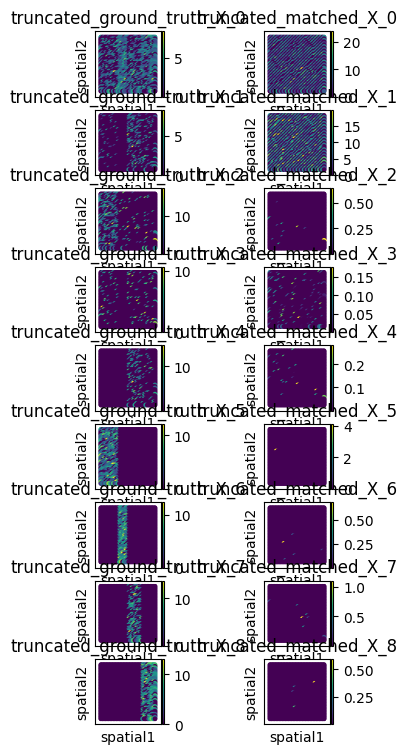

spicemix 0
['layer']
['layer']


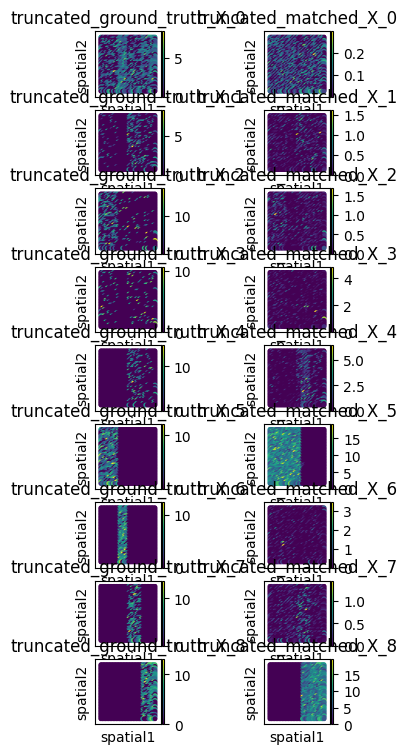

['layer_level_1']


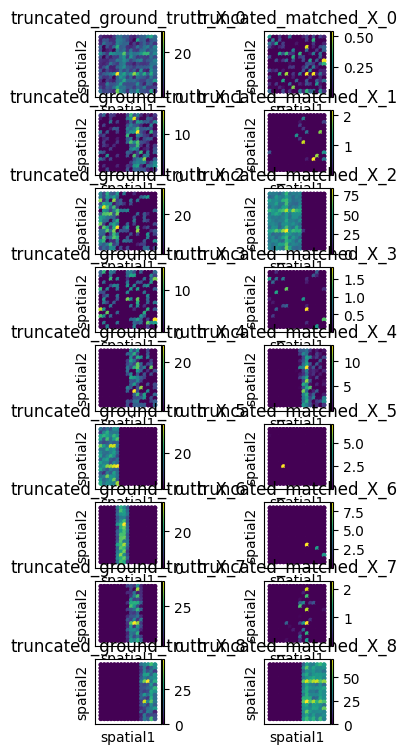

hierarchical_spicemix 0
['layer']
hierarchical_spicemix 1
['layer_level_1']


In [49]:
num_fovs = 1
metagene_indices = [np.arange(total_metagenes) for _ in range(num_fovs)]
random_state = 42
for model_name, model in model_container.items():
    is_spatial = (model_name != "nmf")
    _evaluate_model(model, metagene_indices, hierarchical_levels=model.hierarchical_levels, is_spatial=is_spatial)

    ari_level = 0
    dataset_lists = [(level, view.datasets) for (level, view) in model.hierarchy.items()]

    for level, datasets in dataset_lists:
        print(model_name, level)
        print([dataset.name for dataset in datasets])
        if level == ari_level:
            tl.preprocess_embeddings(model, level=level)
            tl.leiden(model, level=level, target_clusters=8, joint=True)
            tl.compute_ari_scores(model, level=level, labels="cell_type", predictions="leiden")

        average_metagene_pearson_minmax = average_embedding_pearson_minmax = \
            average_metagene_wasserstein_maxmin = average_embedding_wasserstein_maxmin = average_ari = 0

        metagene_pearson_minmaxes = [dataset.uns["metagene_pearson_minmax"] for dataset in datasets]

        embedding_pearson_minmaxes = [dataset.uns["embedding_pearson_minmax"] for dataset in datasets]
        metagene_wasserstein_maxmins = [dataset.uns["metagene_wasserstein_maxmin"] for dataset in datasets]
        embedding_wasserstein_maxmins = [dataset.uns["embedding_wasserstein_maxmin"] for dataset in datasets]
        
        embedding_spatial_wasserstein_maxmins = [dataset.uns["embedding_spatial_wasserstein_maxmin"] for dataset in datasets]
        embedding_spatial_wasserstein_avgmins = [dataset.uns["embedding_spatial_wasserstein_avgmin"] for dataset in datasets]

        if level == ari_level:
            aris = [dataset.uns["ari"] for dataset in datasets]

# #                 average_metagene_pearson_minmax += metagene_pearson_minmax / 2
# #                 average_embedding_pearson_minmax += embedding_pearson_minmax / 2
# #                 average_metagene_wasserstein_maxmin += metagene_wasserstein_maxmin / 2
# #                 average_embedding_wasserstein_maxmin += embedding_wasserstein_maxmin / 2

#                 if level == ari_level:
#                     average_ari += dataset.uns["ari"] / 2

        evaluation[model_name]["scores"][level]["metagene_pearson_minmax"][random_state] = metagene_pearson_minmaxes
        evaluation[model_name]["scores"][level]["embedding_pearson_minmax"][random_state] = embedding_pearson_minmaxes
        evaluation[model_name]["scores"][level]["metagene_wasserstein_maxmin"][random_state] = metagene_wasserstein_maxmins
        evaluation[model_name]["scores"][level]["embedding_wasserstein_maxmin"][random_state] = embedding_wasserstein_maxmins
        evaluation[model_name]["scores"][level]["embedding_spatial_wasserstein_maxmin"][random_state] = embedding_spatial_wasserstein_maxmins
        evaluation[model_name]["scores"][level]["embedding_spatial_wasserstein_avgmin"][random_state] = embedding_spatial_wasserstein_avgmins
        if level == ari_level:
            evaluation[model_name]["scores"][level]["ari"][random_state] = aris

        if is_spatial:
            affinity_correlations = [dataset.uns["affinity_correlation"] for dataset in datasets]
            affinity_coherences = [dataset.uns["affinity_coherence"] for dataset in datasets]

            evaluation[model_name]["scores"][level]["affinity_correlation"][random_state] = affinity_correlations
            evaluation[model_name]["scores"][level]["affinity_coherence"][random_state] = affinity_coherences

In [110]:
# metric = 'embedding_wasserstein_maxmin'
# metric = 'ari'
metrics = ('embedding_spatial_wasserstein_maxmin', 'affinity_correlation', 'metagene_pearson_minmax')
# metric = 'embedding_spatial_wasserstein_avgmin'

for metric in metrics:
    print(metric)
    for model_name in model_container.keys():
        print(model_name)
        display(evaluation[model_name]["scores"][0][metric])
        score = np.mean(evaluation[model_name]["scores"][0][metric][42])
        print(score)

embedding_spatial_wasserstein_maxmin
nmf


NestedDefaultDict(list, {42: [0.24955538558139226]})

0.24955538558139226
spicemix


NestedDefaultDict(list, {42: [0.11463848885659433]})

0.11463848885659433
hierarchical_spicemix


NestedDefaultDict(list, {42: [0.11253657539372863]})

0.11253657539372863
affinity_correlation
nmf


NestedDefaultDict(list, {})

nan
spicemix


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


NestedDefaultDict(list, {42: [0.6423116894853372]})

0.6423116894853372
hierarchical_spicemix


NestedDefaultDict(list, {42: [0.7378112150377298]})

0.7378112150377298
metagene_pearson_minmax
nmf


NestedDefaultDict(list, {42: [0.5390906331538899]})

0.5390906331538899
spicemix


NestedDefaultDict(list, {42: [0.5087208331419066]})

0.5087208331419066
hierarchical_spicemix


NestedDefaultDict(list, {42: [0.4679918399874758]})

0.4679918399874758


Text(0, 0.5, 'SpiceMix')

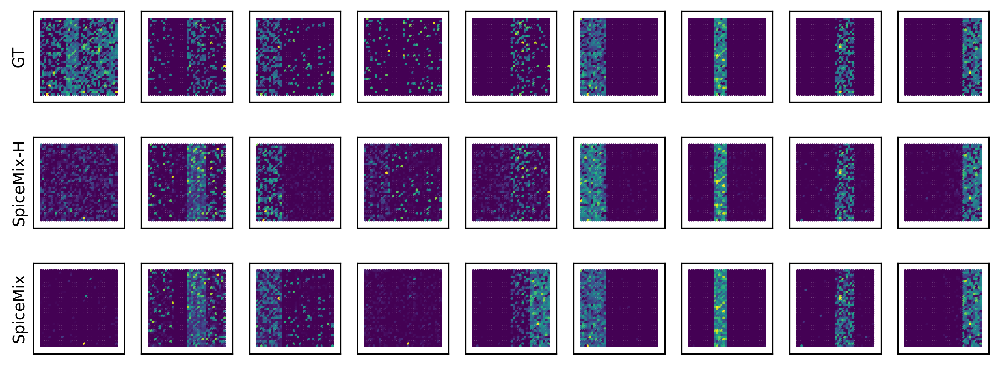

In [111]:
total_metagenes = 9
fov = 0
size= 1

fig, axes = plt.subplots(3, total_metagenes, sharex=True, sharey=True, tight_layout=True, dpi=300, figsize=(total_metagenes, 4))
_plot_all_embeddings(hierarchical_spicemix.hierarchy[0].datasets[fov], size=size, embedding_key="ground_truth_X", colorbar=False, fig=fig, ax=axes[0, :].flat, edgecolors='none')
_plot_all_embeddings(hierarchical_spicemix.hierarchy[0].datasets[fov], size=size, embedding_key="truncated_matched_X", colorbar=False, fig=fig, ax=axes[1, :K].flat, edgecolors='none')
_plot_all_embeddings(spicemix.datasets[fov], size=size, embedding_key="truncated_matched_X", colorbar=False, fig=fig, ax=axes[2, :K].flat, edgecolors='none')

for ax in axes.flat:
    ax.set_ylabel("")
    ax.set_xlabel("")
    ax.set_title("")
    
axes[0, 0].set_ylabel("GT")
axes[1, 0].set_ylabel("SpiceMix-H")
axes[2, 0].set_ylabel("SpiceMix")

Text(0, 0.5, 'SpiceMix-H')

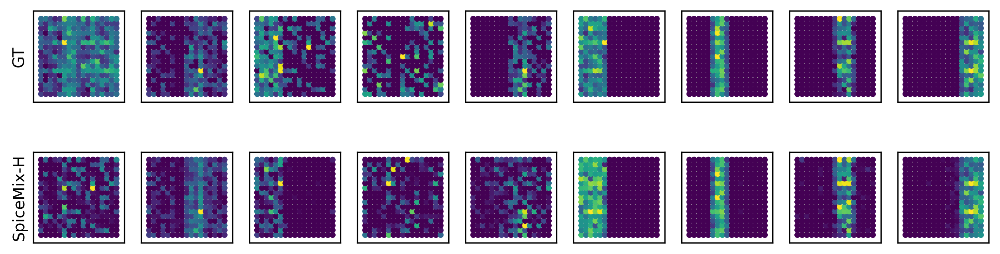

In [115]:
total_metagenes = 9
fov = 0
size= 20

fig, axes = plt.subplots(2, total_metagenes, sharex=True, sharey=True, tight_layout=True, dpi=300, figsize=(total_metagenes, 4))
_plot_all_embeddings(hierarchical_spicemix.hierarchy[1].datasets[fov], size=size, embedding_key="ground_truth_X", colorbar=False, fig=fig, ax=axes[0, :].flat, edgecolors='none')
_plot_all_embeddings(hierarchical_spicemix.hierarchy[1].datasets[fov], size=size, embedding_key="truncated_matched_X", colorbar=False, fig=fig, ax=axes[1, :K].flat, edgecolors='none')

for ax in axes.flat:
    ax.set_ylabel("")
    ax.set_xlabel("")
    ax.set_title("")
    
axes[0, 0].set_ylabel("GT")
axes[1, 0].set_ylabel("SpiceMix-H")

Text(0, 0.5, 'SpiceMix')

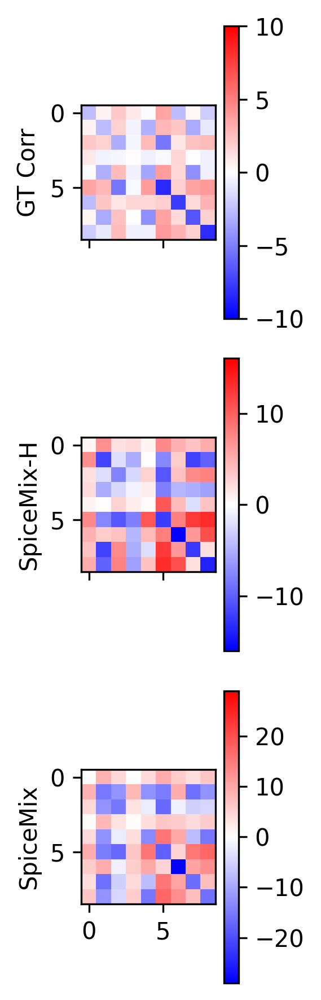

In [119]:
fig, axes = plt.subplots(3, squeeze=False, sharex=True, sharey=True, tight_layout=True, dpi=300, figsize=(num_fovs * 2, 6))
_ = _multireplicate_heatmap(hierarchical_spicemix.datasets, uns="ground_truth_correlation", cmap="bwr", vmin=-10, vmax=10, axes=axes[0])
axes[0, 0].set_ylabel("GT Corr")
pl.spatial_affinities(hierarchical_spicemix, spatial_affinity_key="permuted_Sigma_x_inv", axes=axes[1])
axes[1, 0].set_ylabel("SpiceMix-H")
pl.spatial_affinities(spicemix, spatial_affinity_key="permuted_Sigma_x_inv", axes=axes[2])
axes[2, 0].set_ylabel("SpiceMix")
# _ = _multireplicate_heatmap(disjoint_spicemix.datasets, uns="permuted_Sigma_x_inv", cmap="bwr", vmin=-10, vmax=10, axes=axes[3])
# axes[3, 0].set_ylabel("SpiceMix-D")

NameError: name 'popari' is not defined

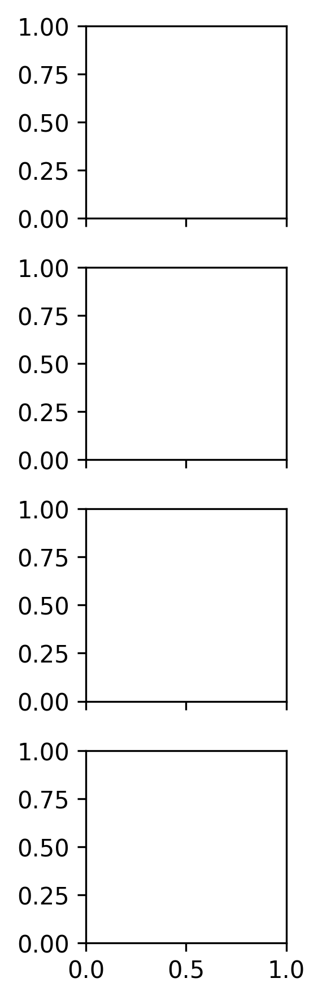

In [116]:
num_genes = 100
fig, axes = plt.subplots(4, num_fovs, sharex=True, sharey=True, squeeze=False, tight_layout=True, dpi=300, figsize=(num_fovs * 2, 6))
_ = _multireplicate_heatmap(popari.datasets, aspect=popari.K / num_genes, uns="ground_truth_M", cmap="magma", vmin=0, axes=axes[0])
axes[0, 0].set_ylabel("GT Corr")
_ = _multireplicate_heatmap(popari.datasets, aspect=popari.K / num_genes, uns="M", cmap="magma", vmin=0, axes=axes[1])
axes[1, 0].set_ylabel("Popari")
_ = _multireplicate_heatmap(spicemix.datasets, aspect=popari.K / num_genes, uns="M", cmap="magma", vmin=0, axes=axes[2])
axes[2, 0].set_ylabel("SpiceMix")
_ = _multireplicate_heatmap(disjoint_spicemix.datasets, aspect=popari.K / num_genes, uns="M", cmap="magma", vmin=0, axes=axes[3])
axes[3, 0].set_ylabel("SpiceMix-D")

### Generate random seeds

sigX_scale: 1.0	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 0	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


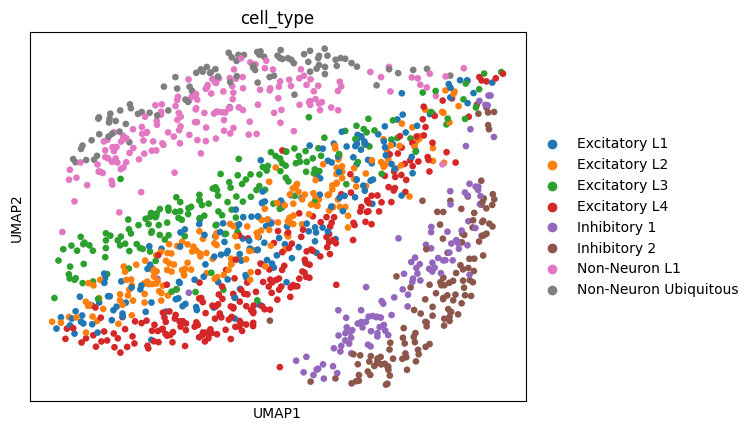

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


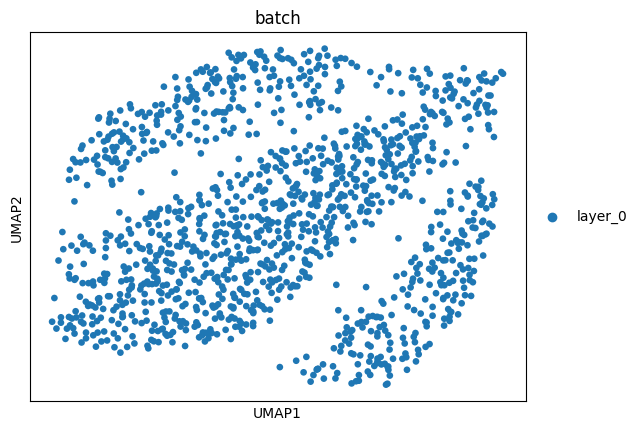

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_0/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 1	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


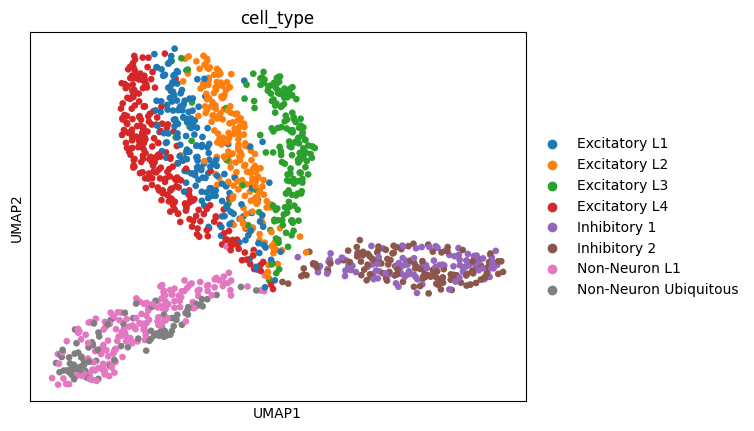

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


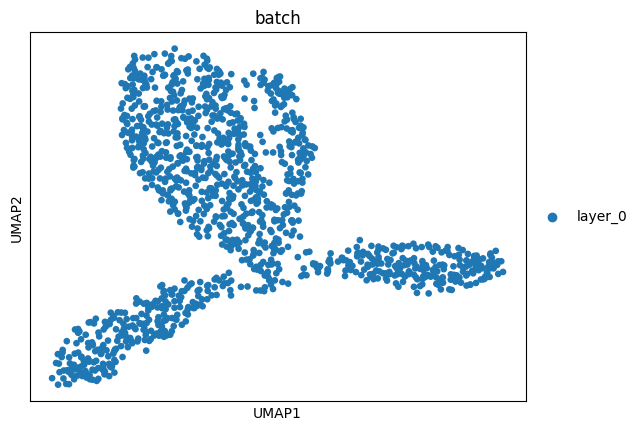

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_1/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 2	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


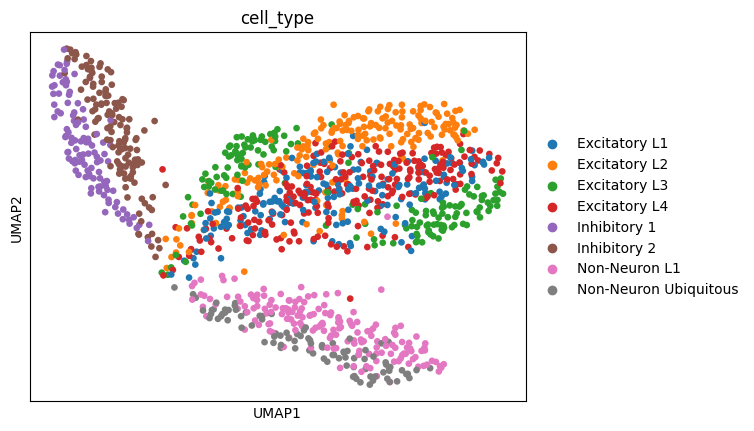

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


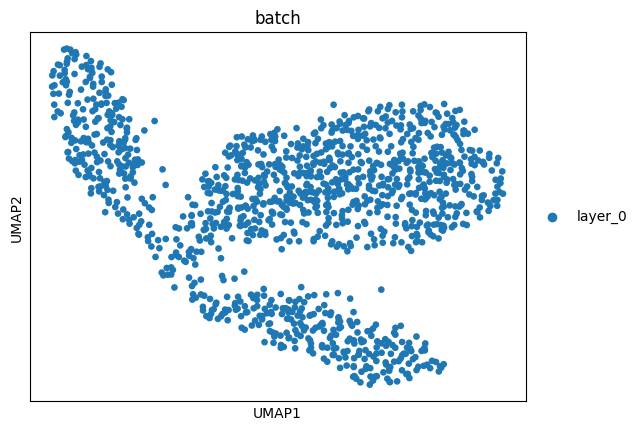

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_2/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 3	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


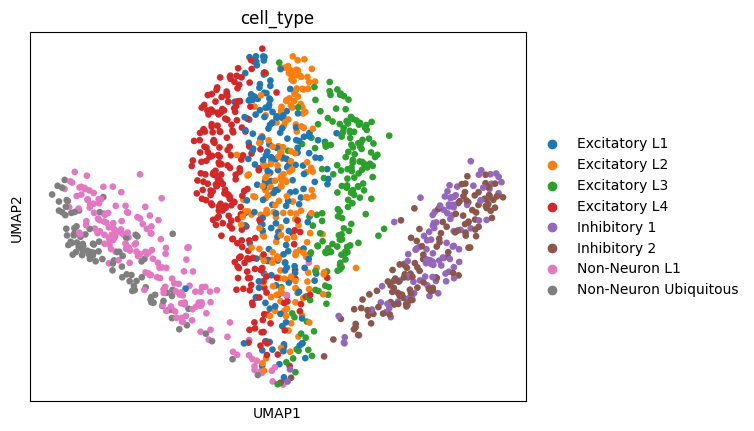

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


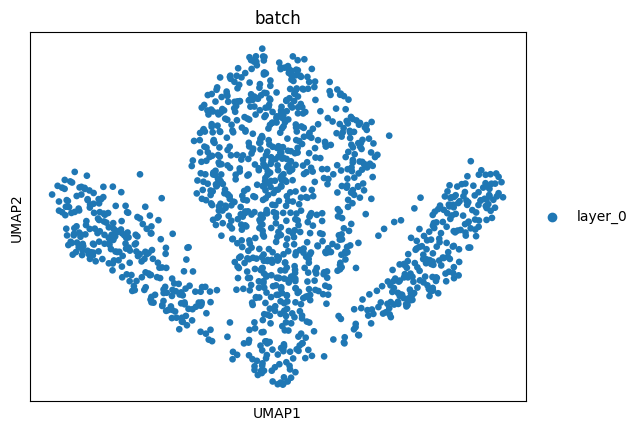

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_3/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 4	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


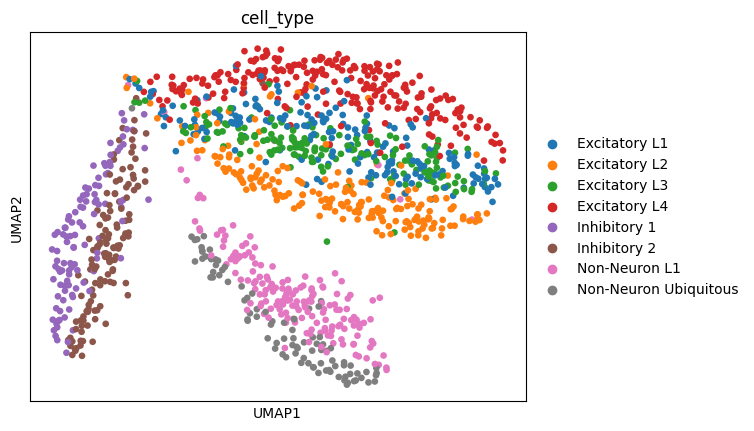

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


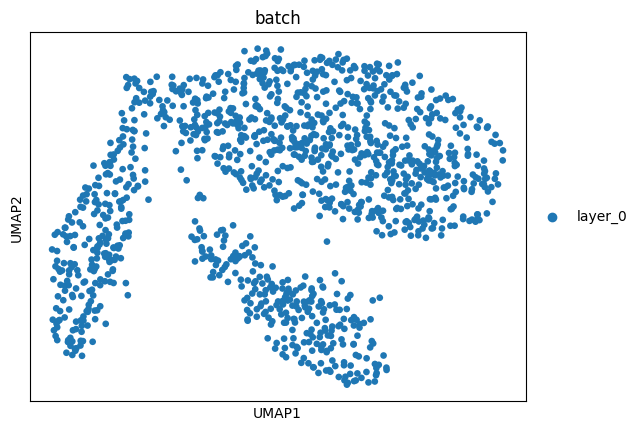

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_4/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 5	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


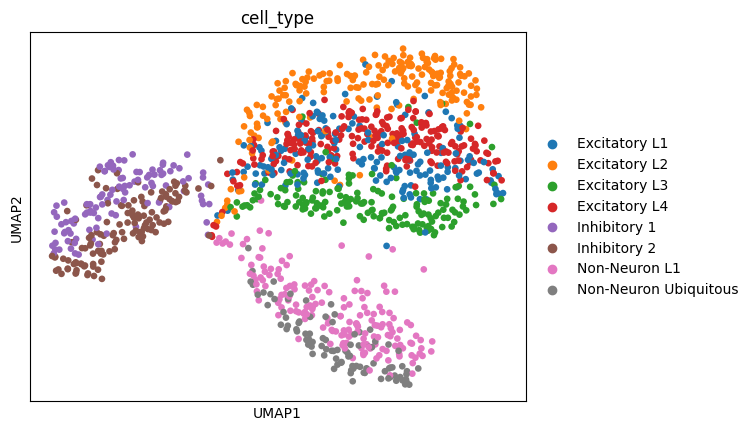

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


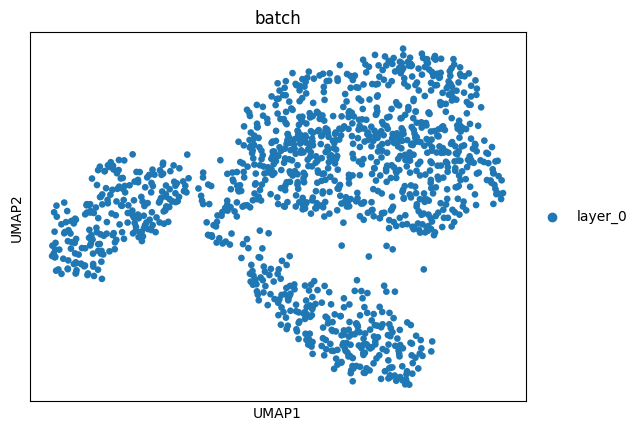

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_5/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 6	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


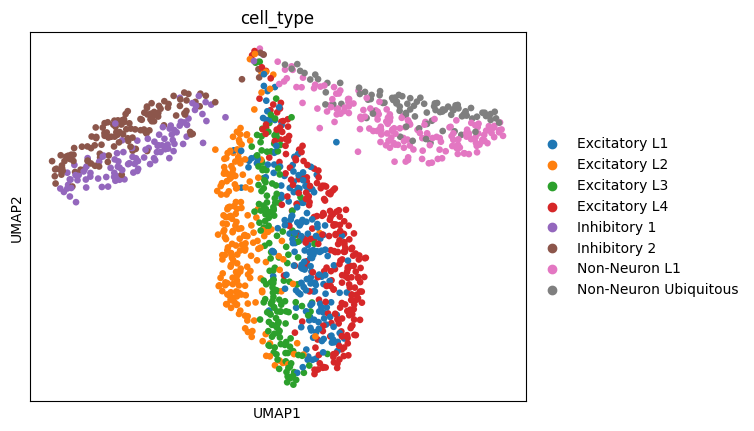

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


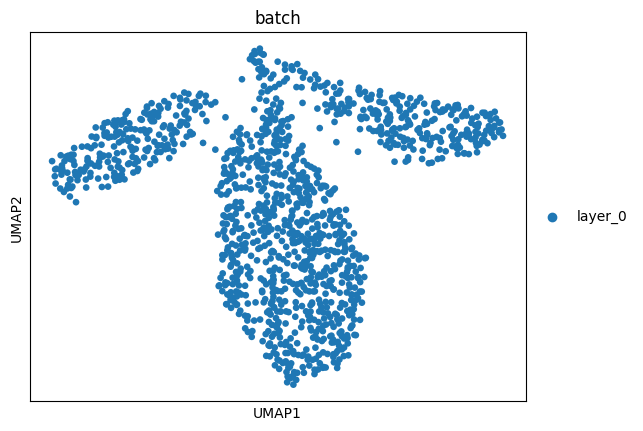

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_6/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 7	num_replicates: 1	
layer_0
Simulating layer-annotated expression...


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


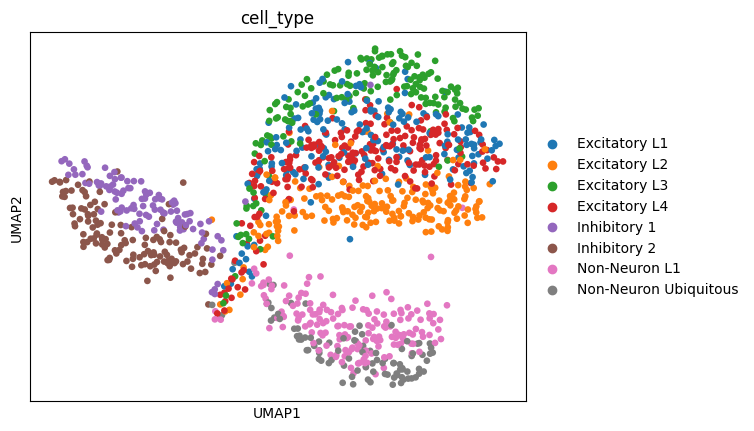

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


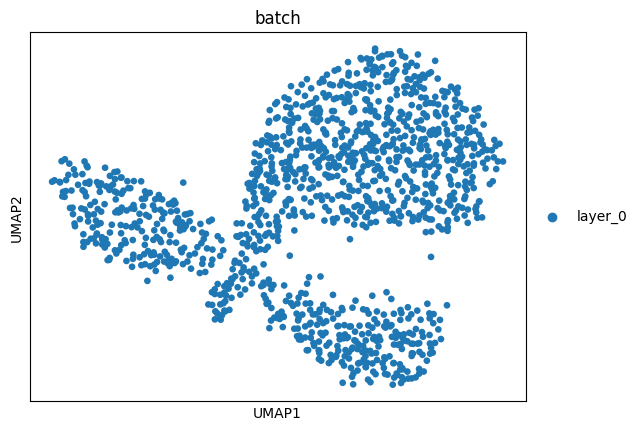

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_0/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 1	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


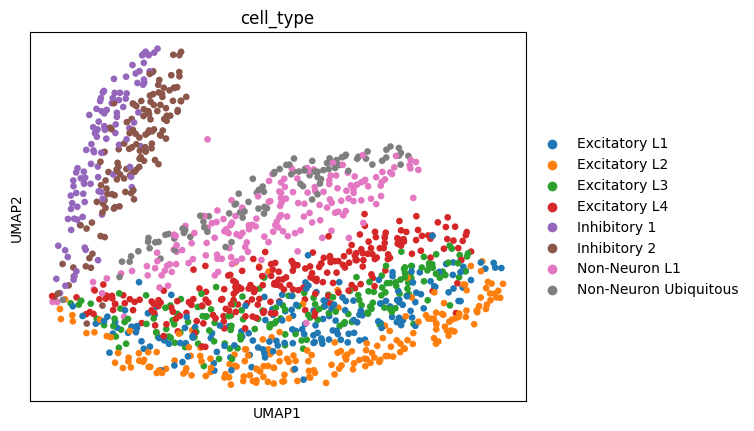

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


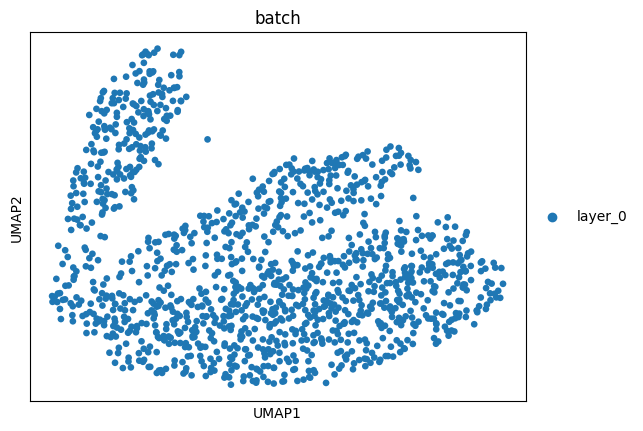

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_1/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 2	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


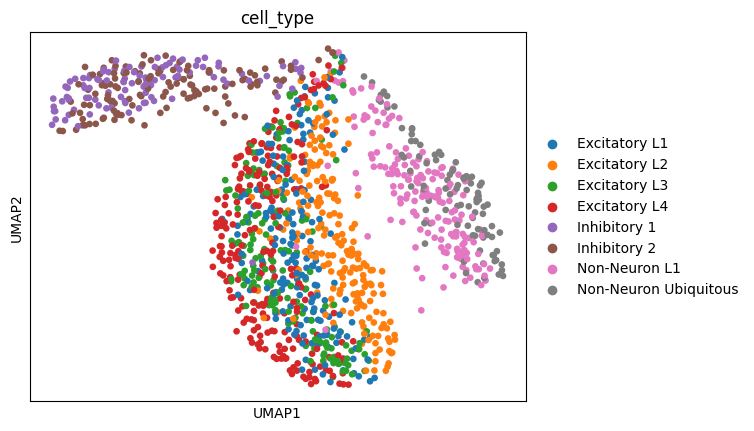

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


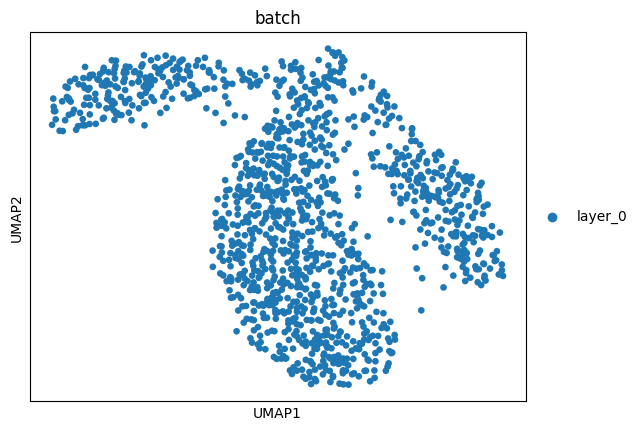

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_2/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 3	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


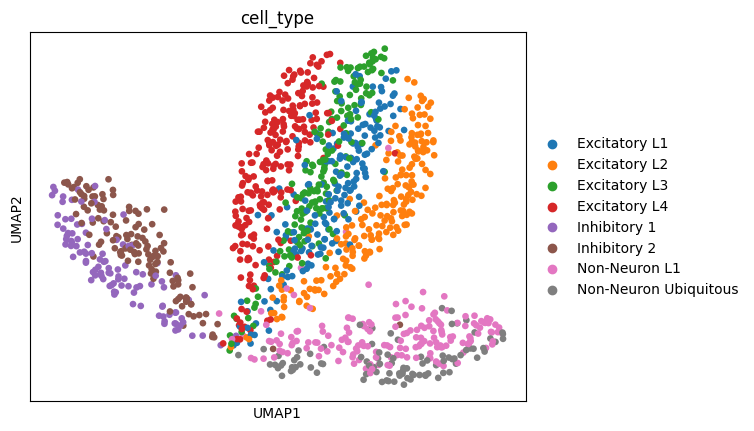

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


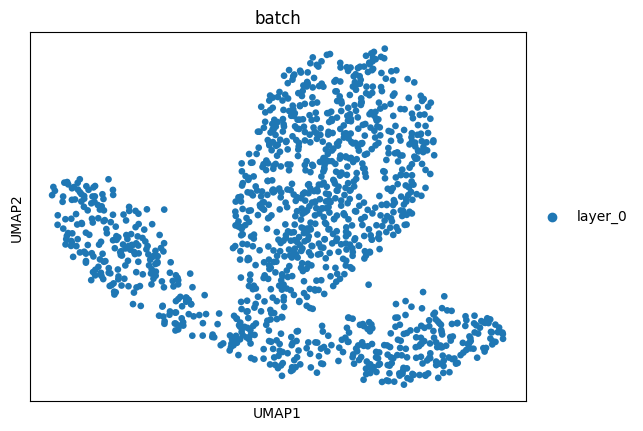

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_3/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 4	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


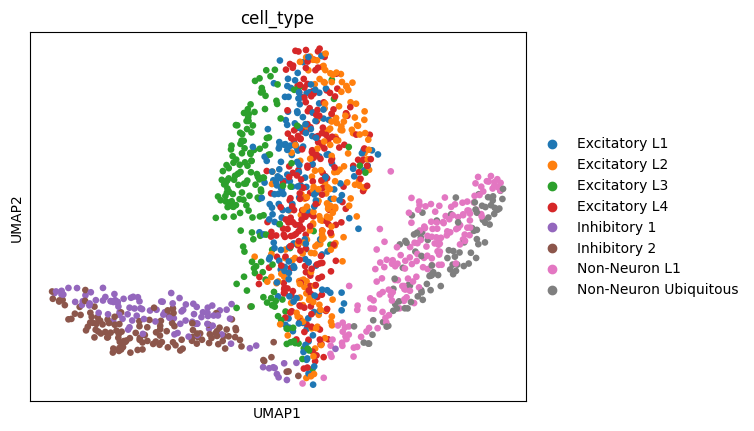

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


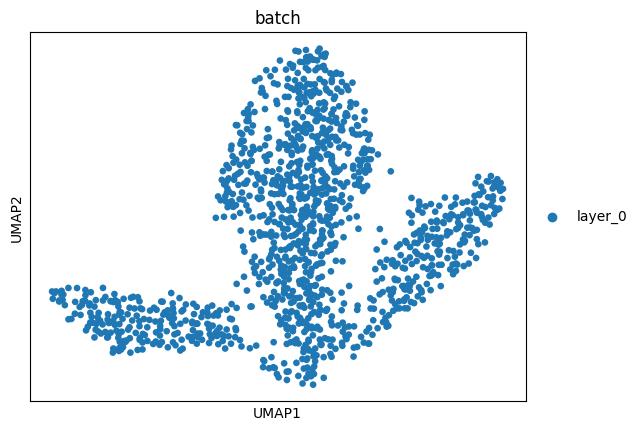

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_4/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 5	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


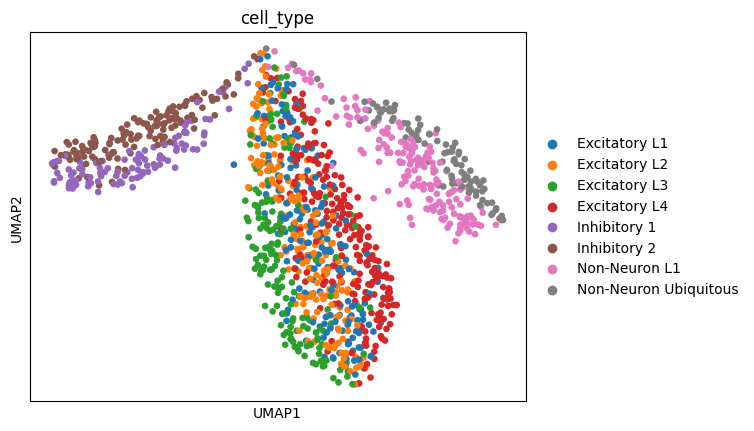

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


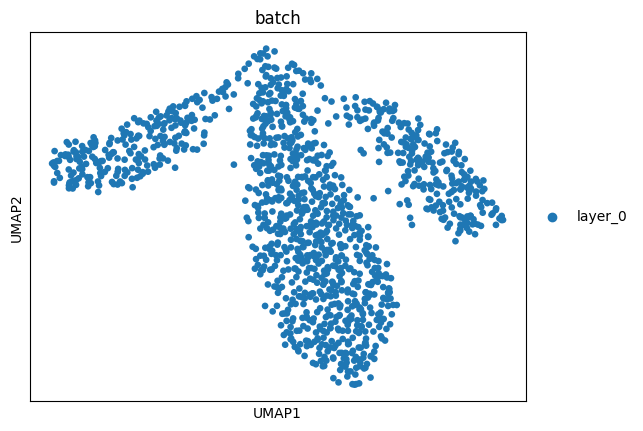

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_5/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 6	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


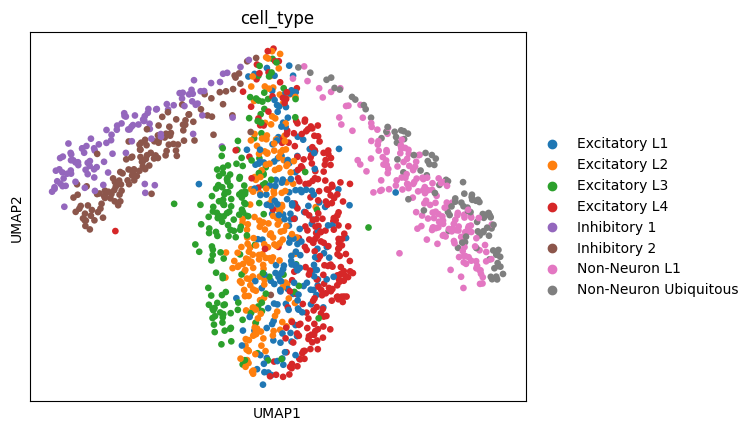

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


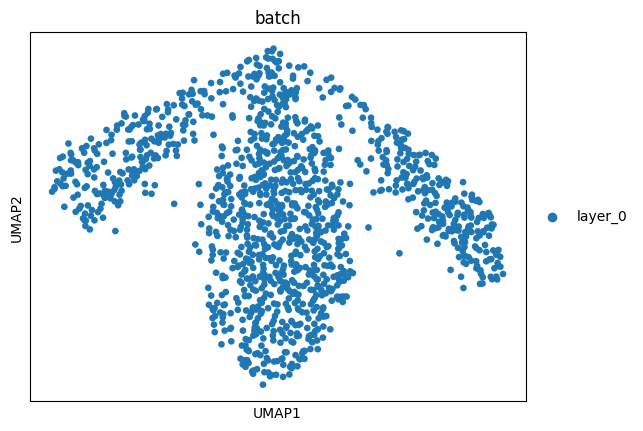

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_6/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 7	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


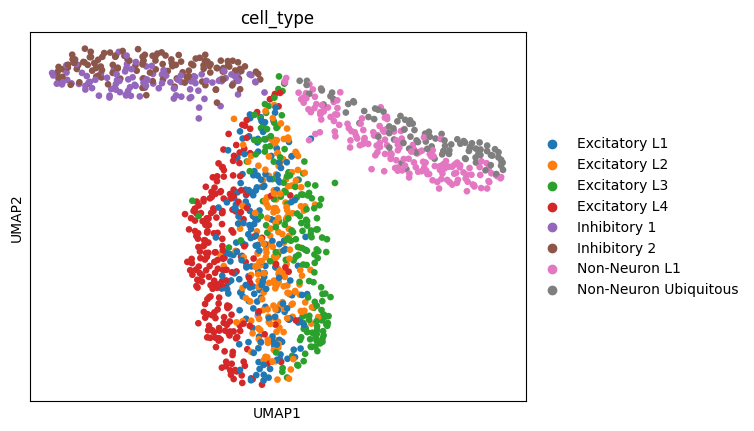

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


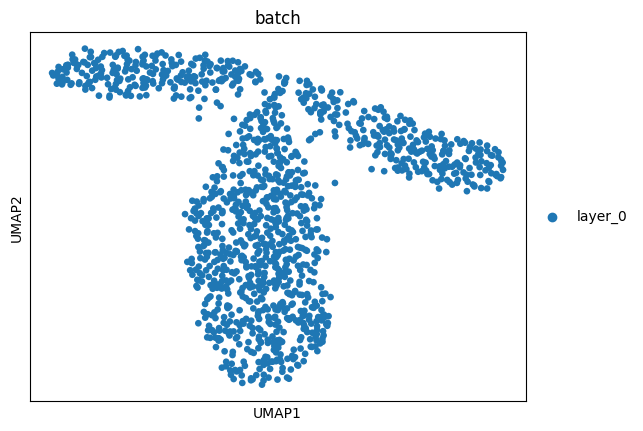

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_7/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 8	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


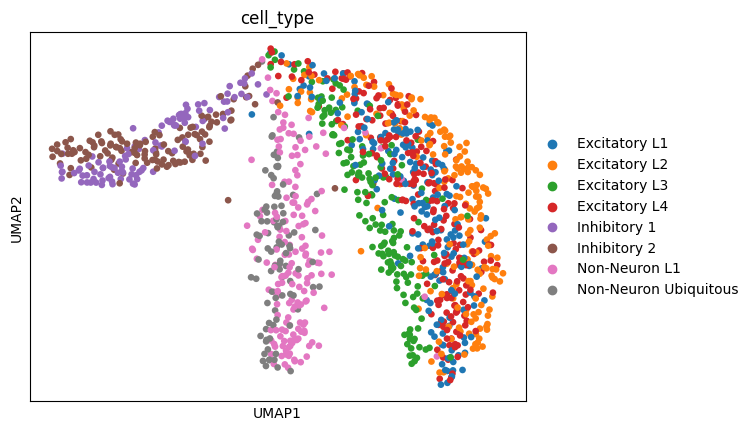

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


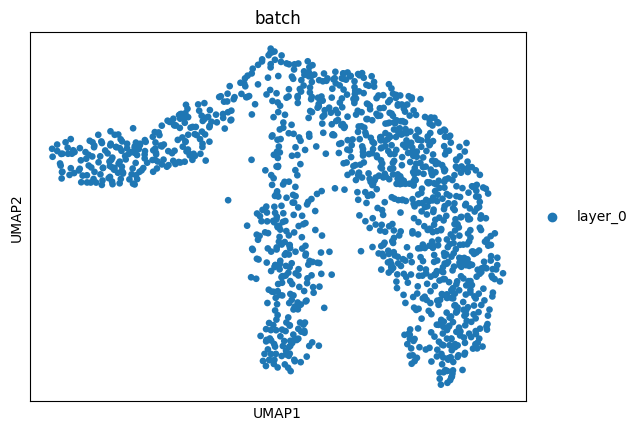

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_8/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 9	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


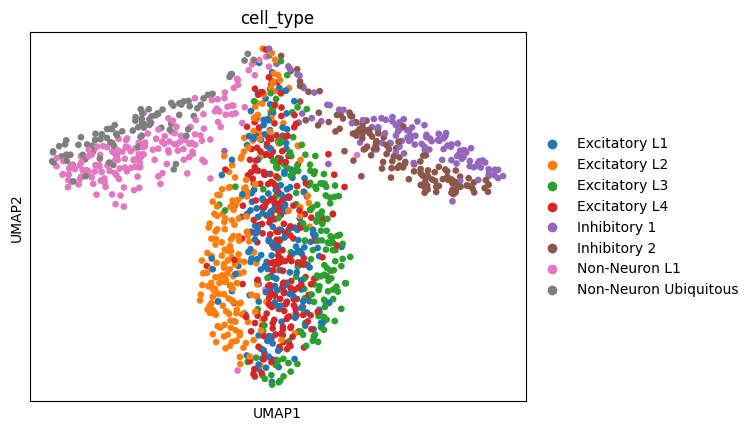

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


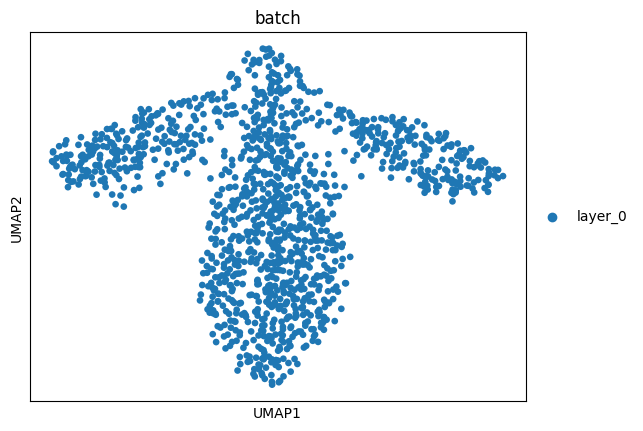

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_9/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 10	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


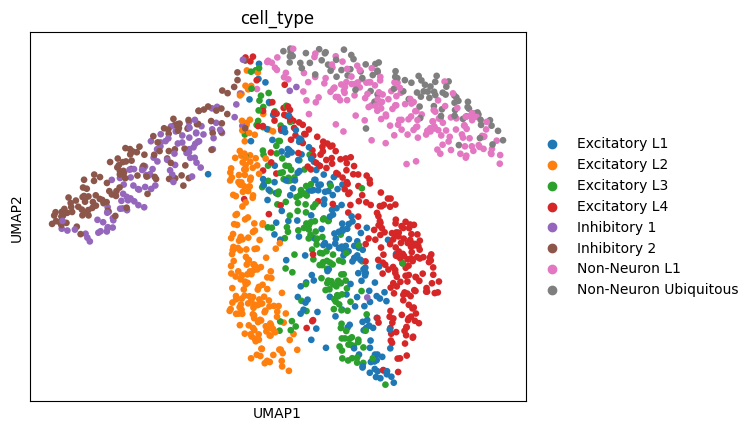

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


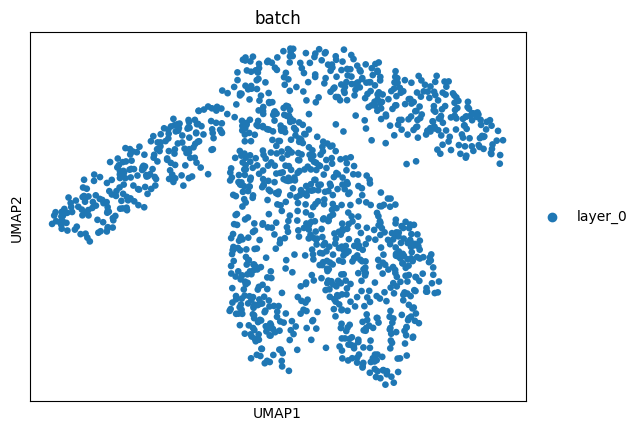

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_10/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 11	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


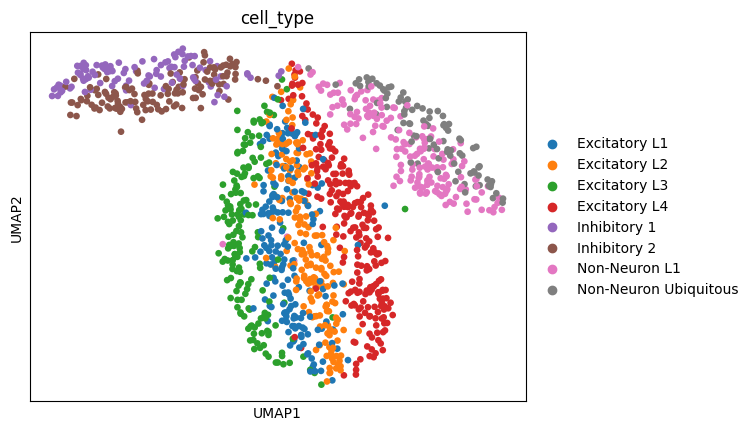

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


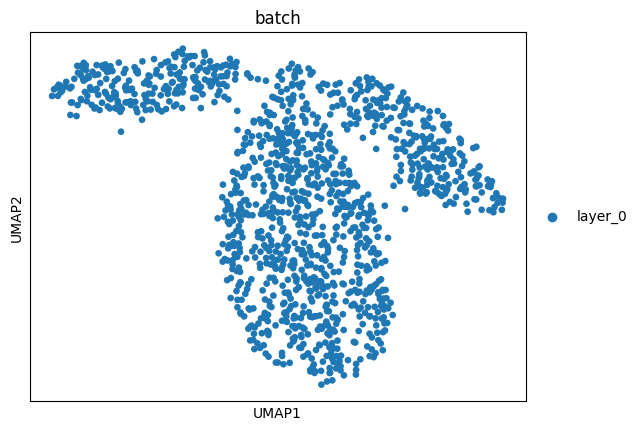

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_11/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 12	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


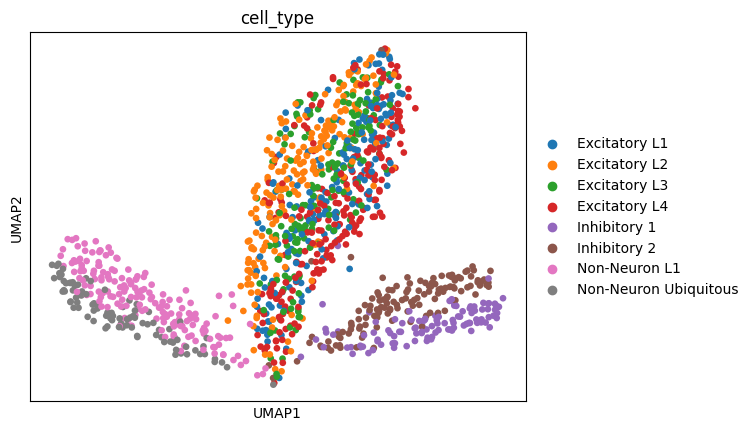

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


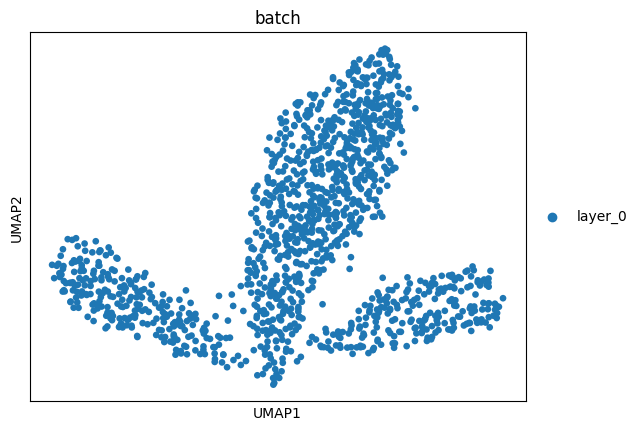

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_12/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 13	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


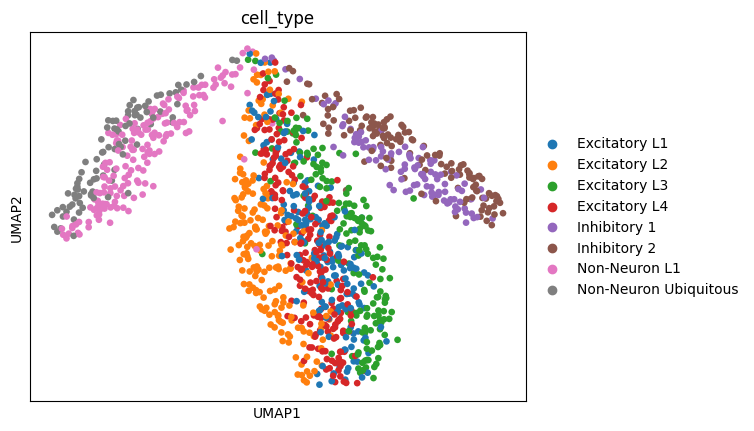

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


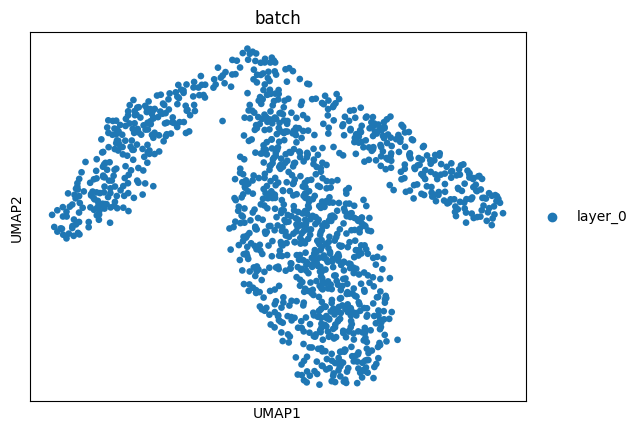

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_13/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 14	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


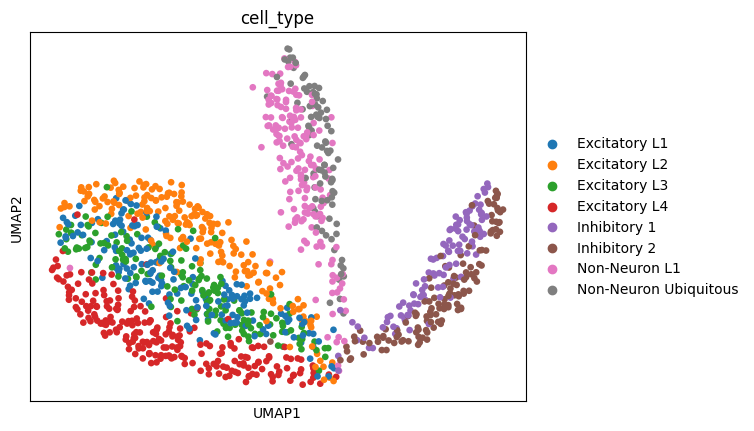

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


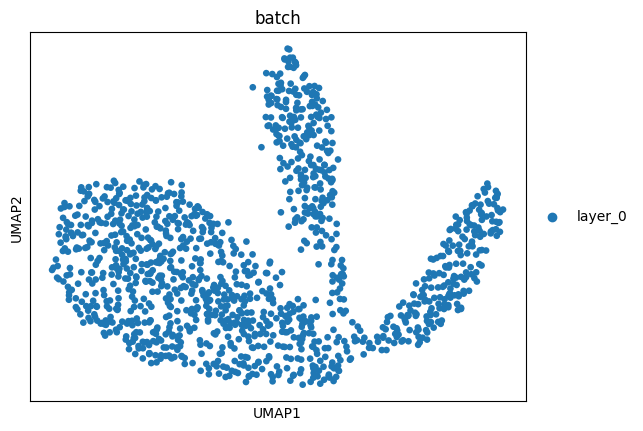

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_14/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 15	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


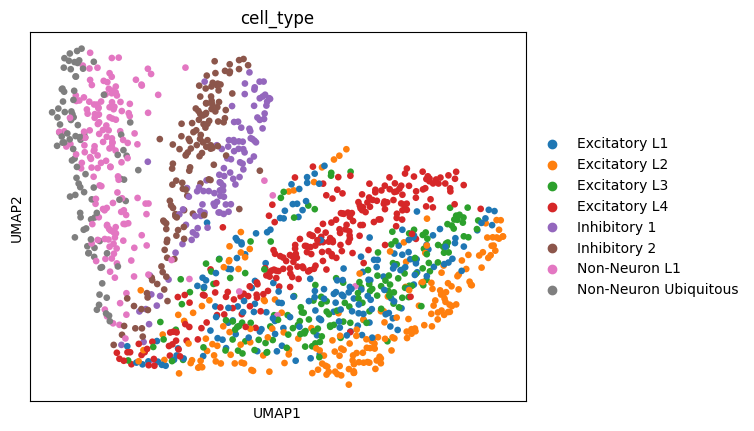

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


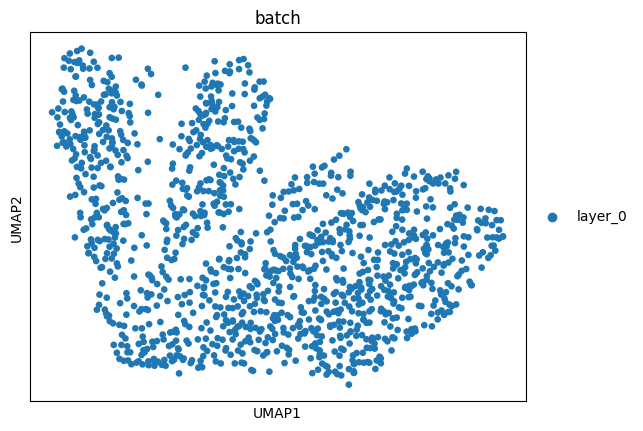

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_15/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 16	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


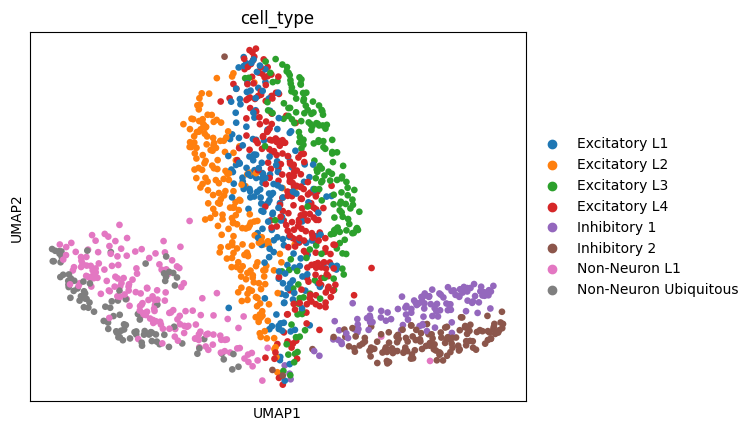

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


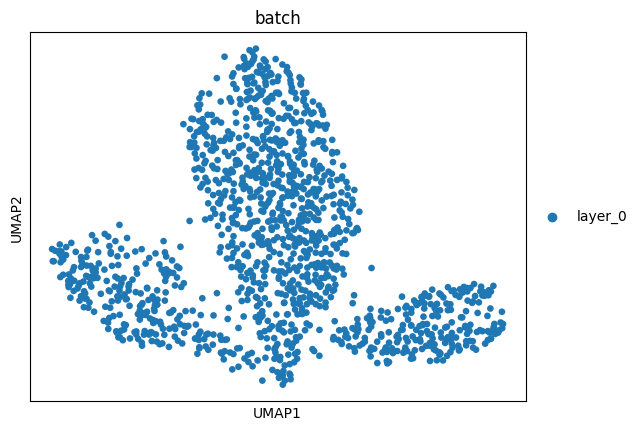

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_16/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 17	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


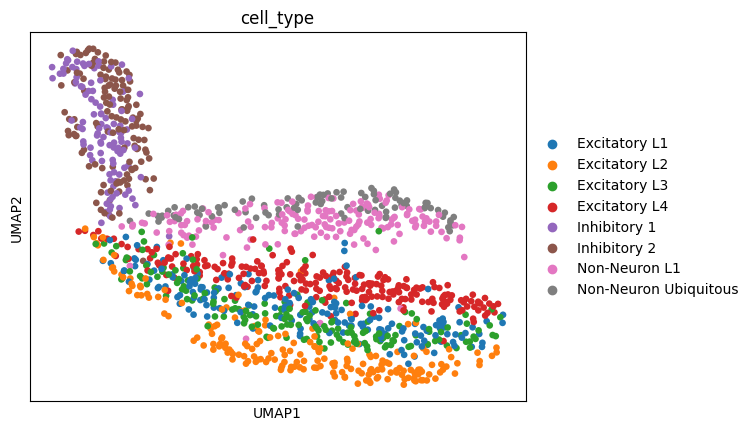

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


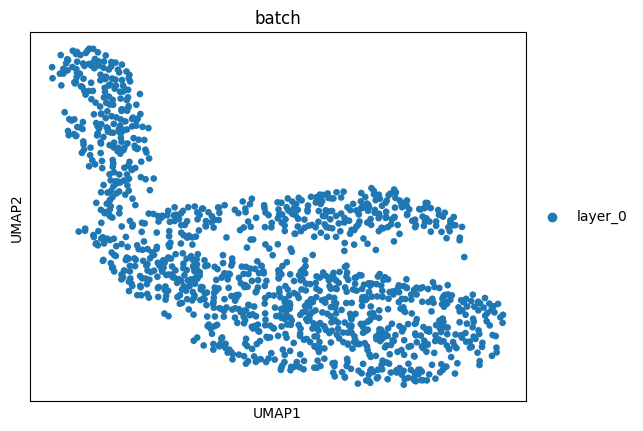

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_17/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 18	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


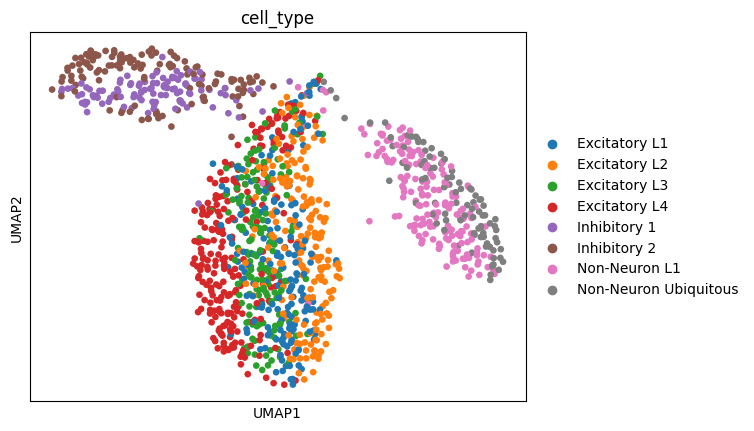

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


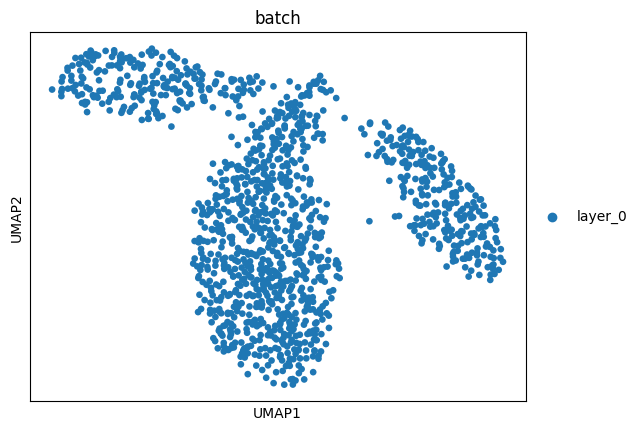

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_18/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 19	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


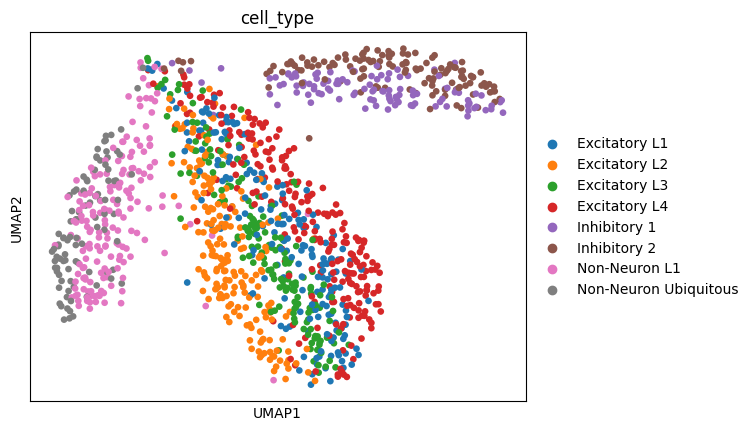

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


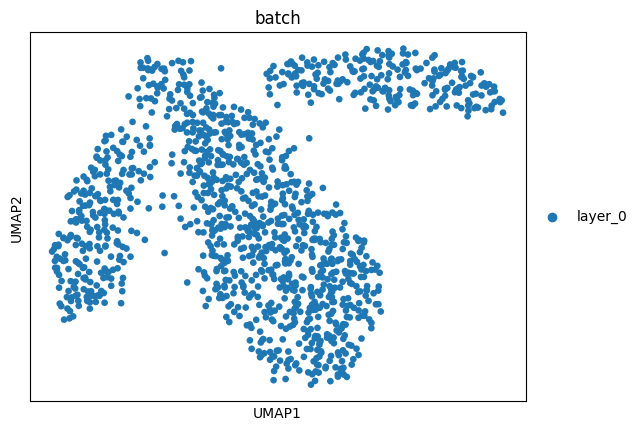

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_19/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 0	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


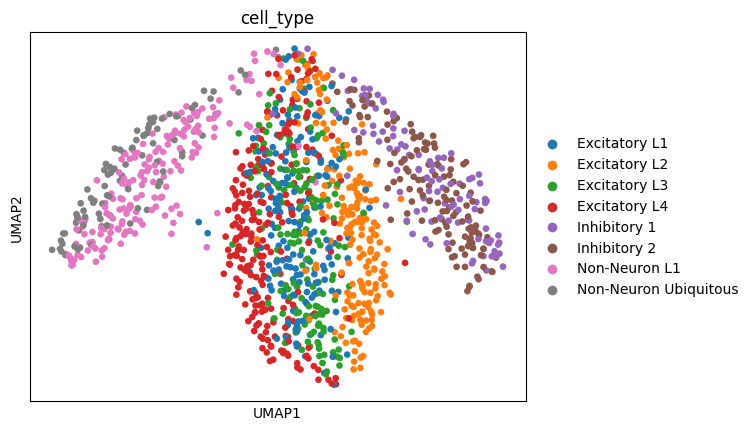

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


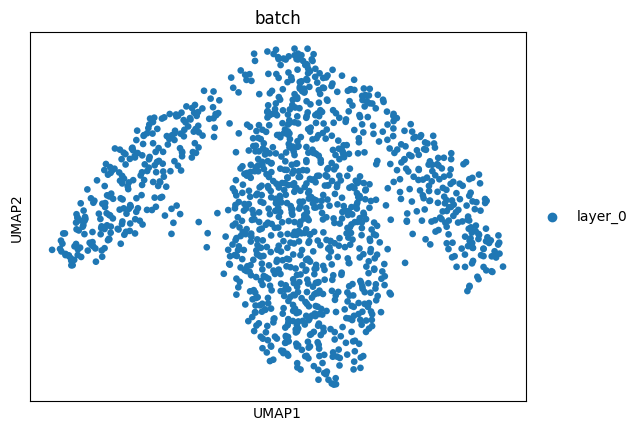

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_0/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 1	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


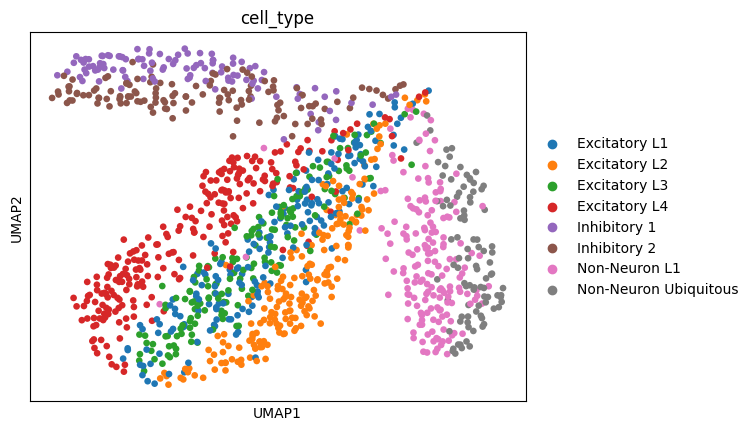

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


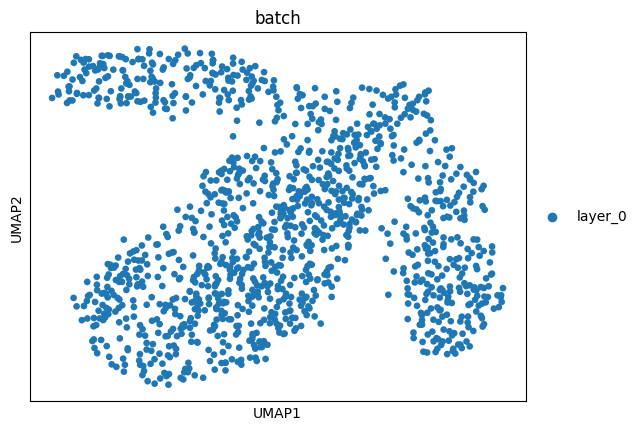

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_1/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 2	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


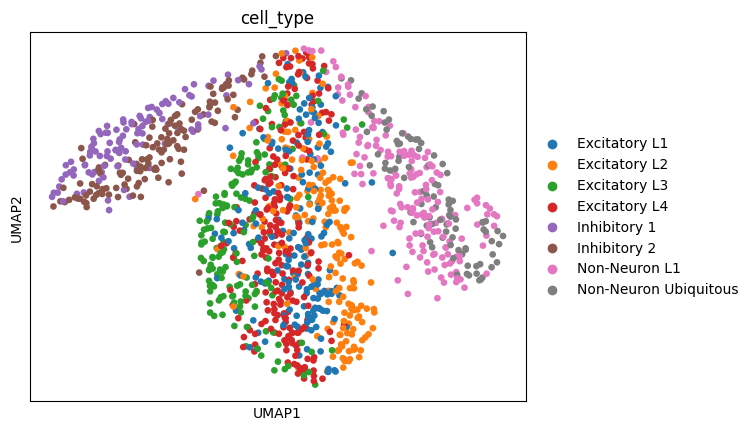

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


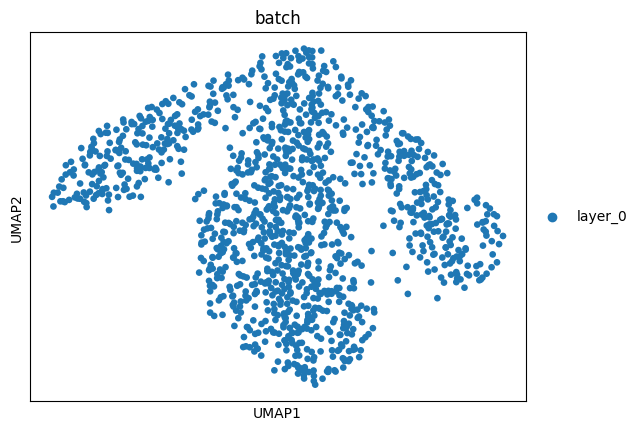

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_2/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 3	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


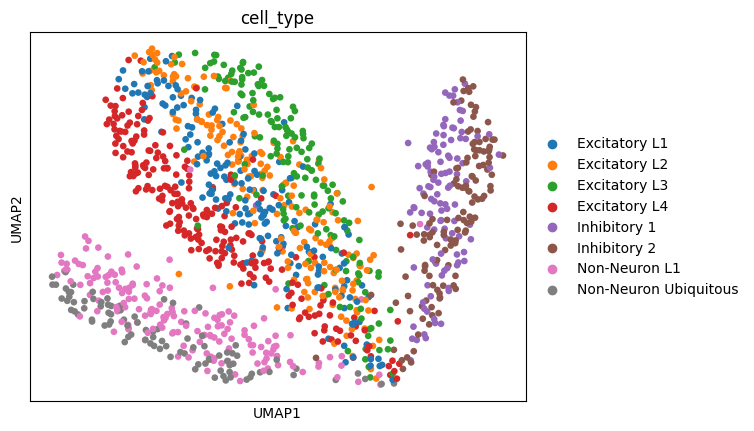

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


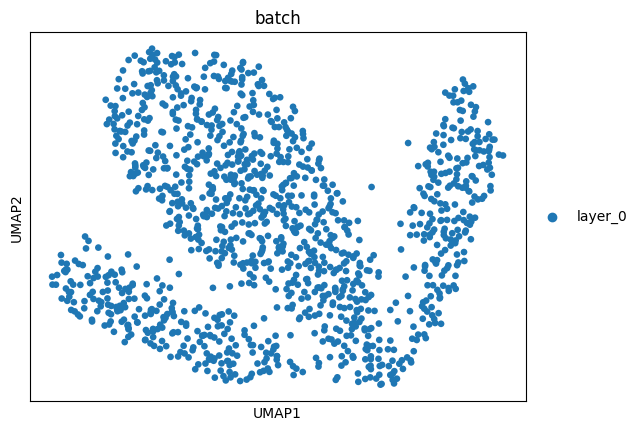

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_3/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 4	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


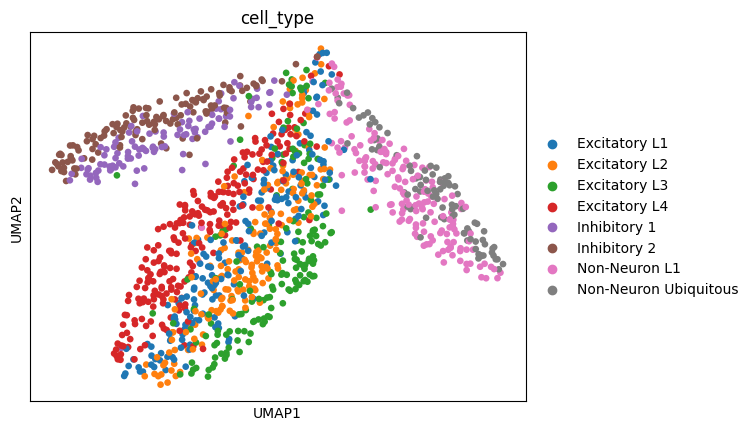

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


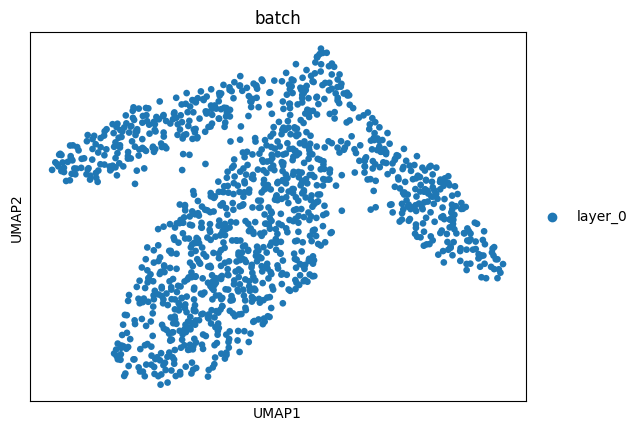

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_4/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 5	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


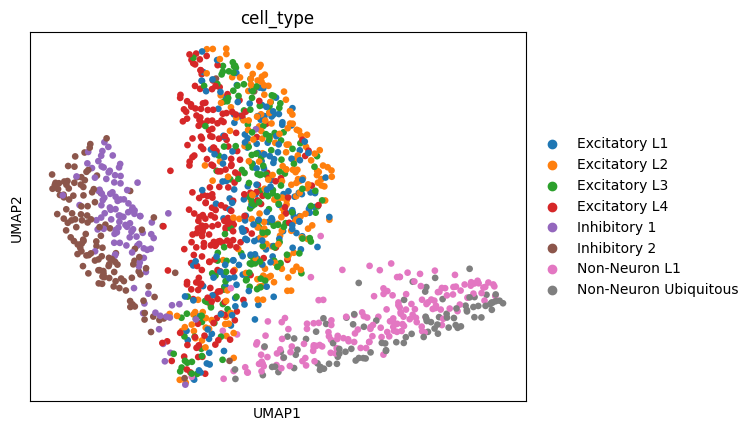

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


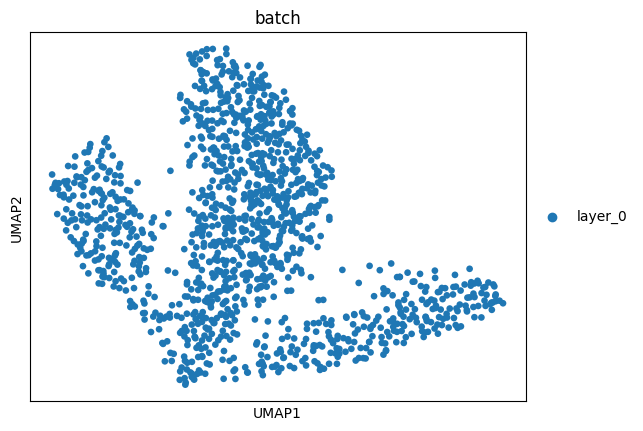

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_5/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 6	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


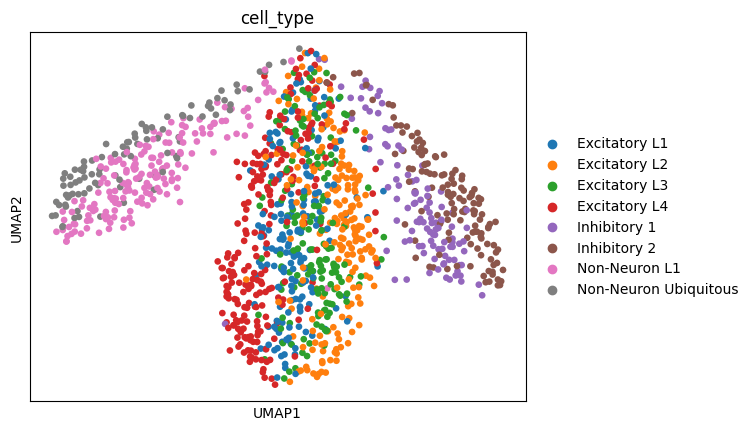

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


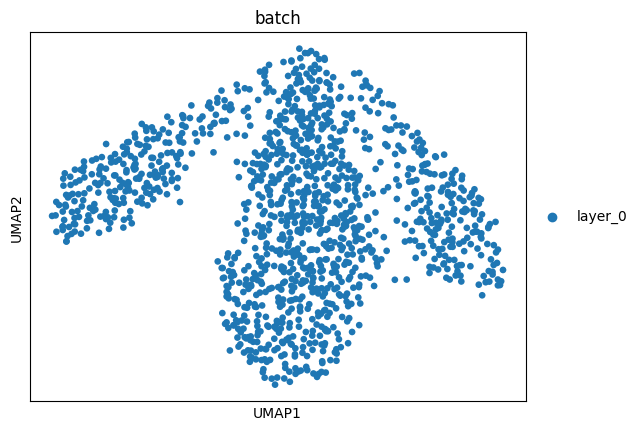

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_6/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 7	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


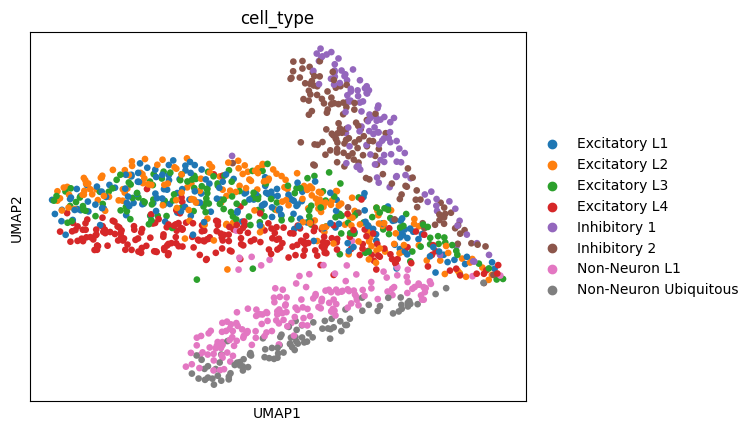

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


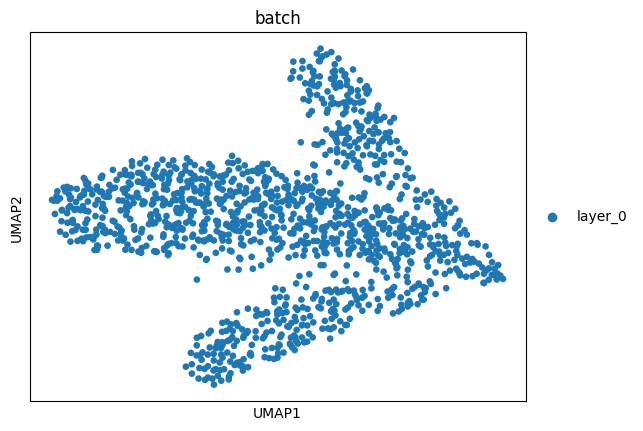

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_7/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 8	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


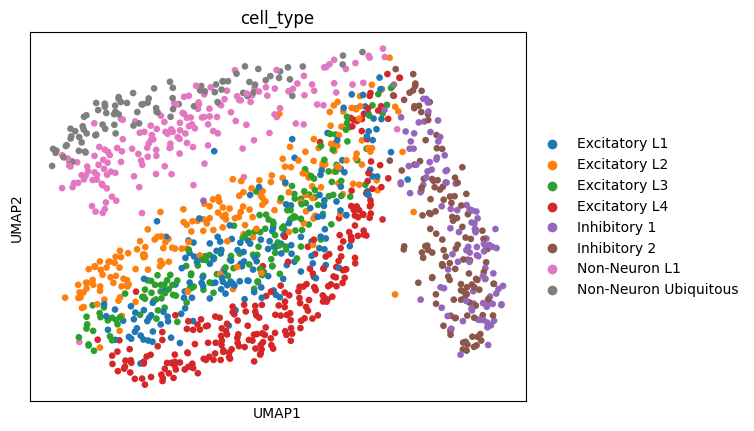

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


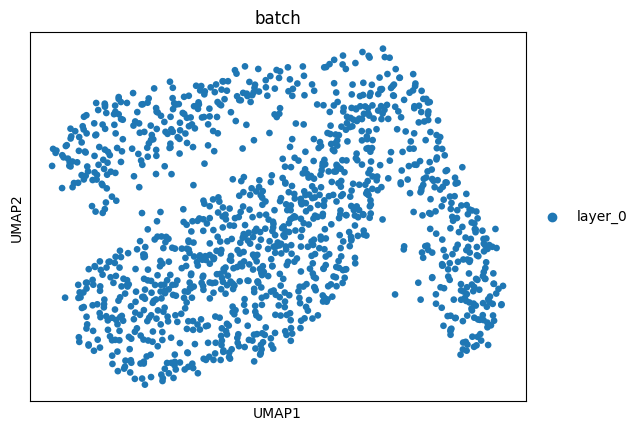

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_8/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 9	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


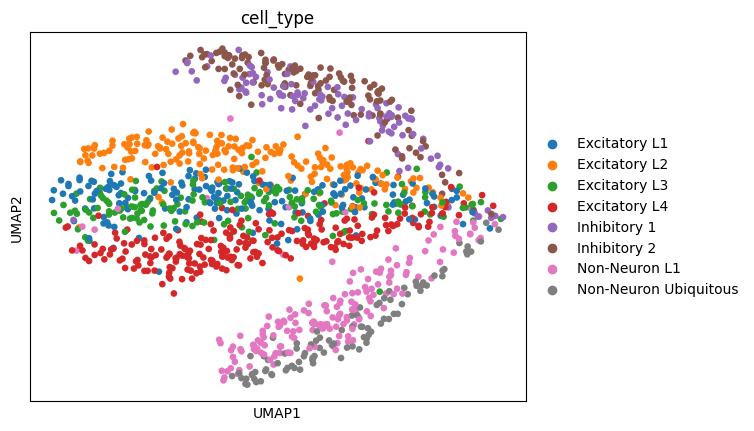

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


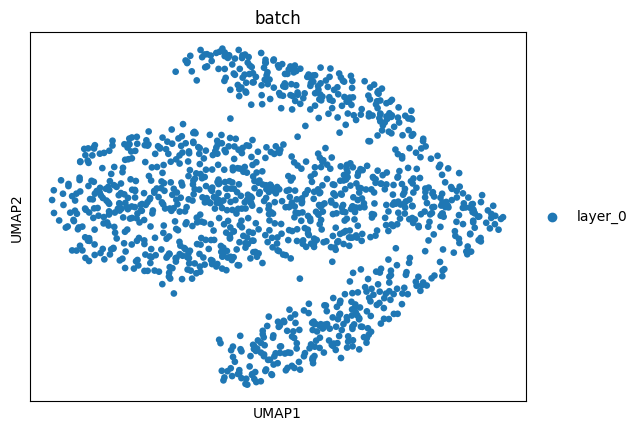

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_9/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 10	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


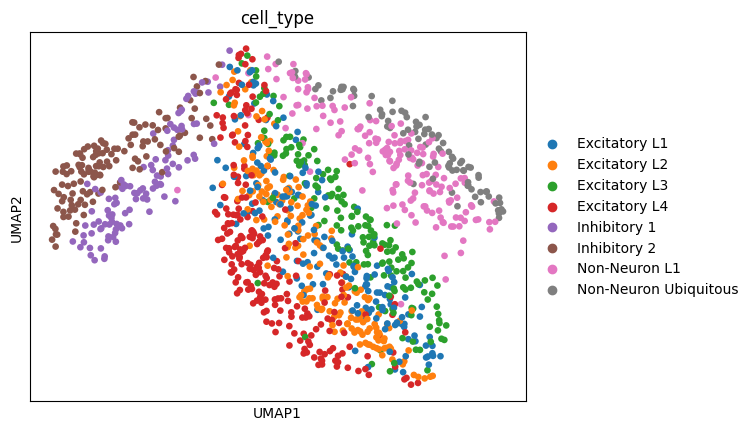

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


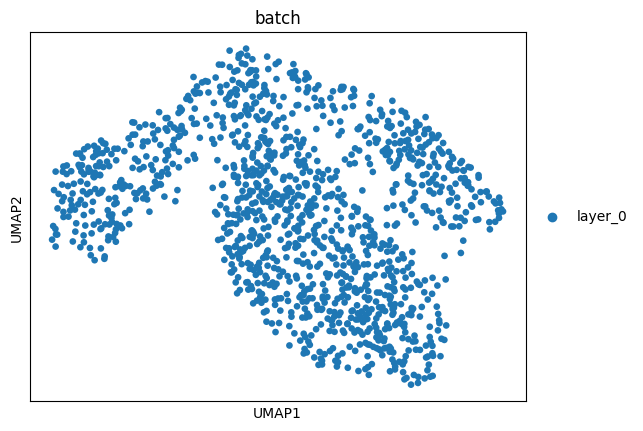

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_10/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 11	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


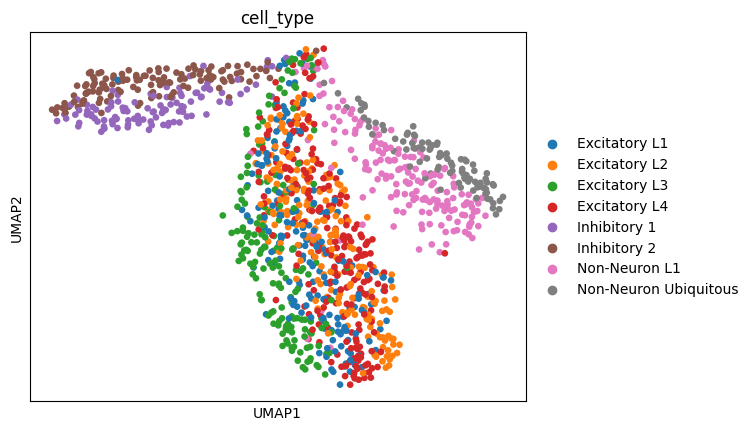

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


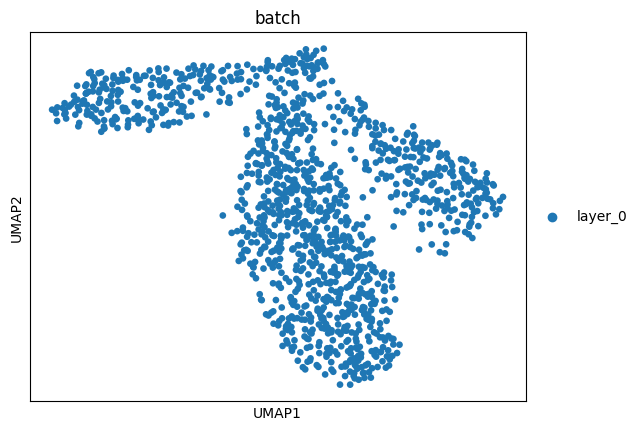

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_11/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 12	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


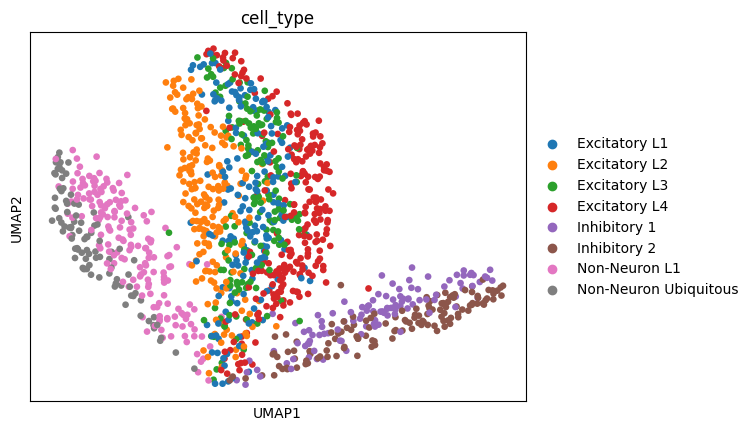

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


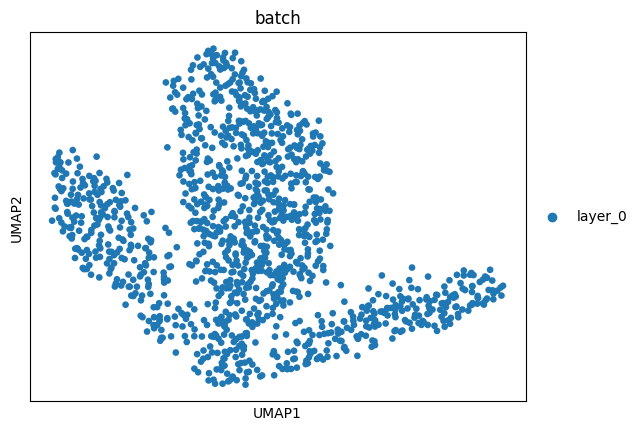

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_12/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 13	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


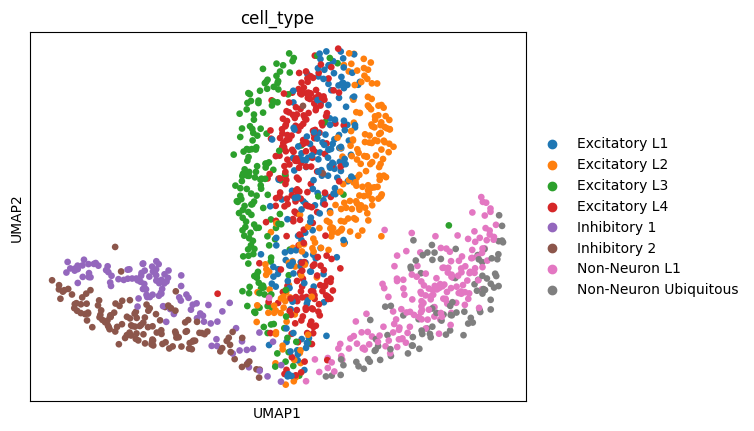

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


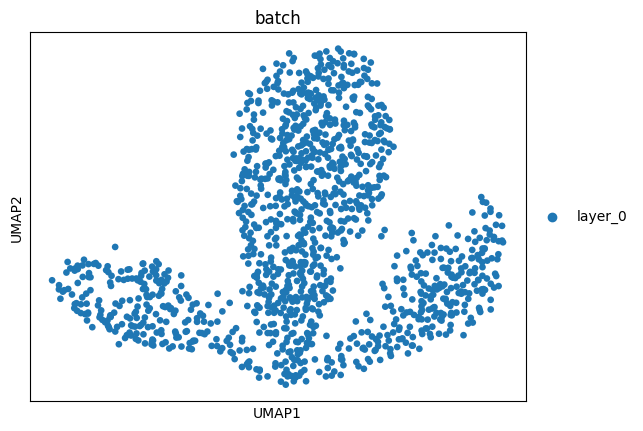

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_13/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 14	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


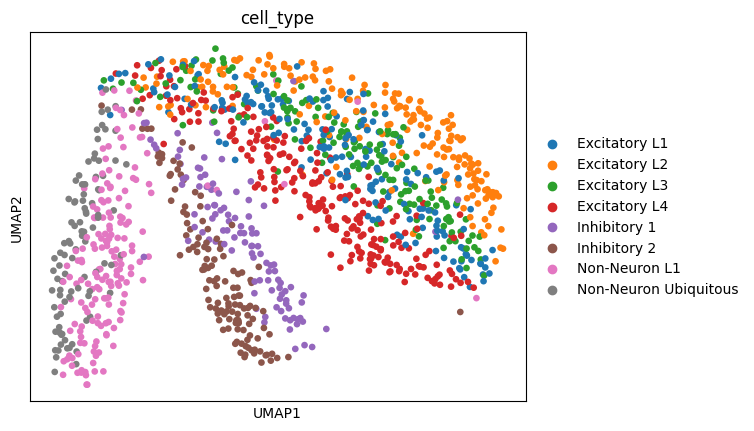

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


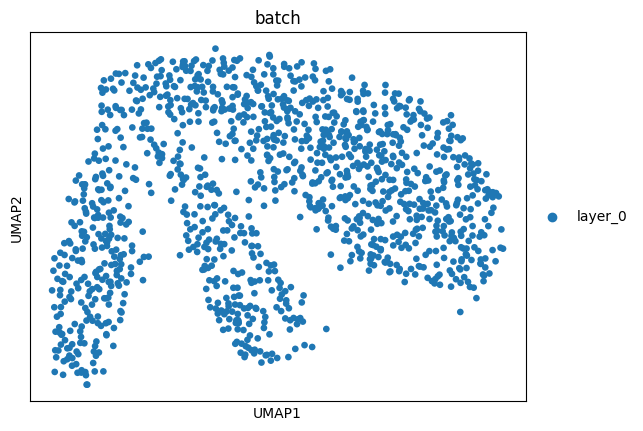

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_14/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 15	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


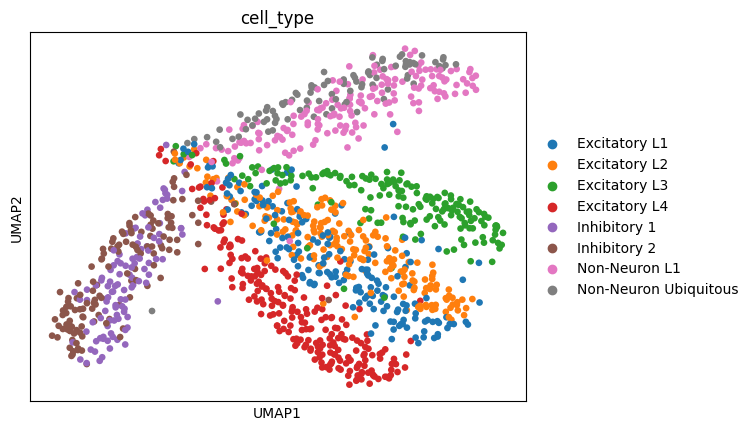

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


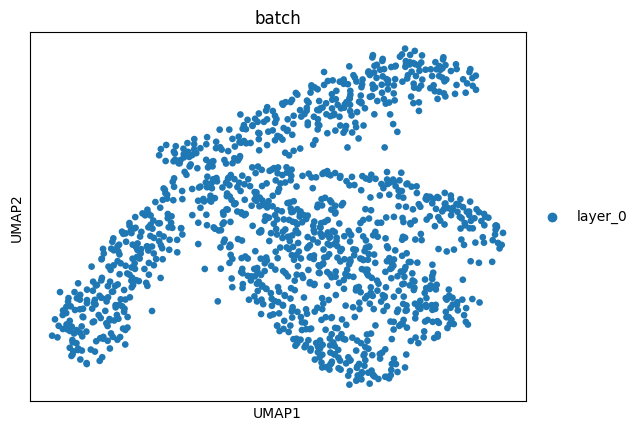

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_15/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 16	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


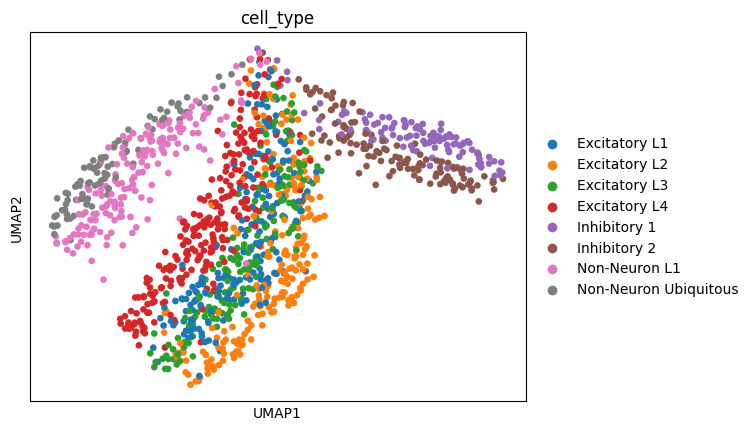

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


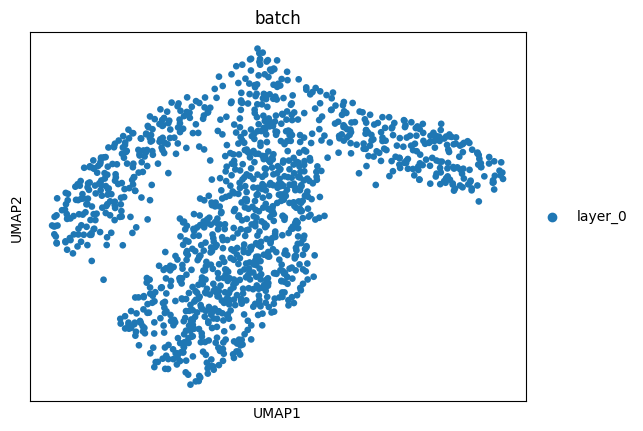

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_16/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 17	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


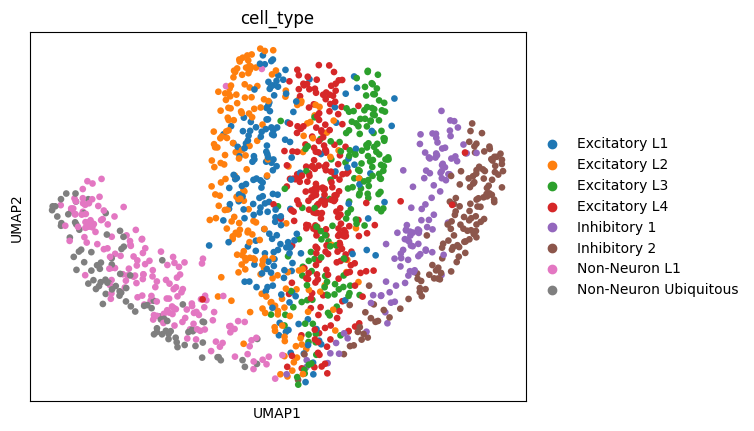

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


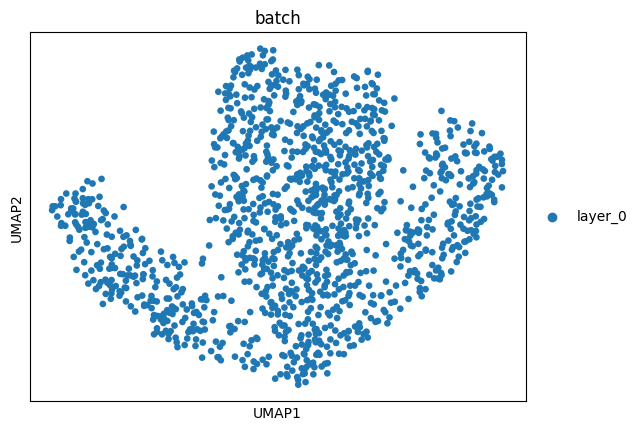

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_17/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 18	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


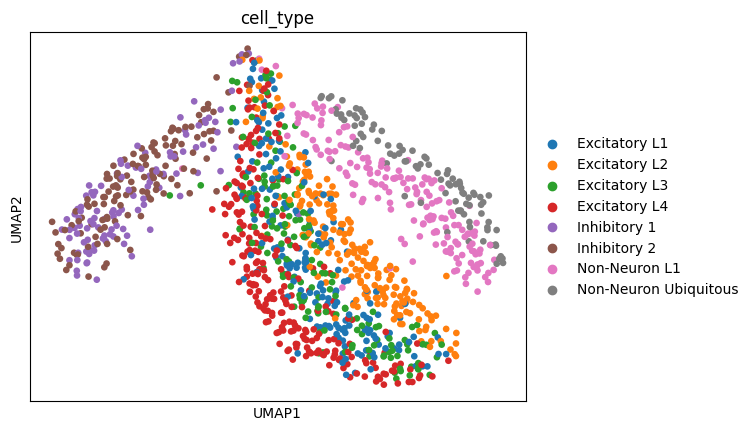

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


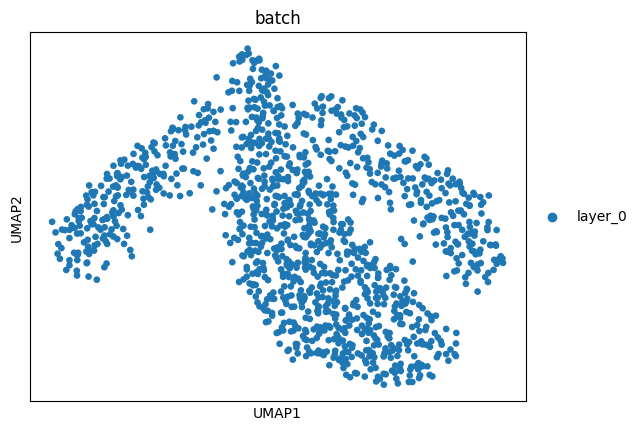

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_18/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.0	noise_metagene_parameter: 4.0	random_state: 19	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


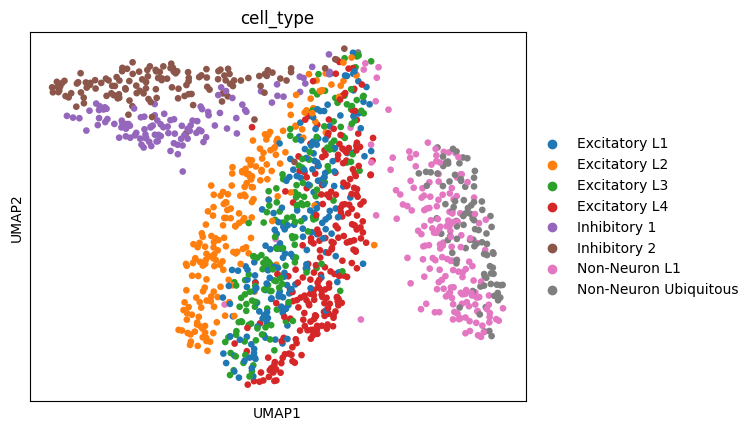

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


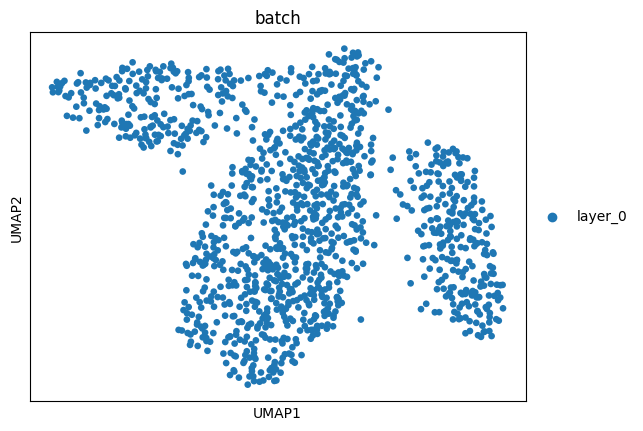

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_19/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 0	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


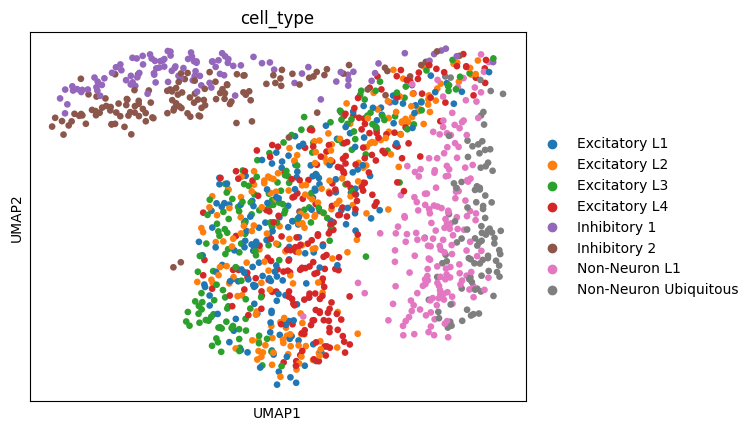

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


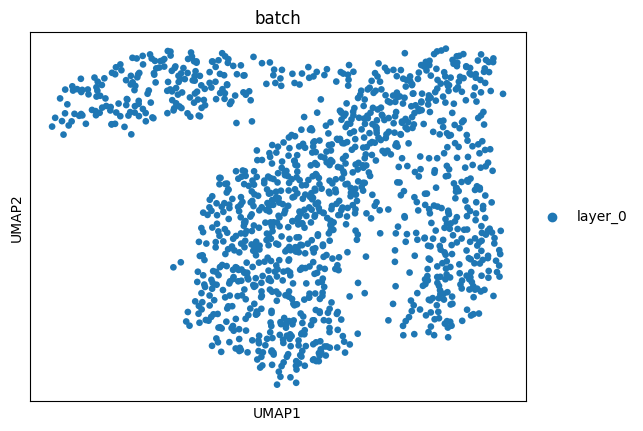

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_0/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 1	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


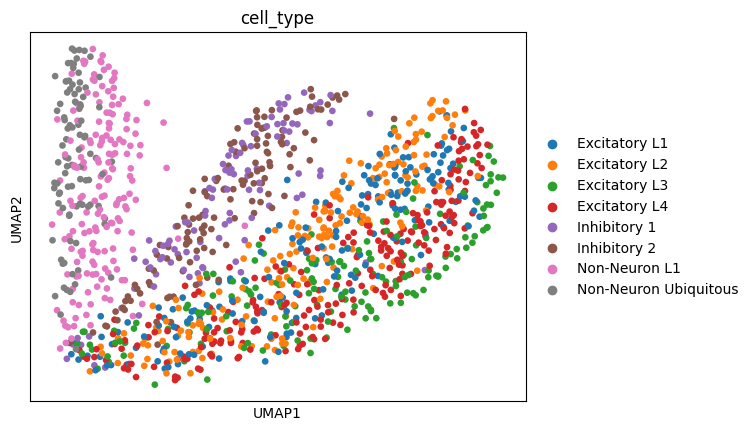

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


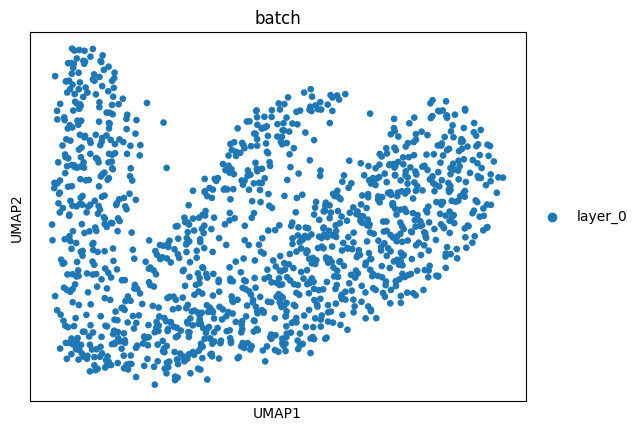

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_1/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 2	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


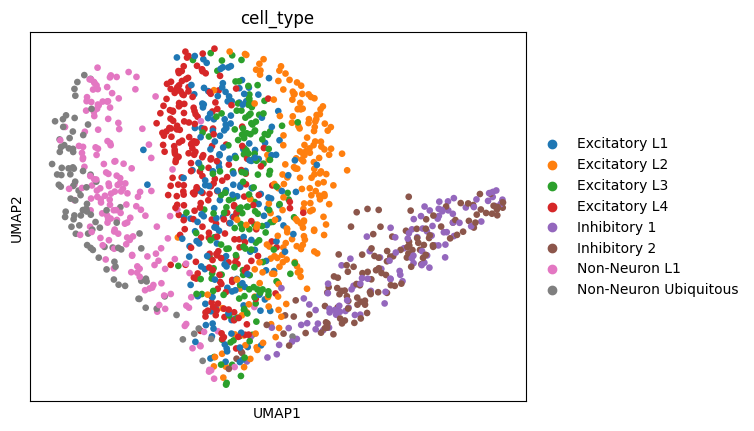

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


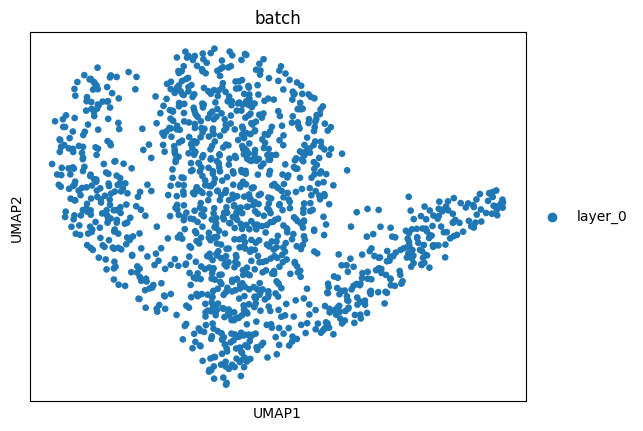

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_2/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 3	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


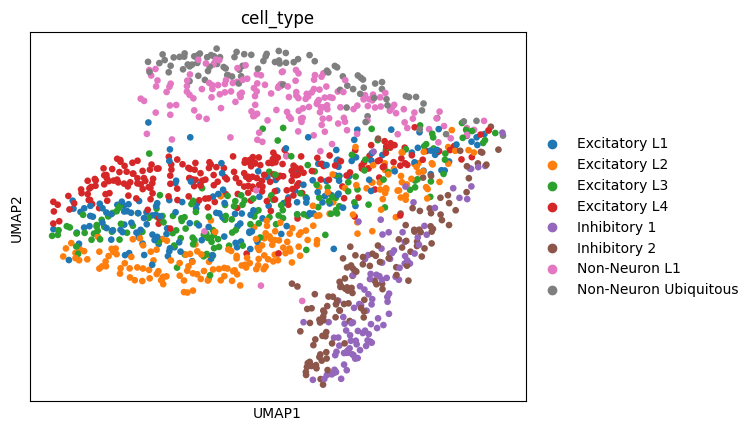

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


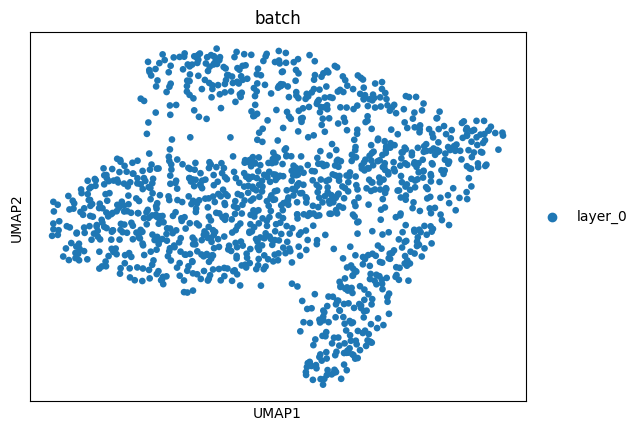

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_3/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 4	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


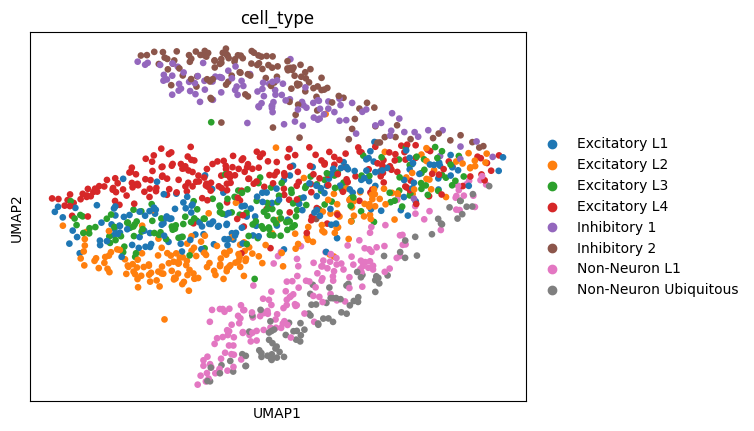

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


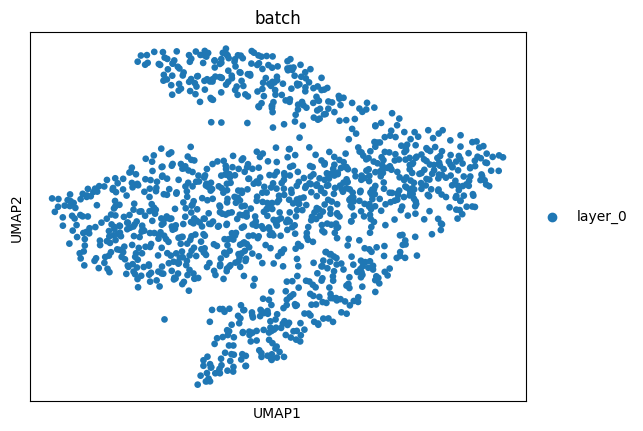

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_4/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 5	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


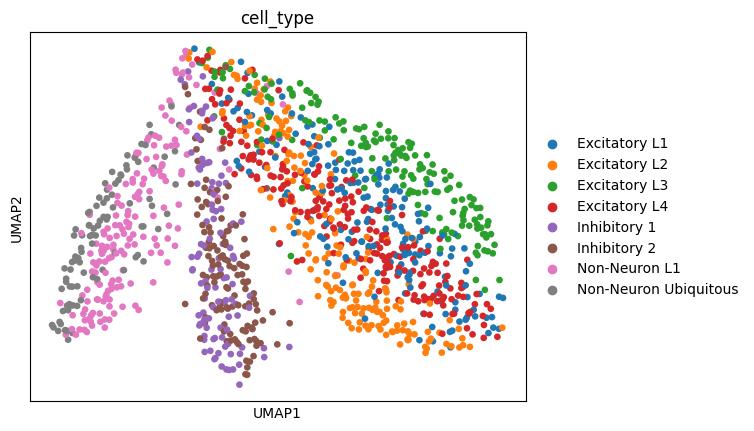

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


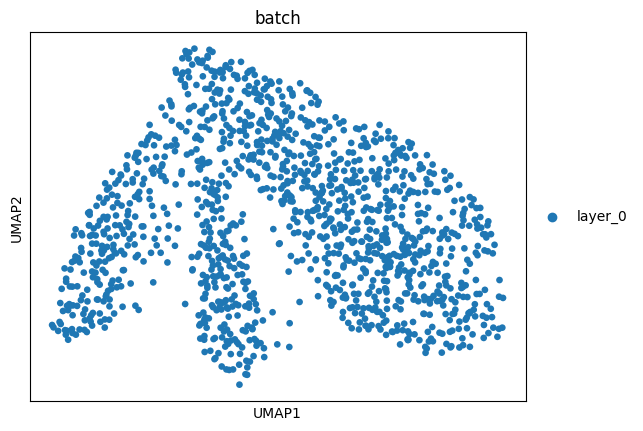

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_5/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 6	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


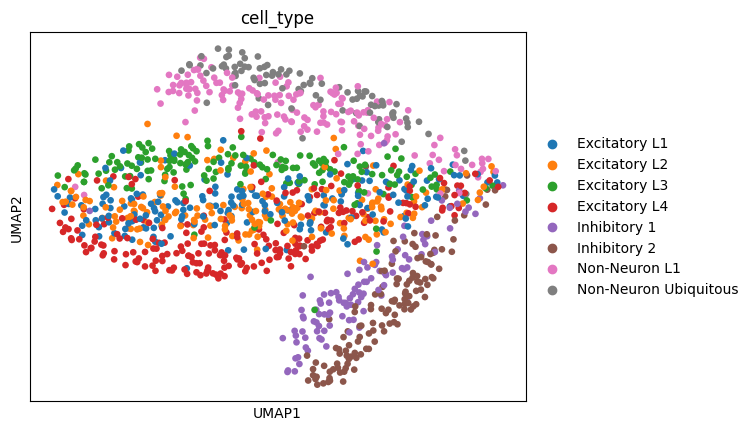

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


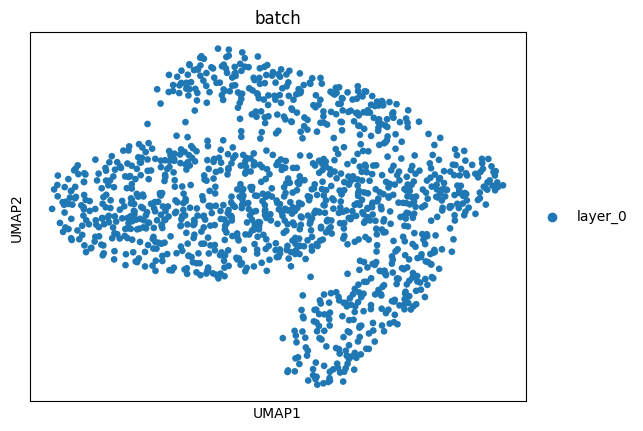

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_6/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 7	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


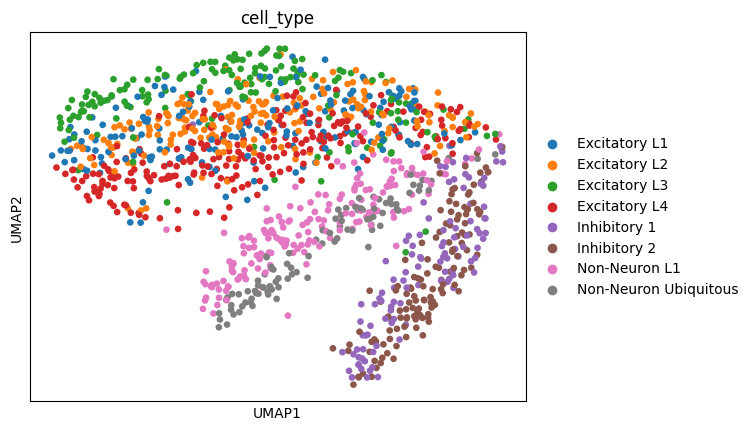

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


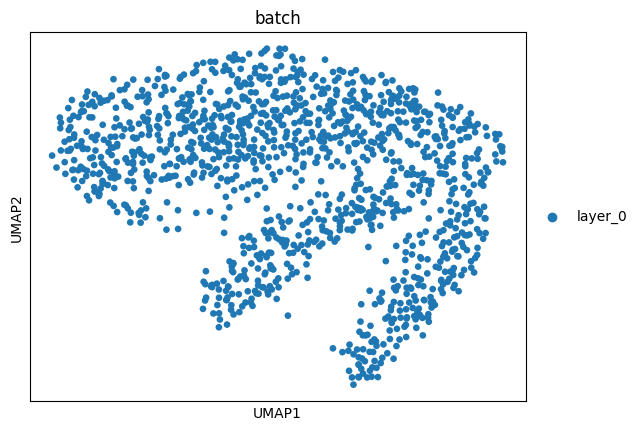

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_7/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 8	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


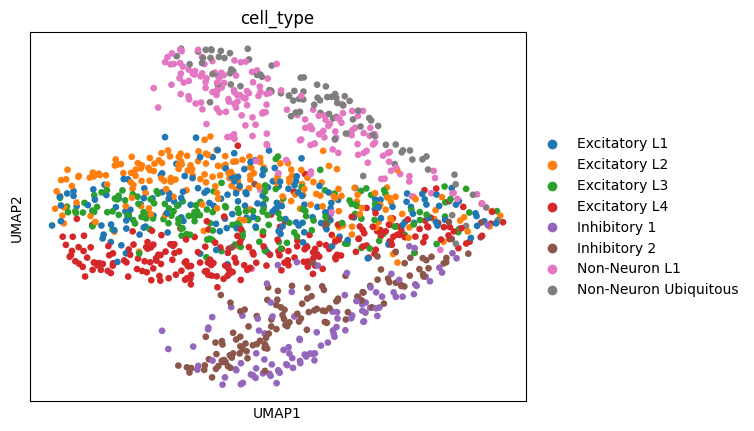

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


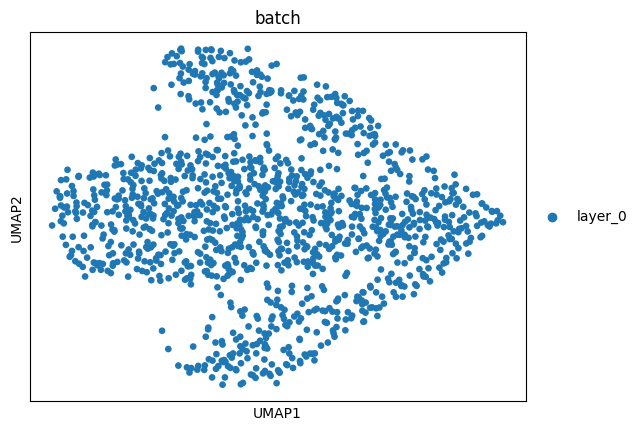

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_8/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 9	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


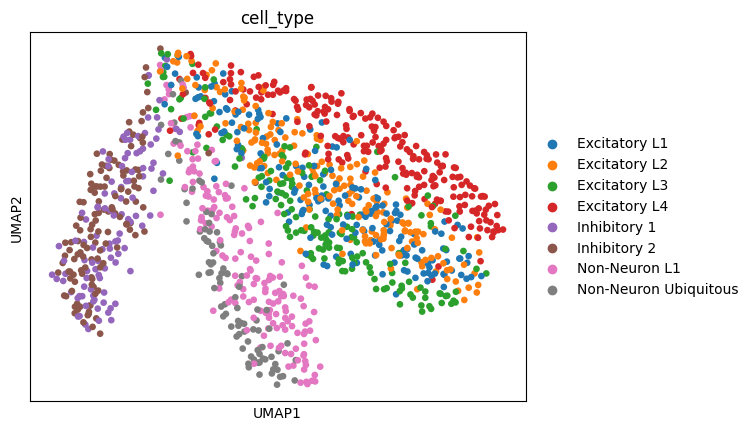

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


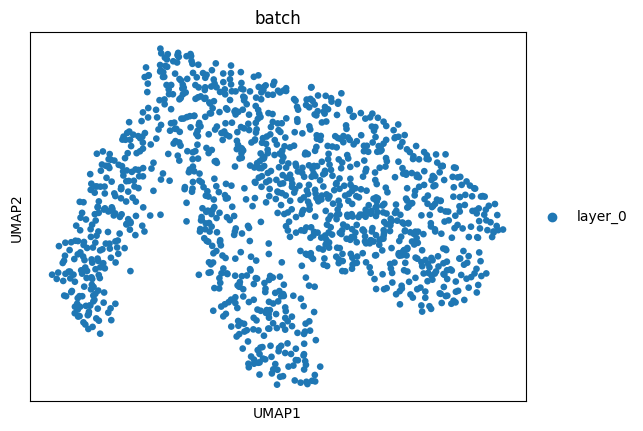

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_9/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 10	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


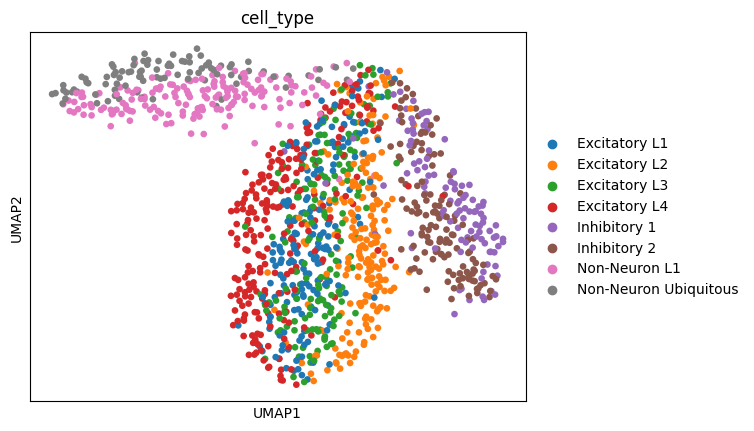

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


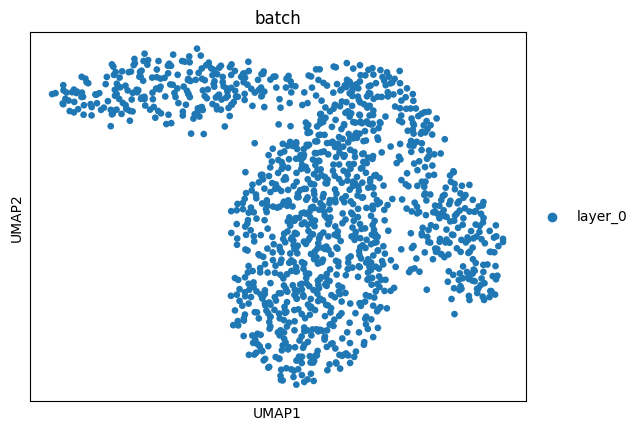

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_10/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 11	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


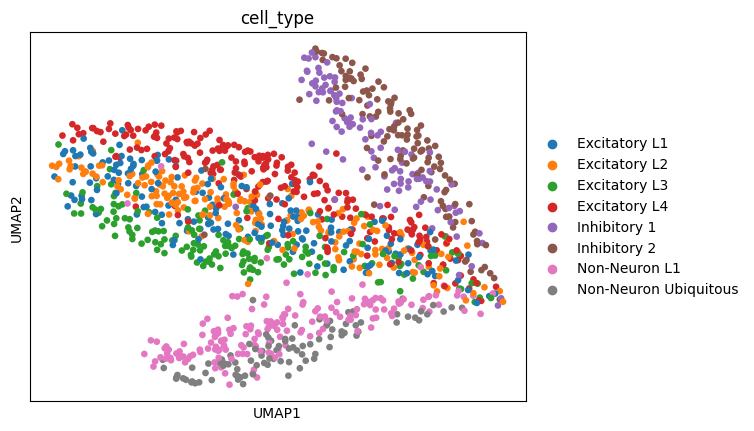

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


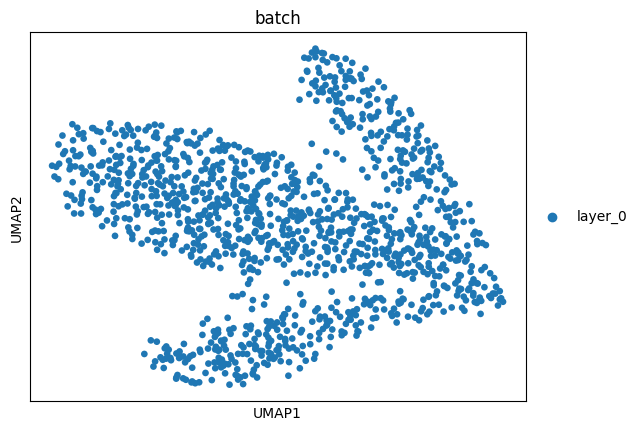

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_11/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 12	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


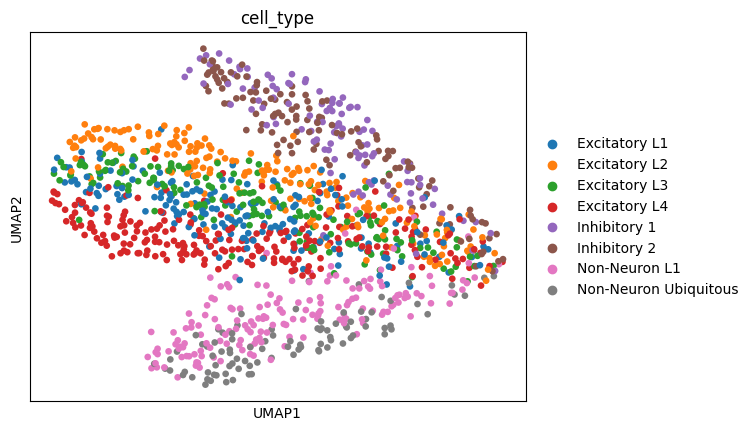

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


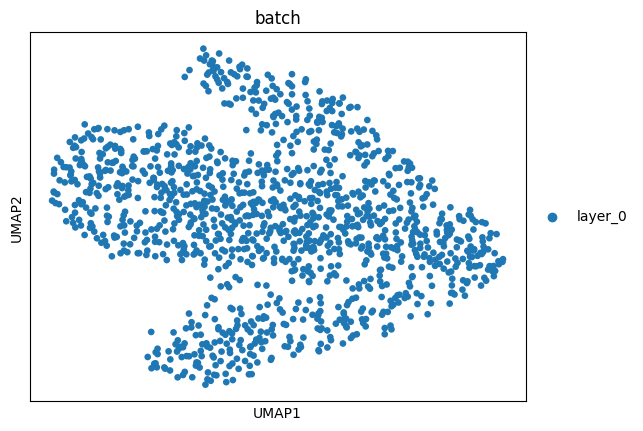

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_12/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 13	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


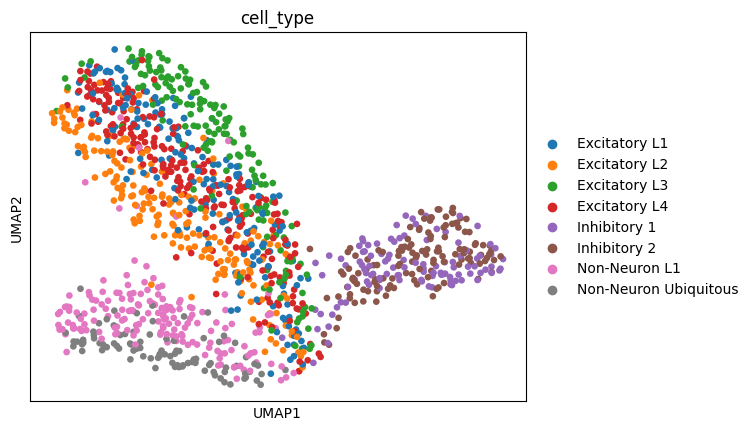

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


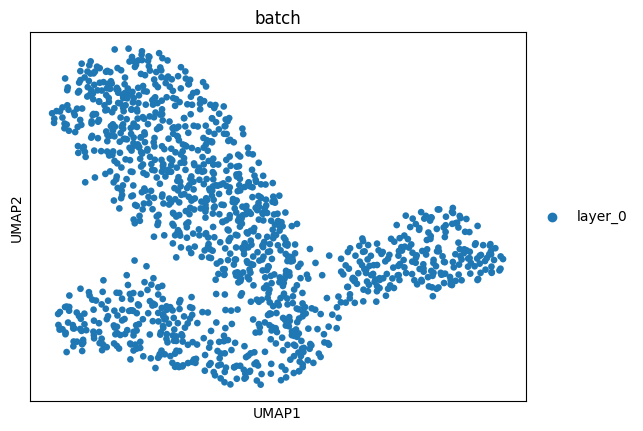

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_13/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 14	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


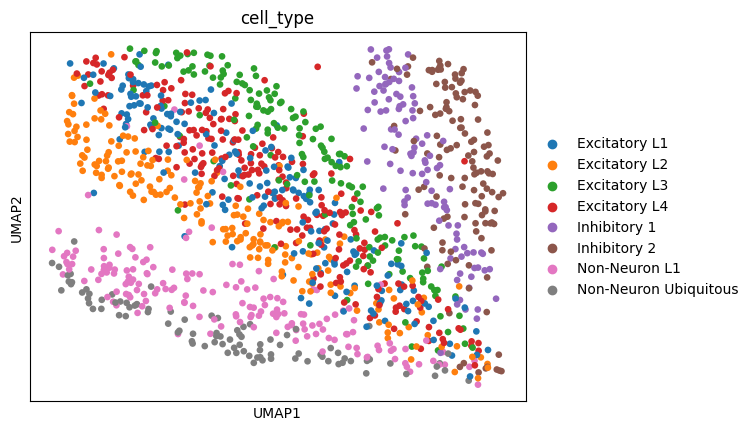

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


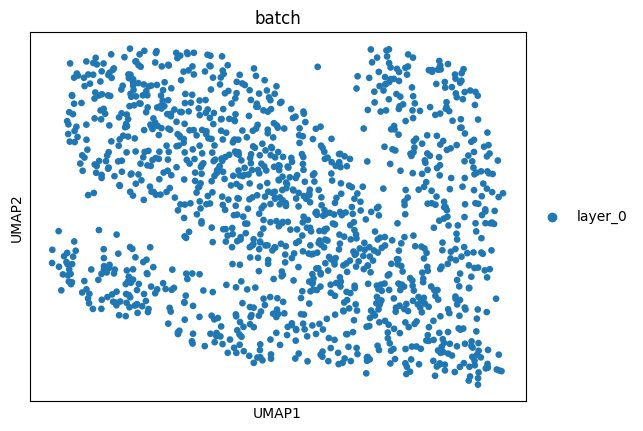

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_14/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 15	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


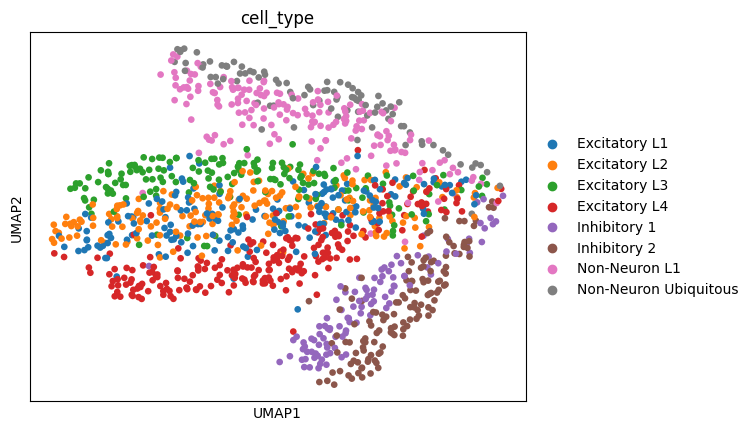

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


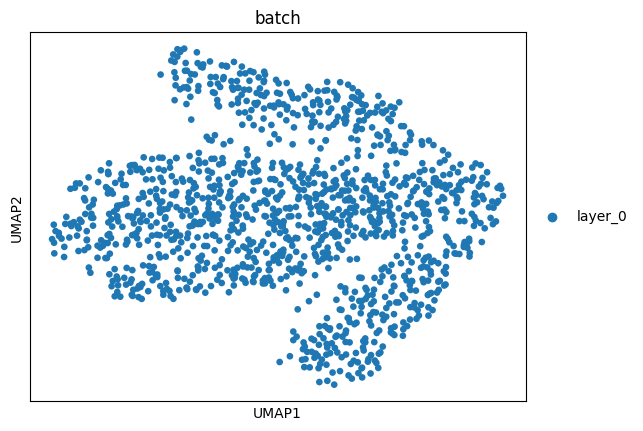

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_15/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 16	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


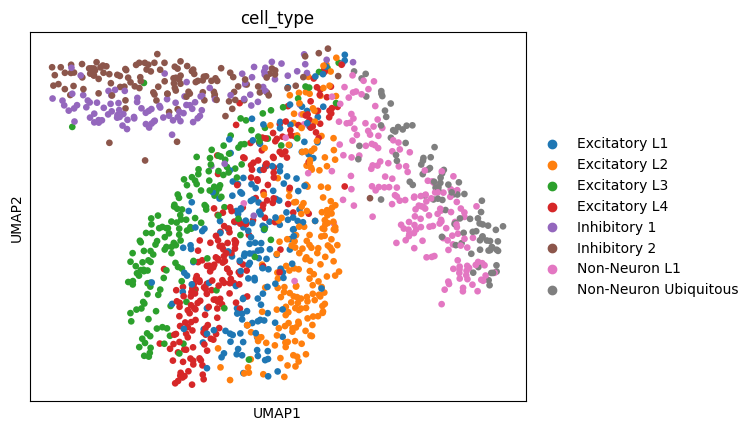

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


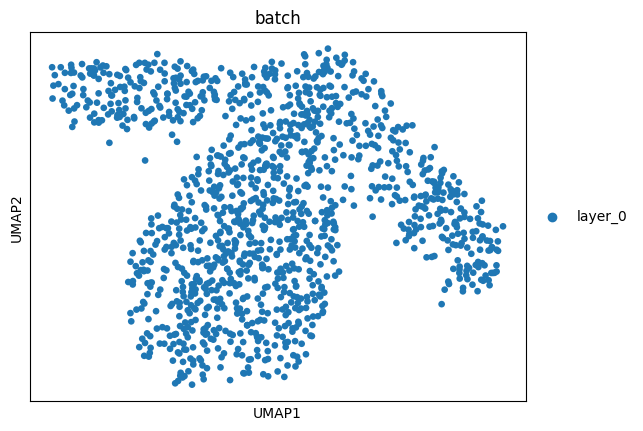

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_16/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 17	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


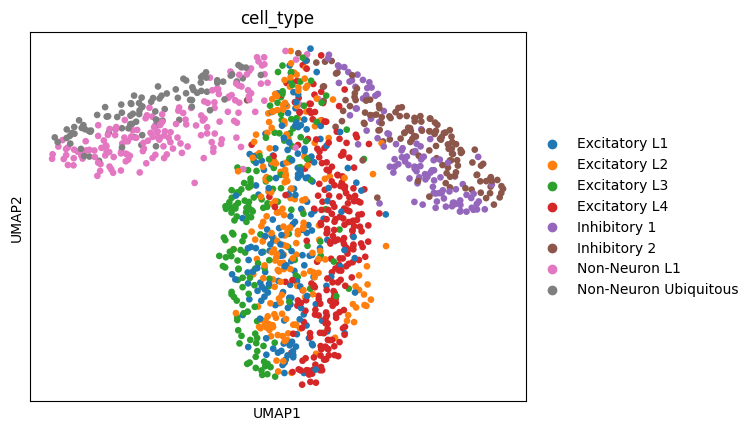

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


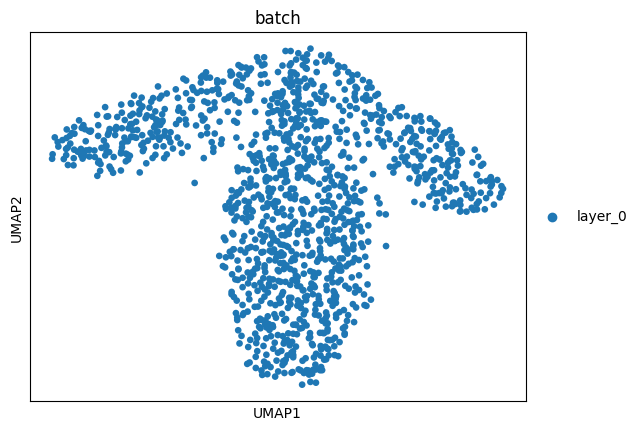

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_17/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 18	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


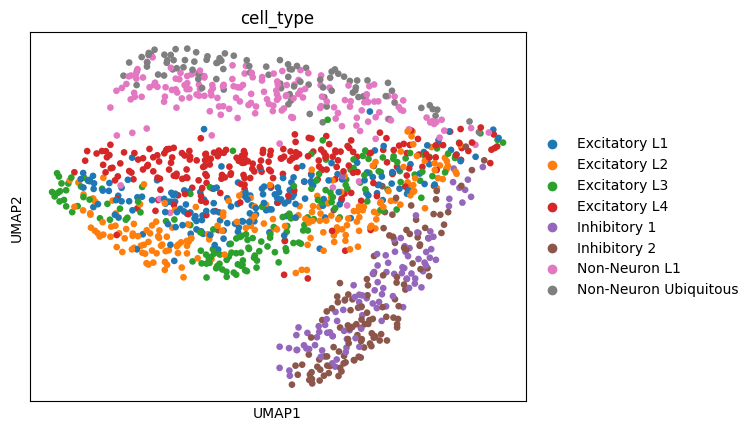

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


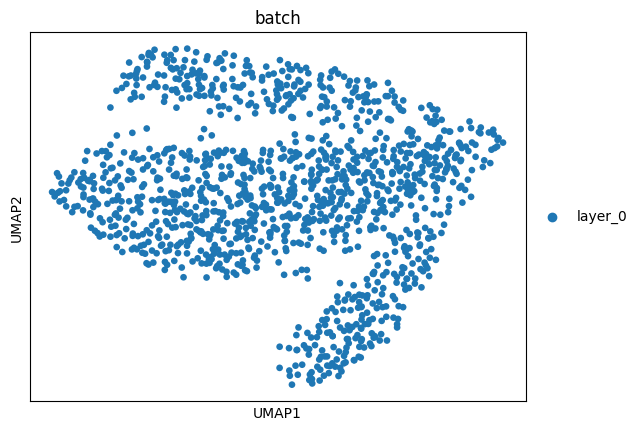

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_18/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 2.5	noise_metagene_parameter: 4.0	random_state: 19	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


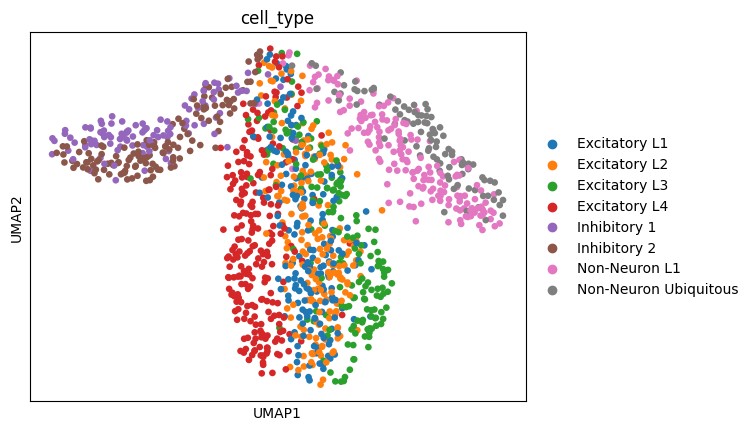

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


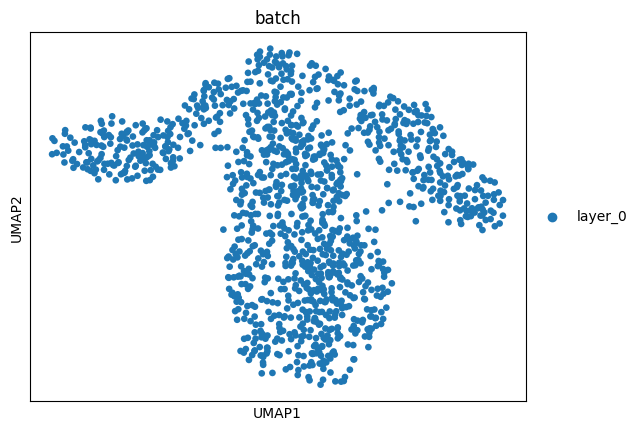

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-2.5_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_19/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 0	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


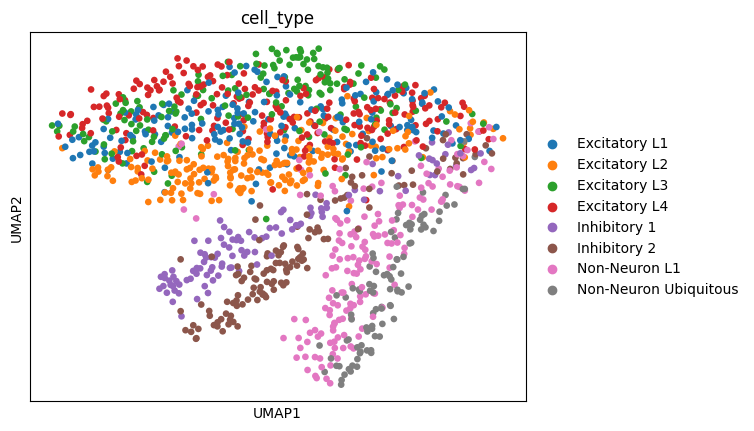

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


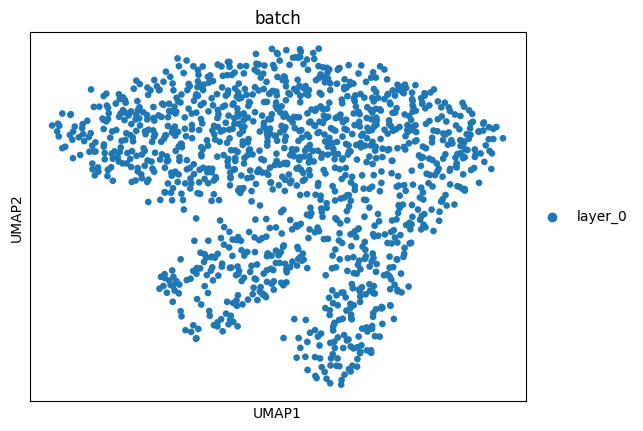

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_0/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 1	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


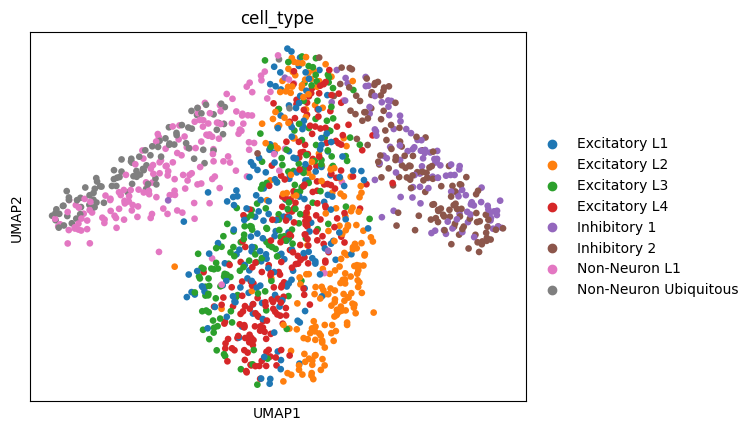

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


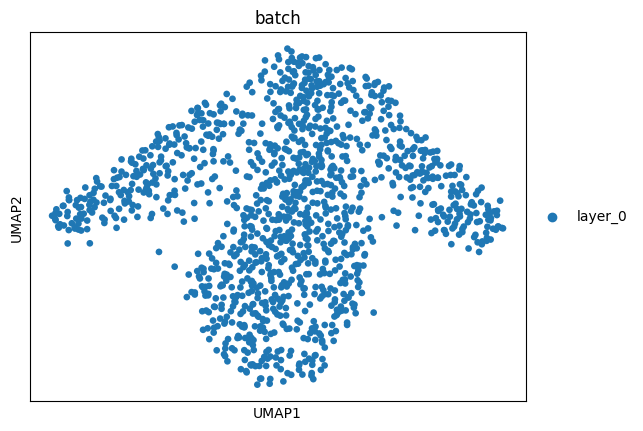

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_1/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 2	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


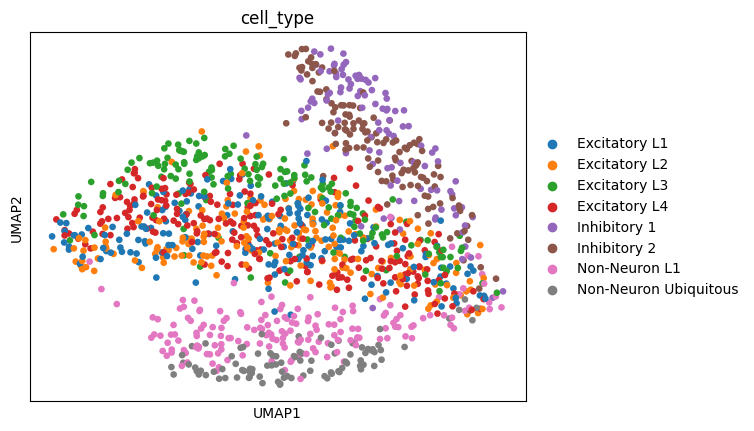

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


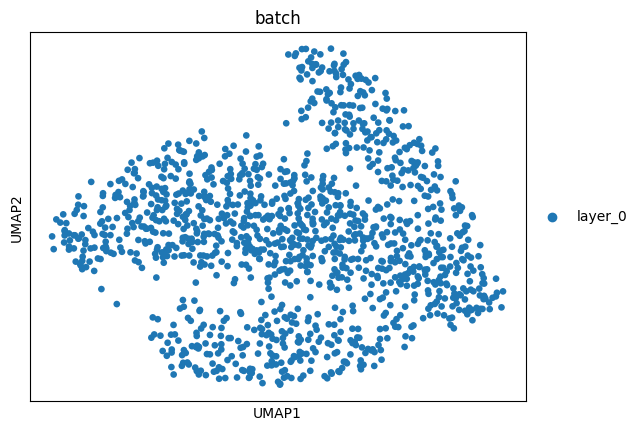

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_2/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 3	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


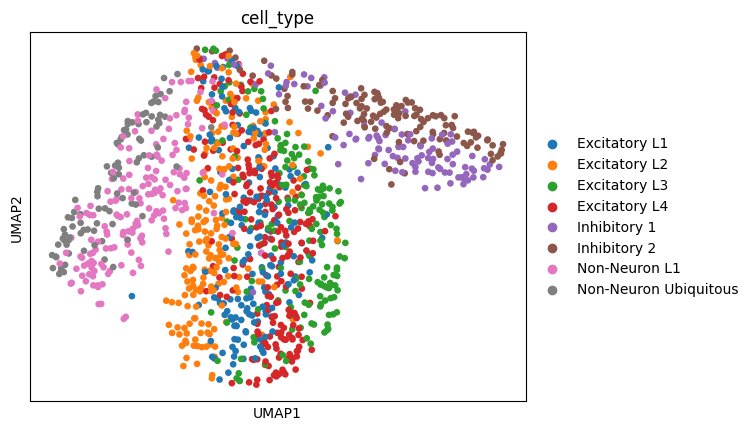

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


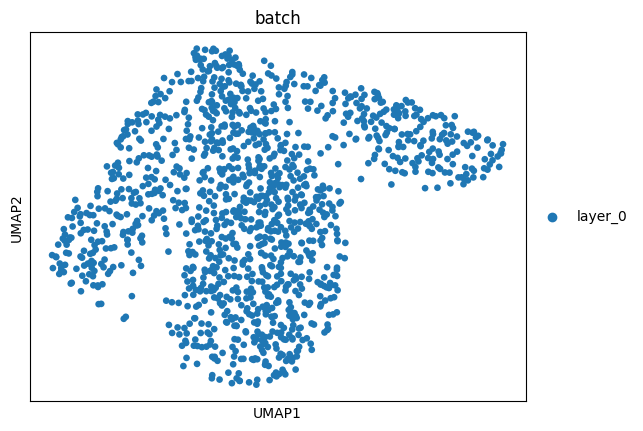

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_3/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 4	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


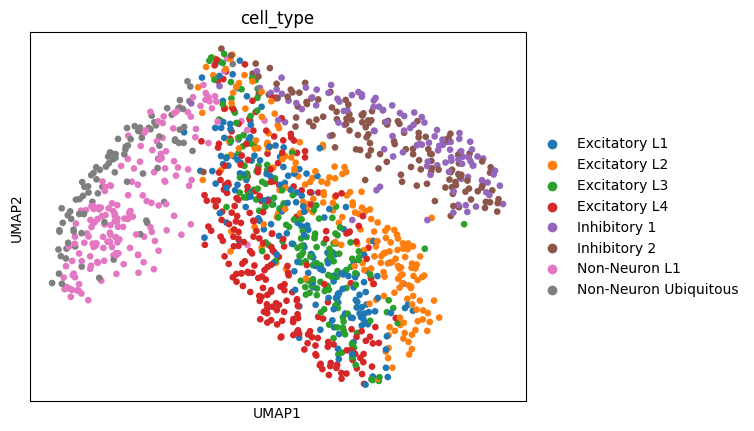

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


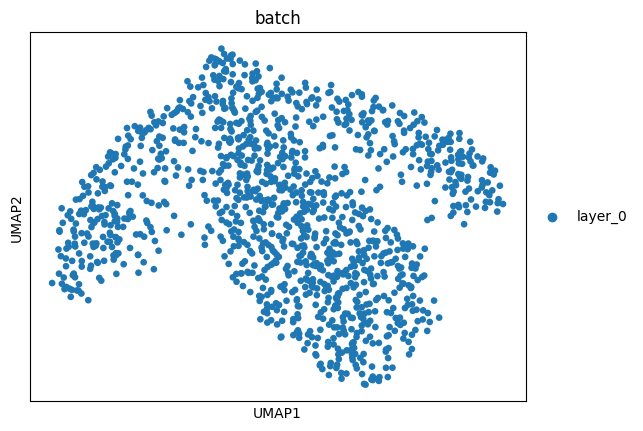

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_4/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 5	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


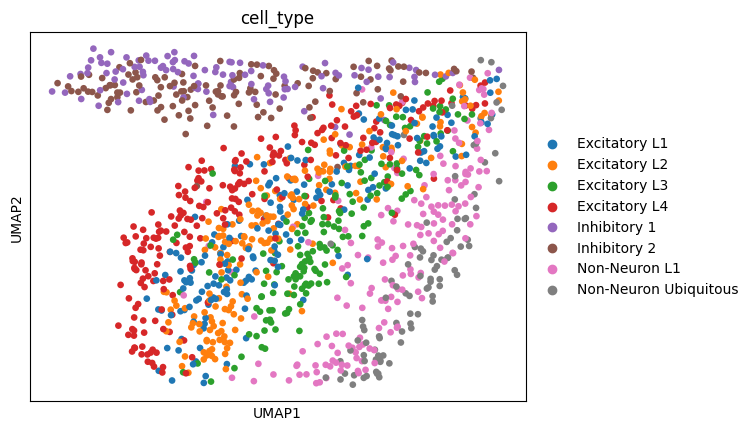

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


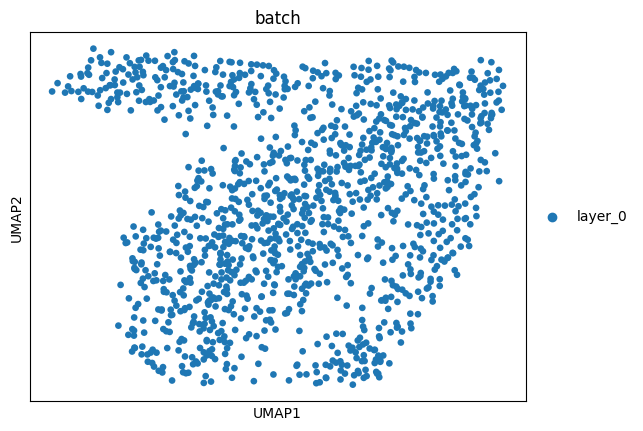

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_5/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 6	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


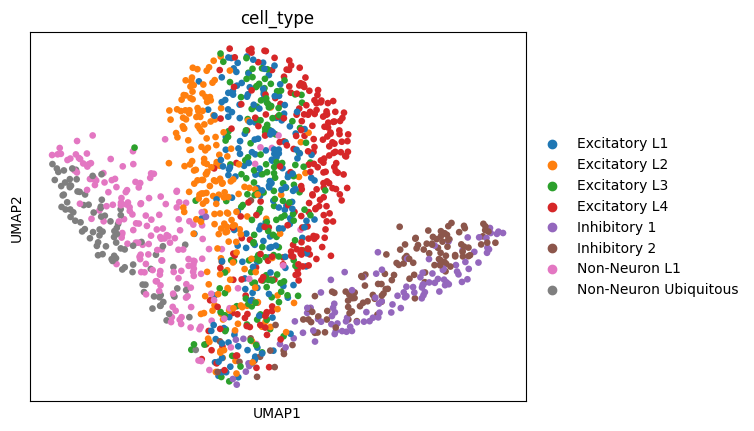

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


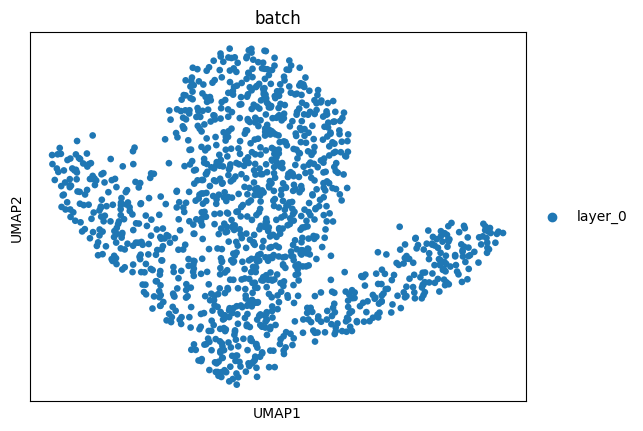

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_6/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 7	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


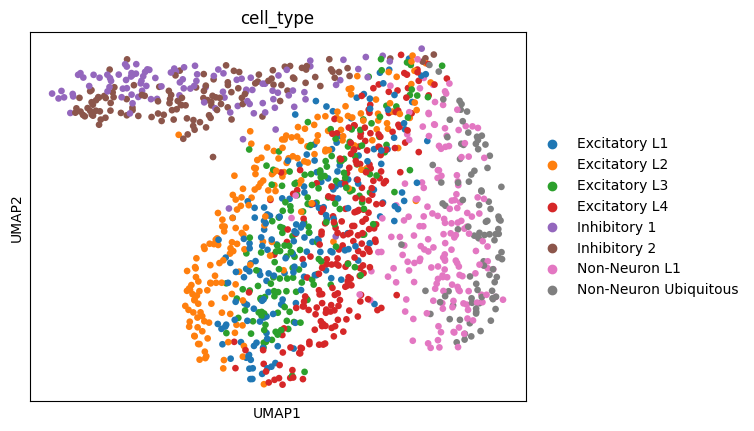

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


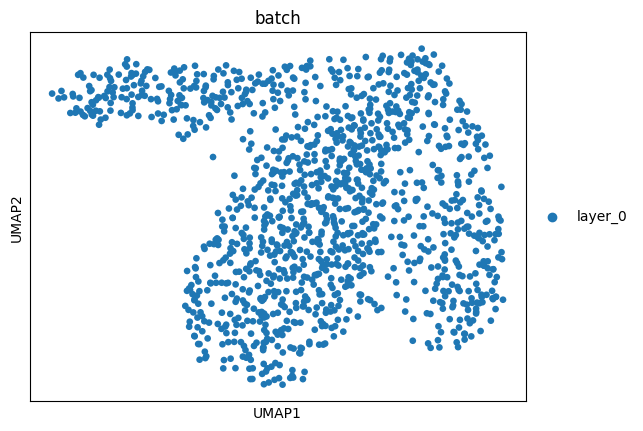

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_7/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 8	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


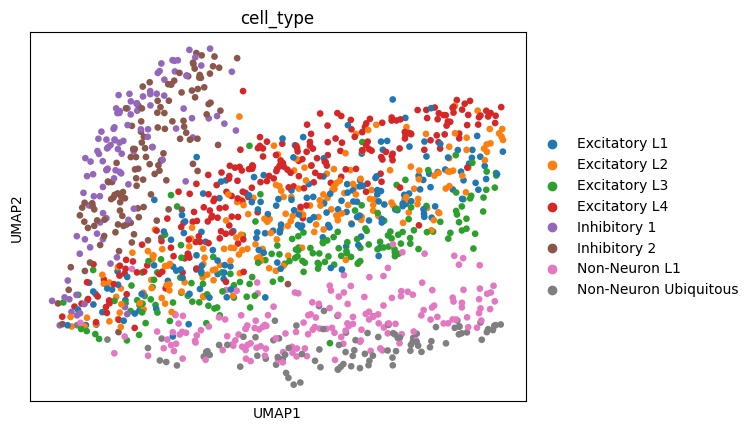

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


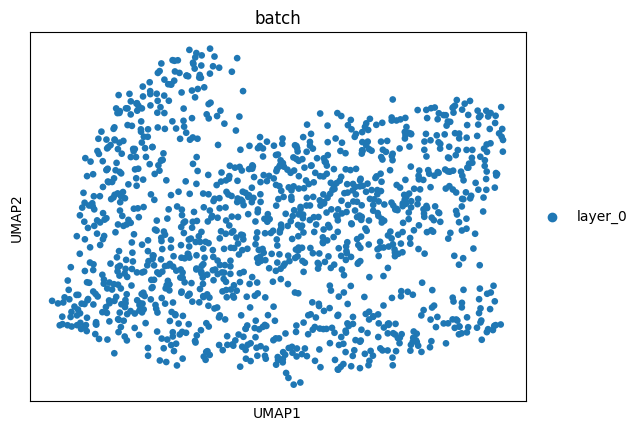

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_8/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 9	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


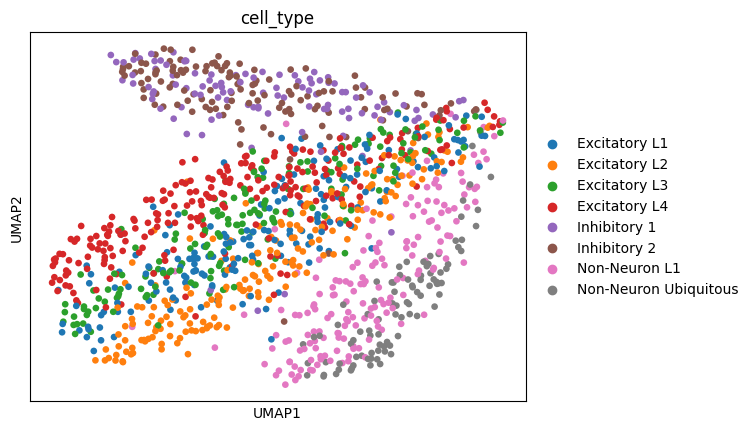

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


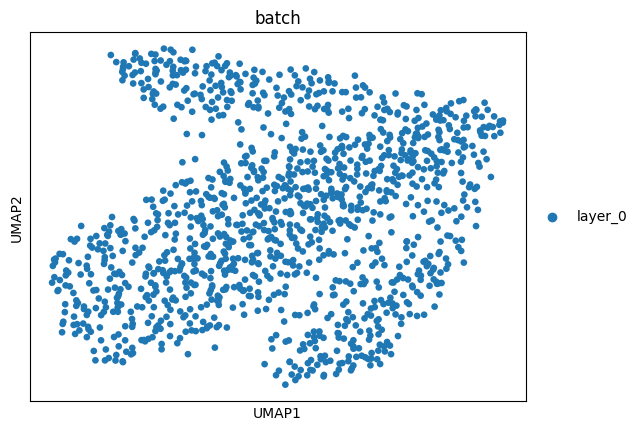

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_9/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 10	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


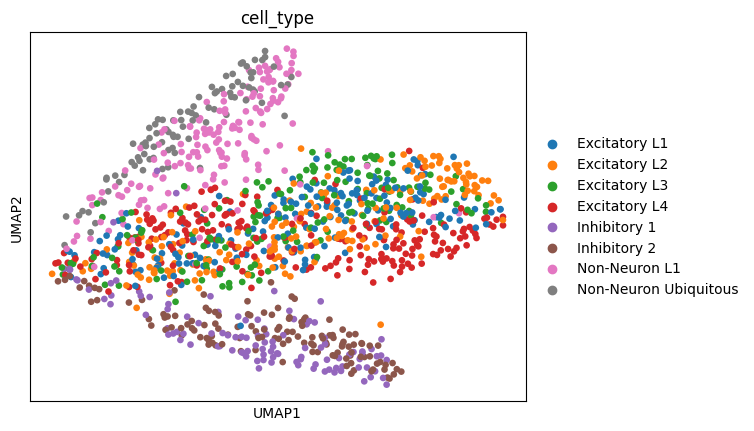

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


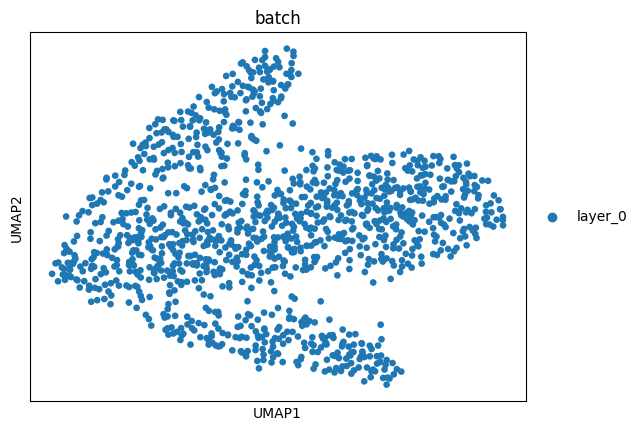

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_10/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 11	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


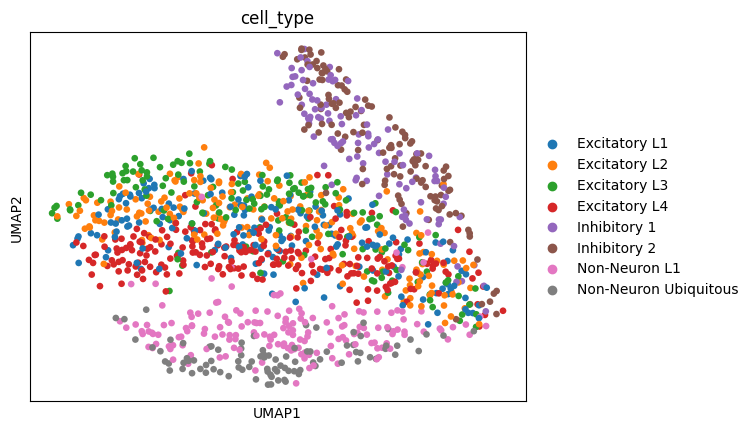

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


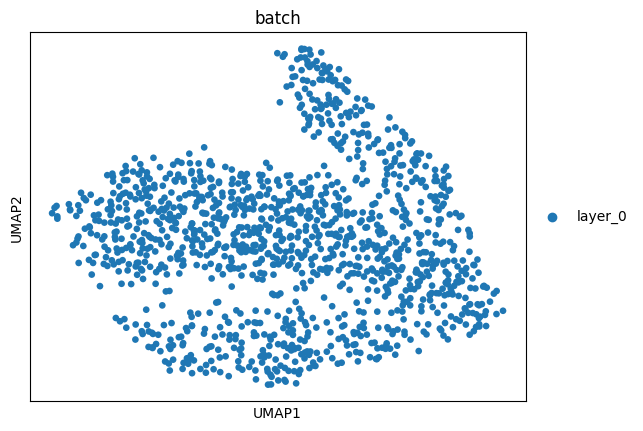

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_11/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 12	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


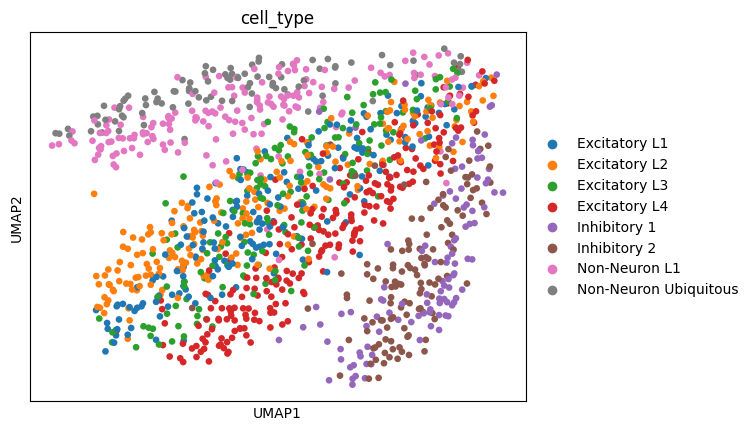

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


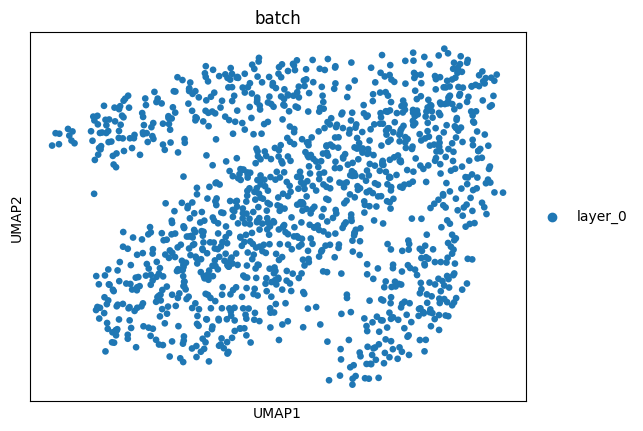

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_12/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 13	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


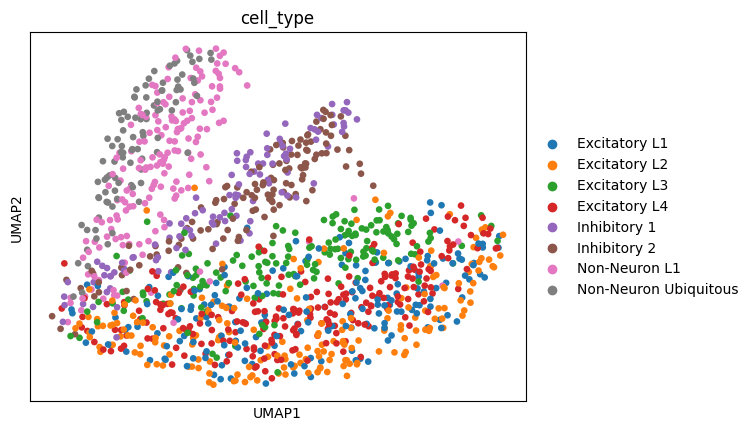

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


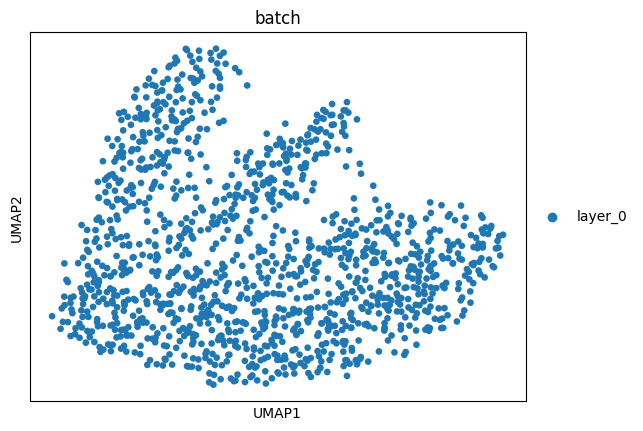

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_13/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 14	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


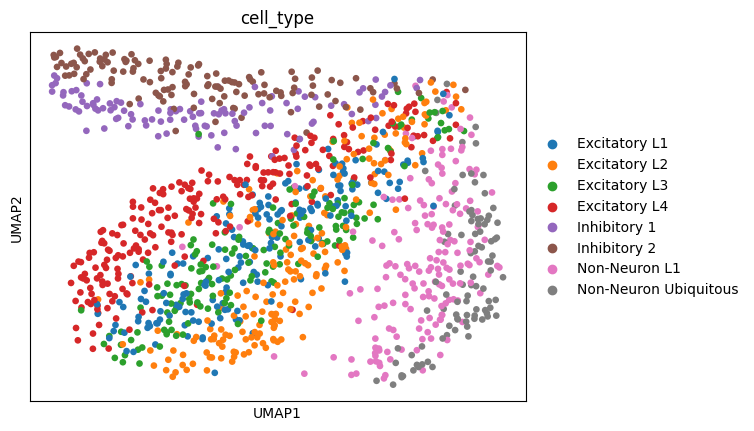

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


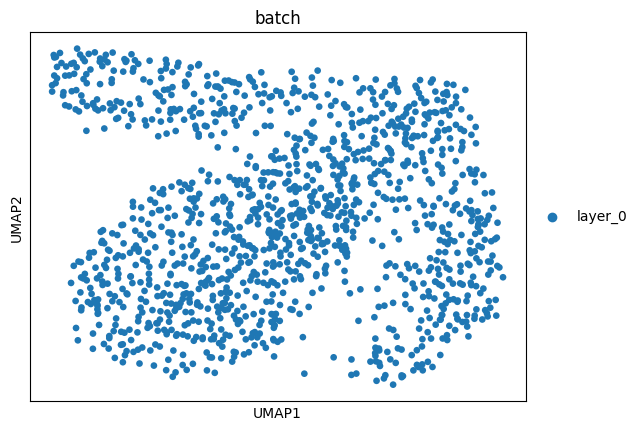

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_14/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 15	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


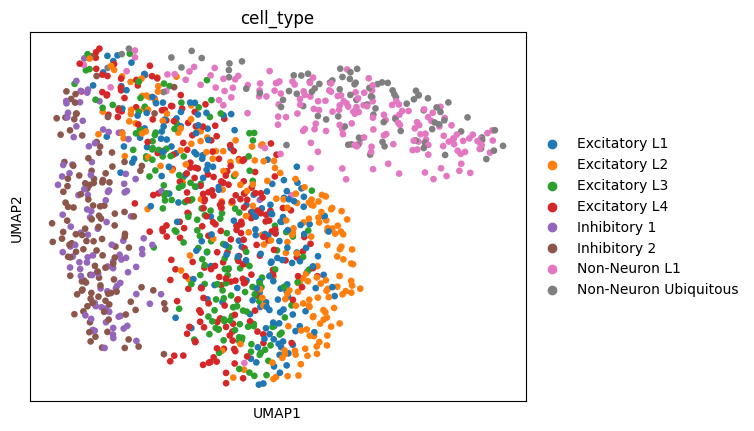

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


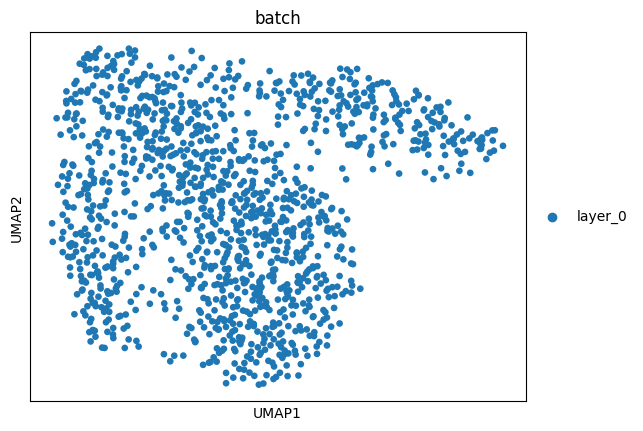

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_15/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 16	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


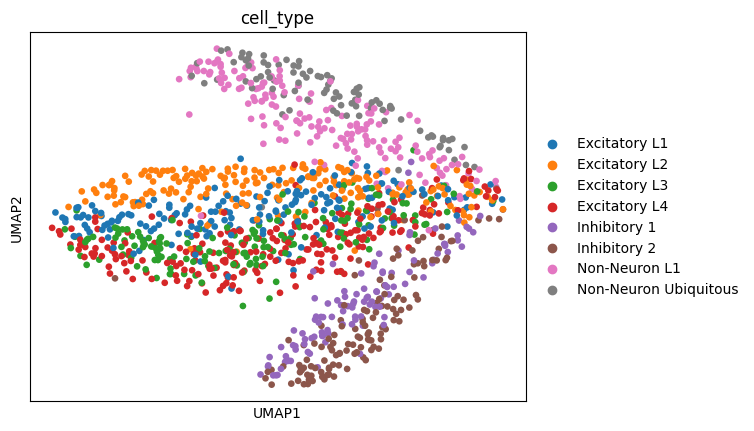

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


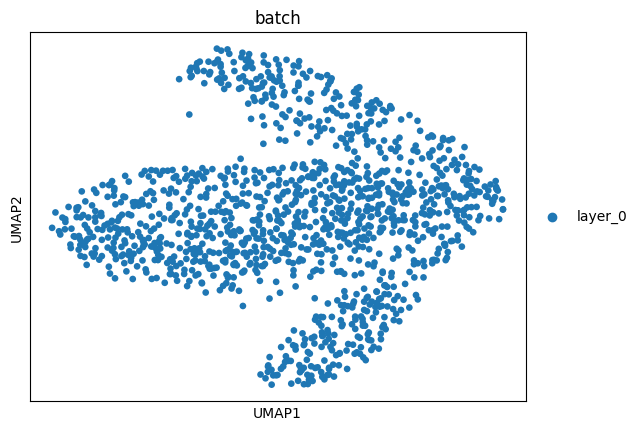

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_16/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 17	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


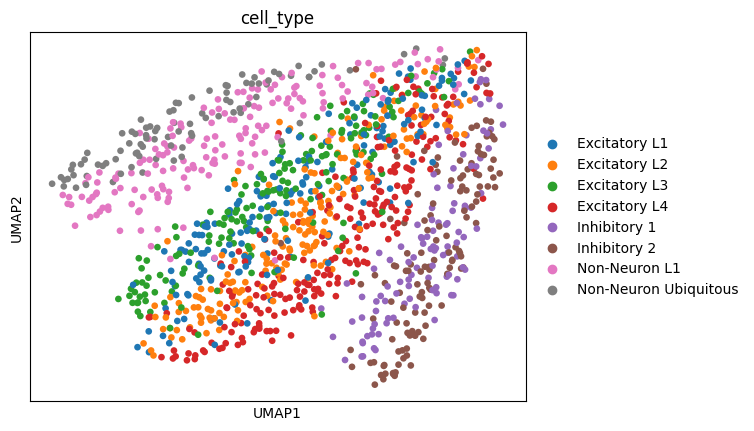

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


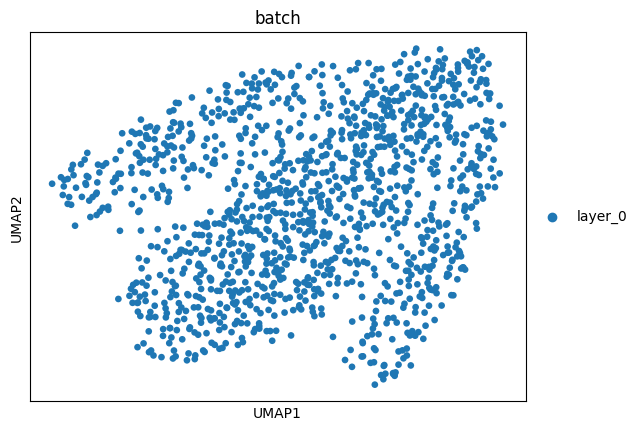

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_17/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 18	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


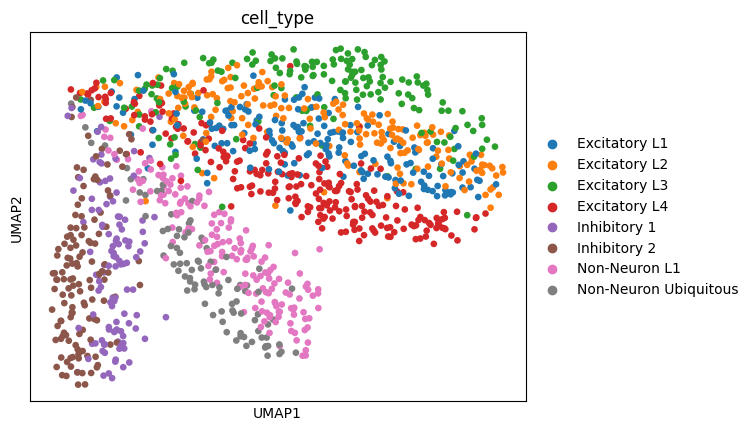

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


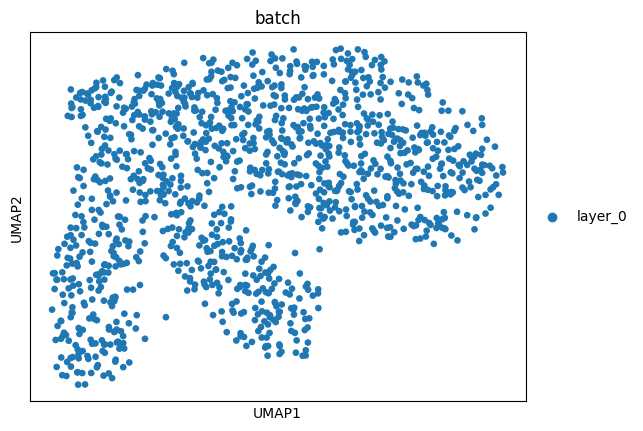

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_18/processed_dataset.h5ad
sigX_scale: 1.0	sigY_scale: 3.0	noise_metagene_parameter: 4.0	random_state: 19	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


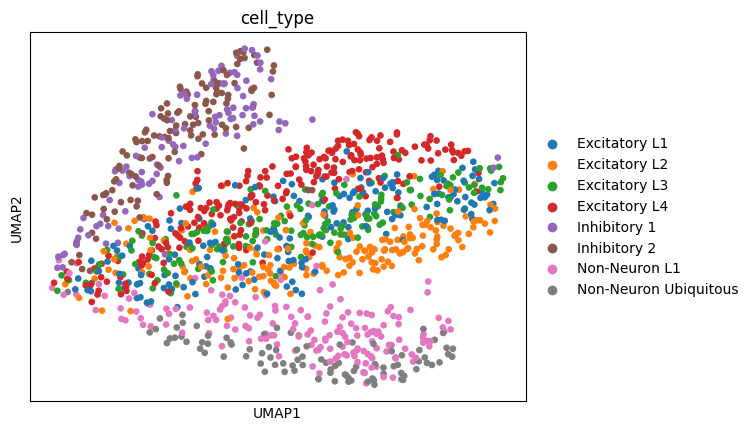

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


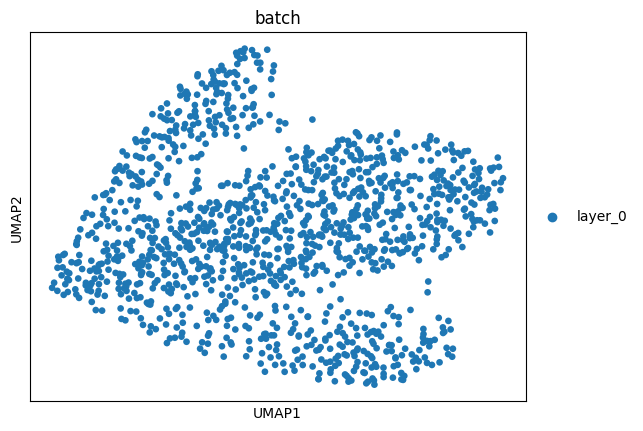

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-3.0_sigX-scale-1.0_noise-metagene-parameter_4.0/random_state_19/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 0	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


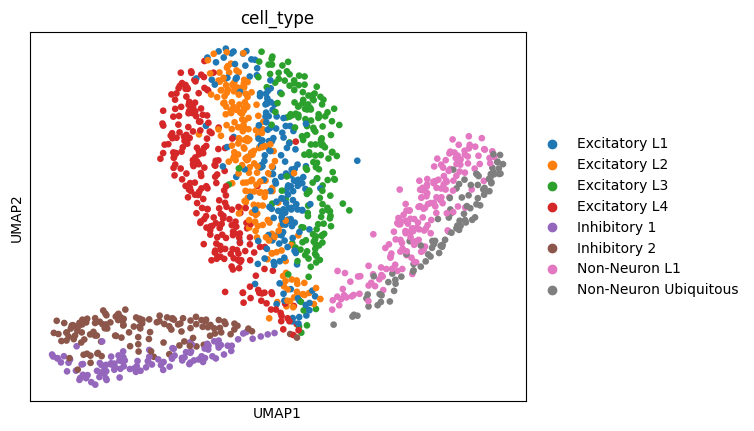

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


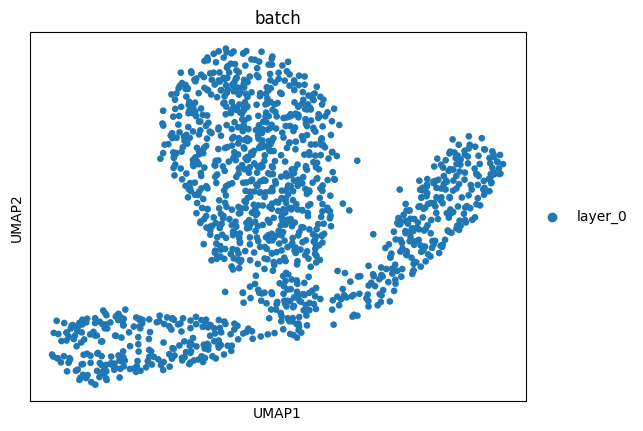

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_0/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 1	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


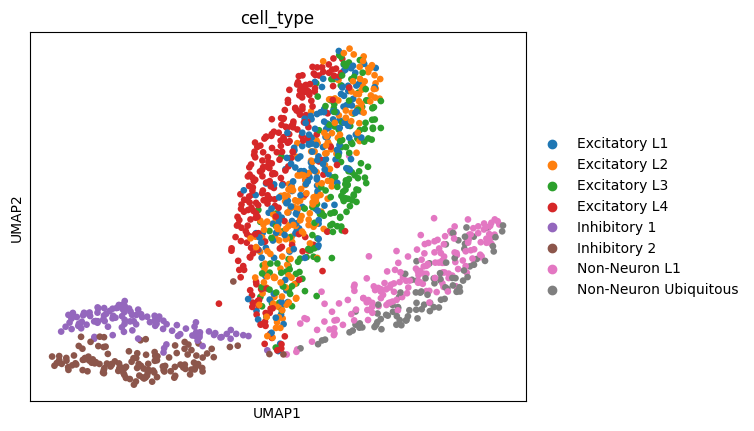

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


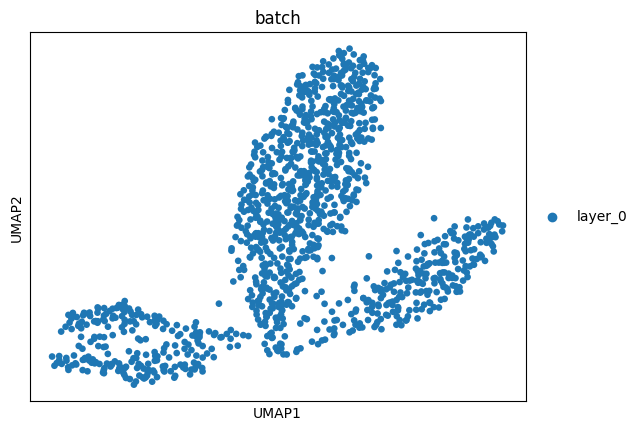

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_1/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 2	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


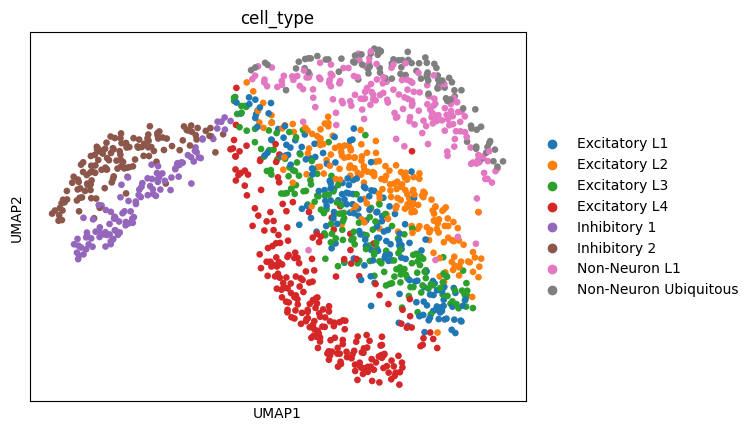

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


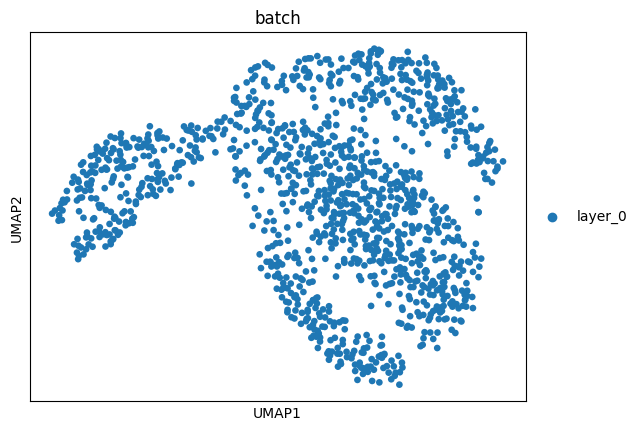

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_2/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 3	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


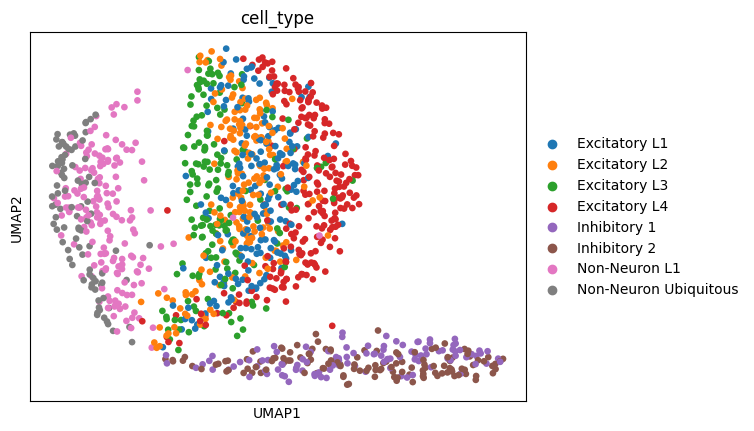

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


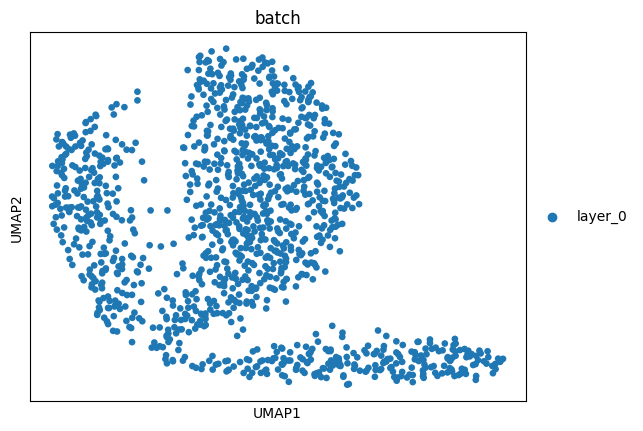

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_3/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 4	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


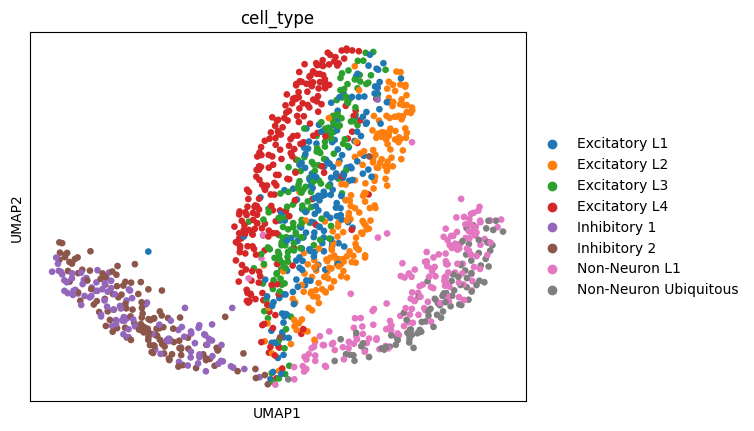

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


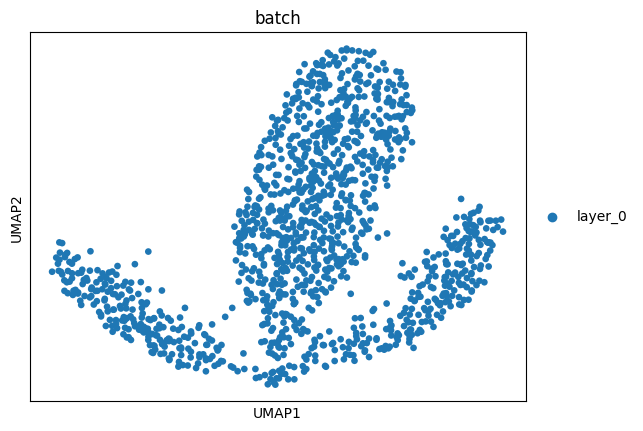

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_4/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 5	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


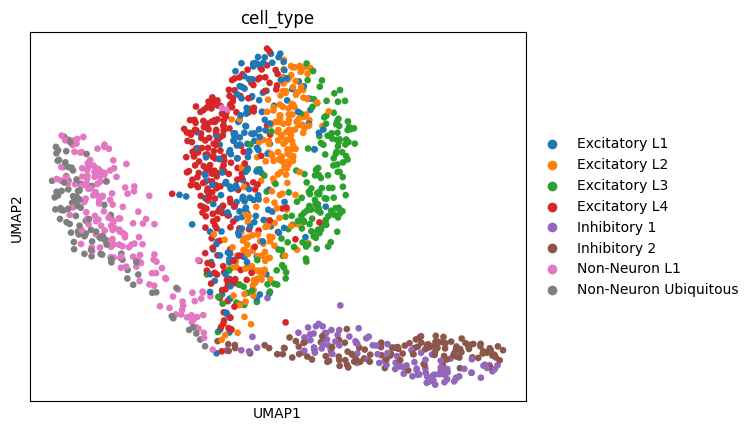

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


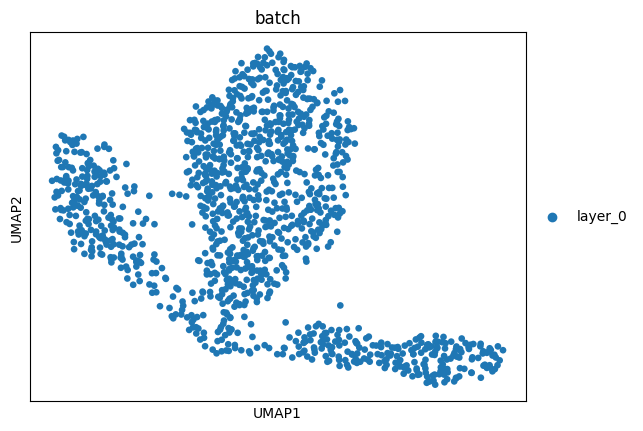

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_5/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 6	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


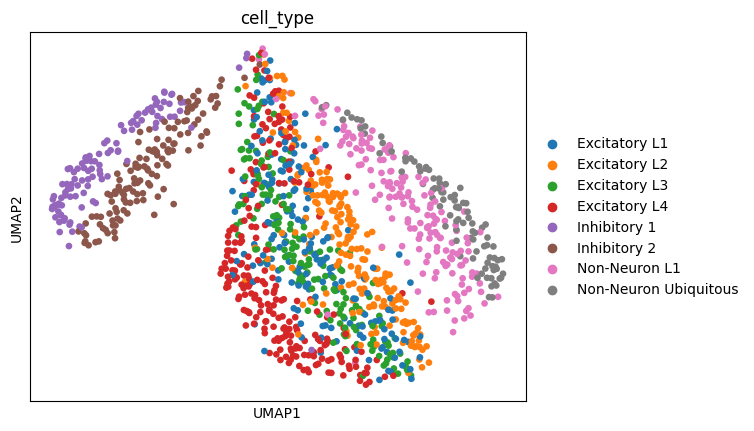

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


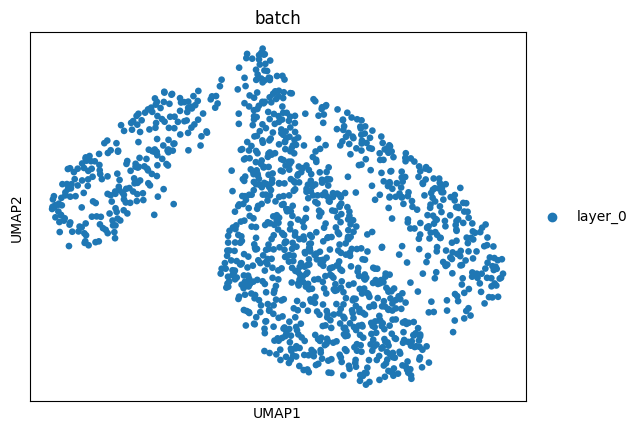

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_6/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 7	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


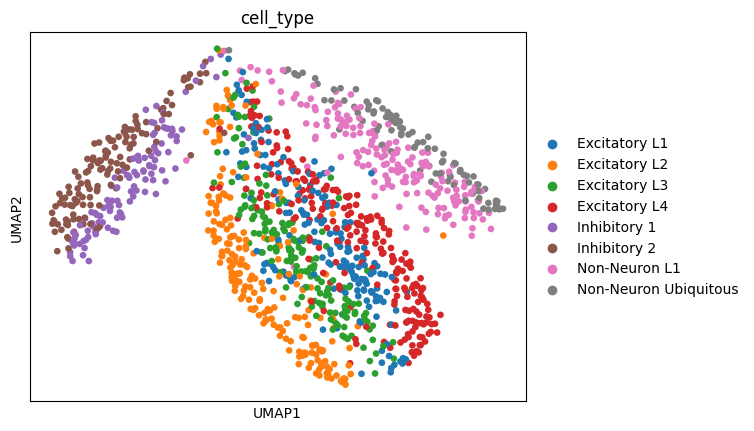

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


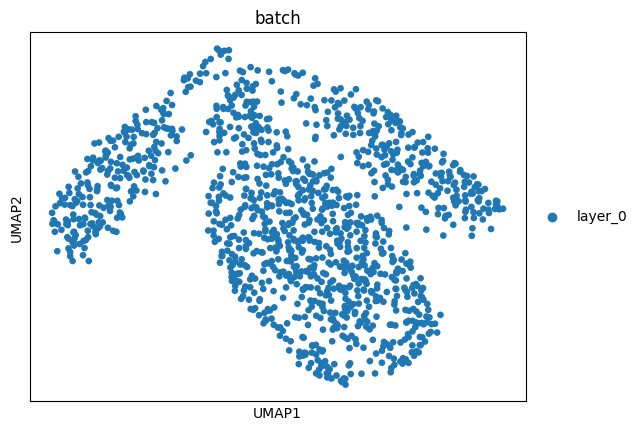

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_7/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 8	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


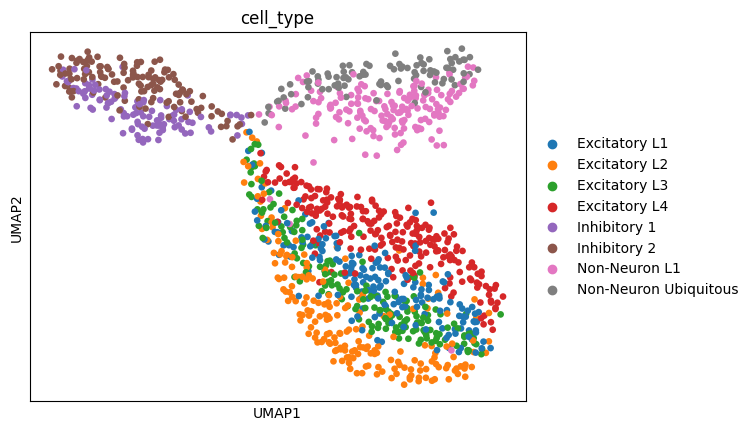

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


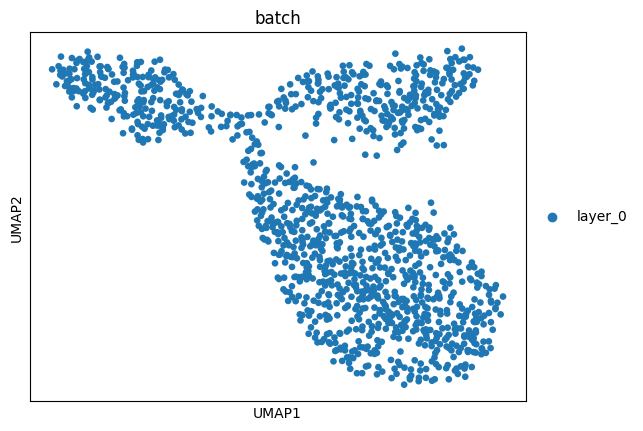

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_8/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 9	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


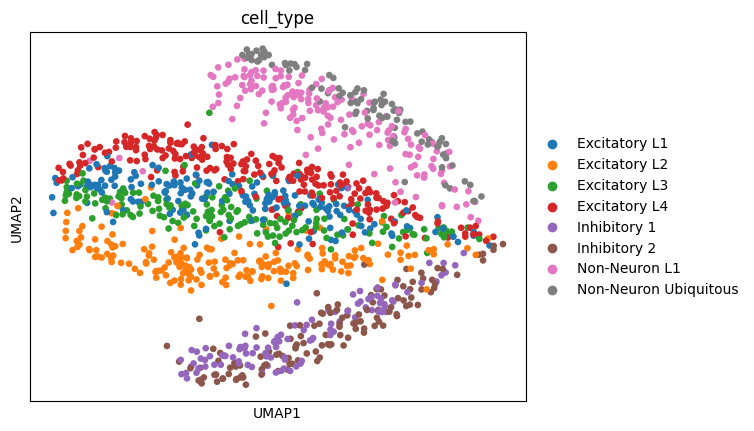

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


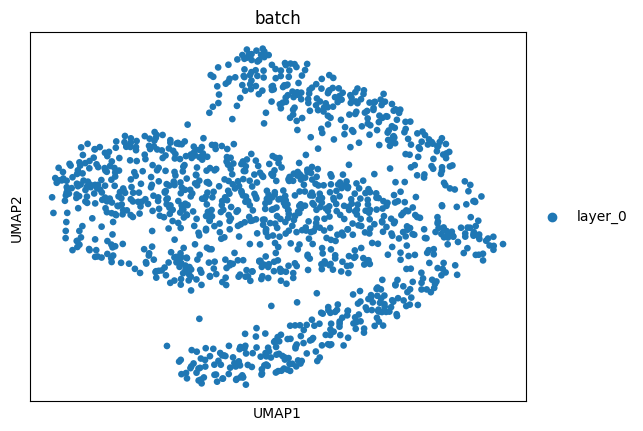

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_9/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 10	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


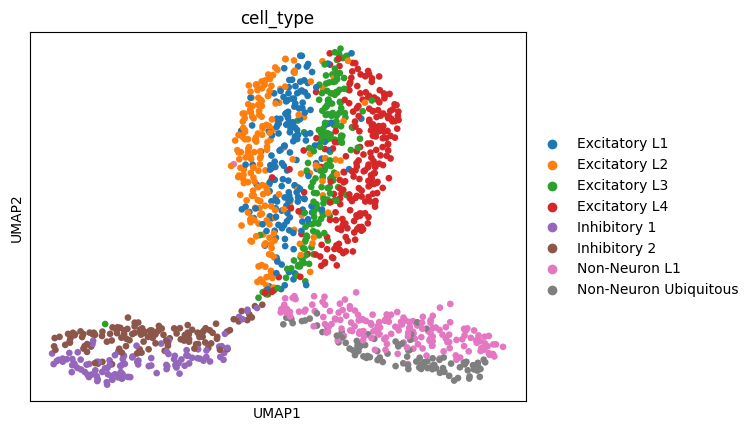

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


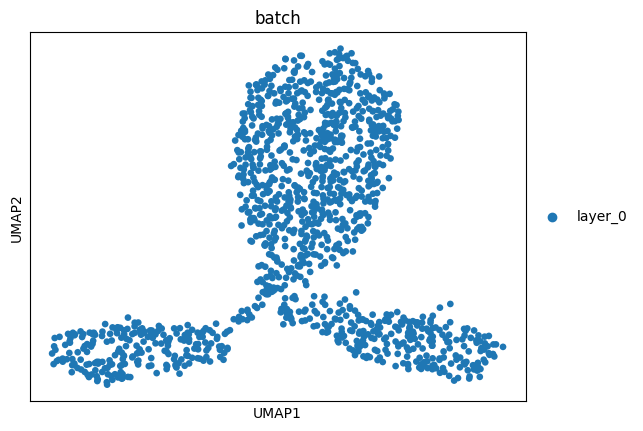

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_10/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 11	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


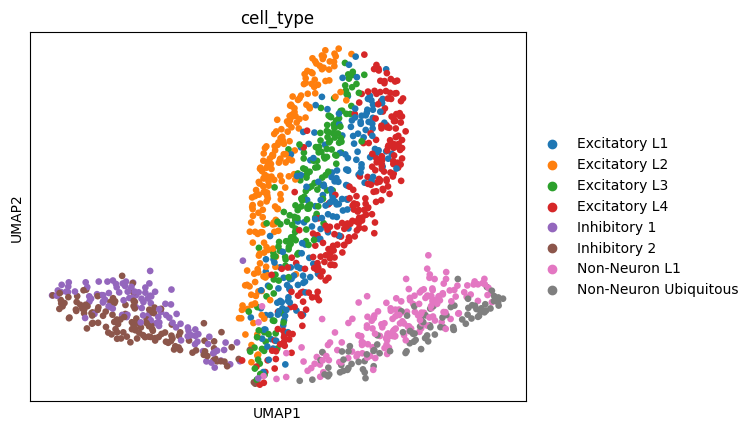

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


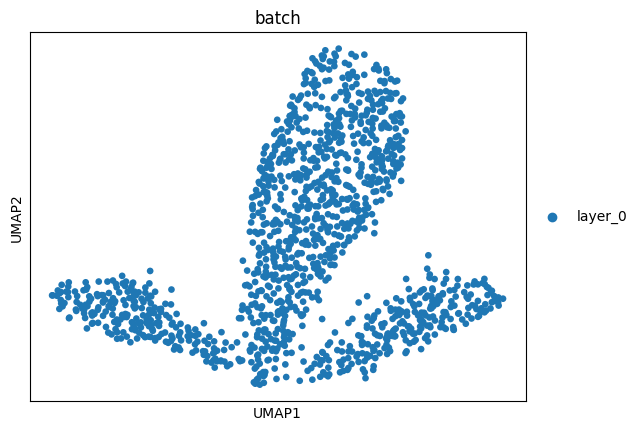

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_11/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 12	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


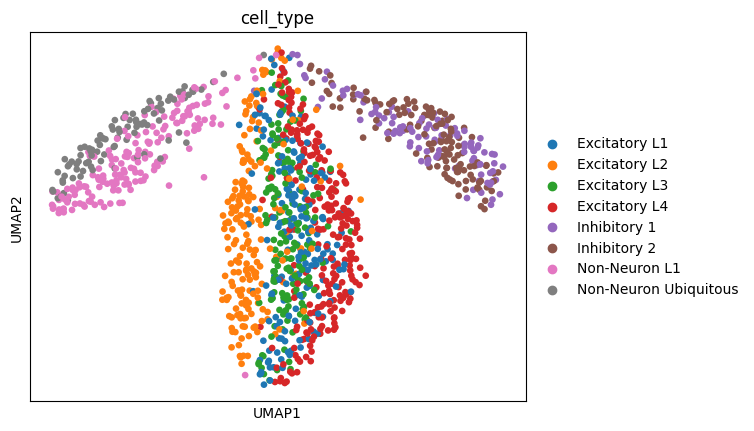

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


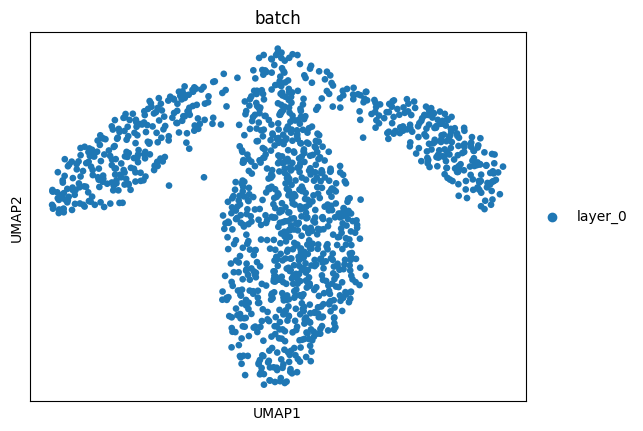

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_12/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 13	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


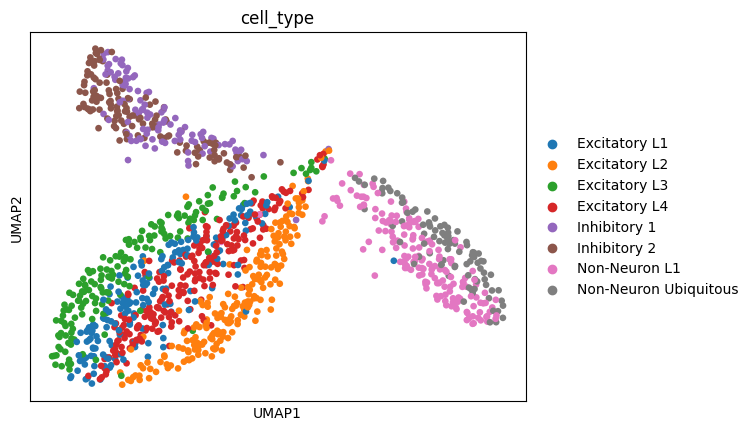

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


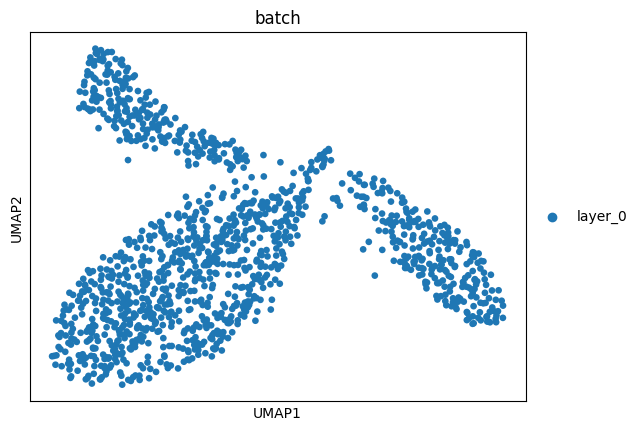

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_13/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 14	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


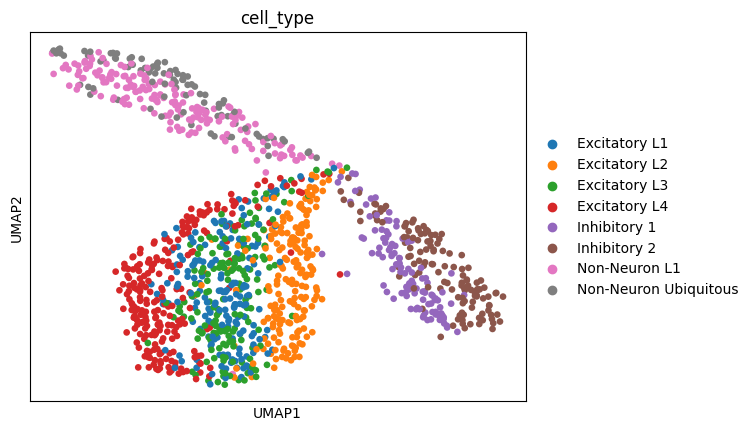

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


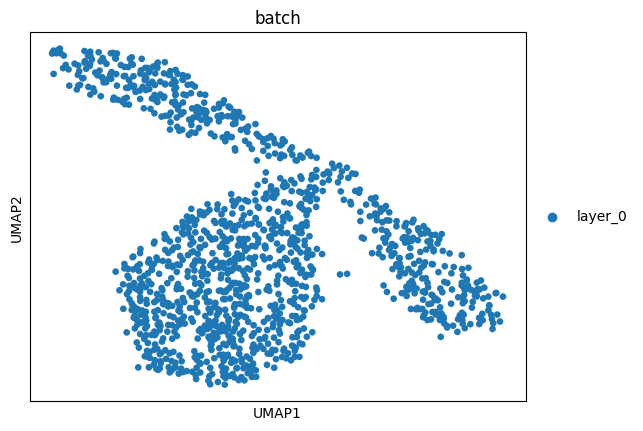

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_14/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 15	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


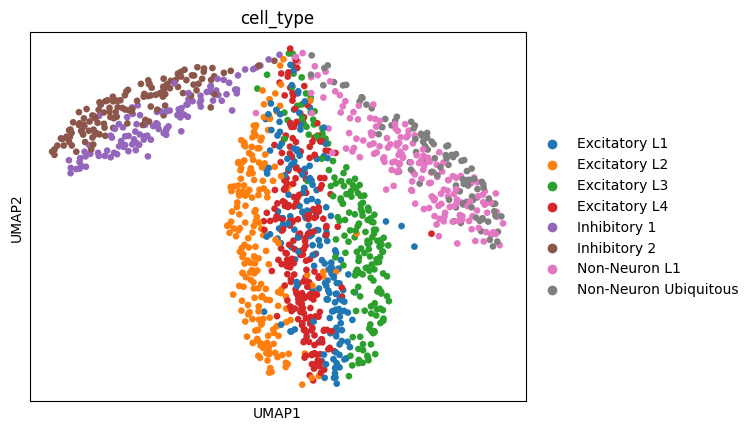

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


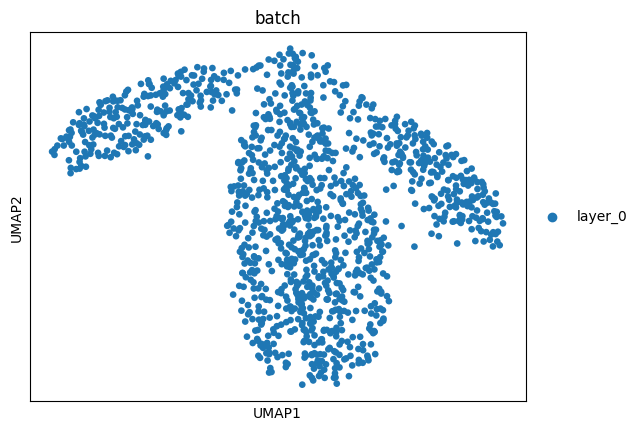

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_15/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 16	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


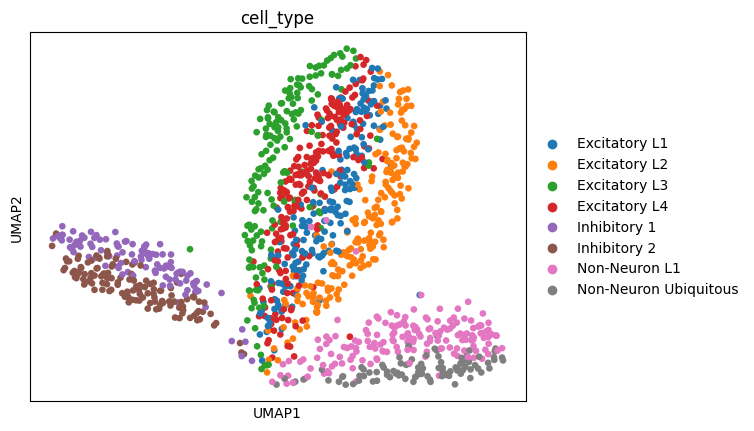

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


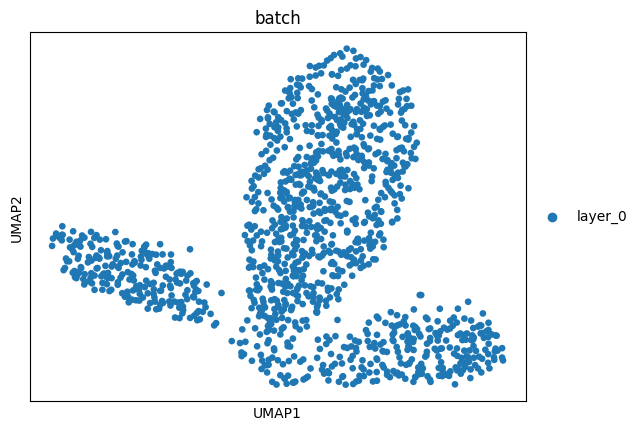

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_16/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 17	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


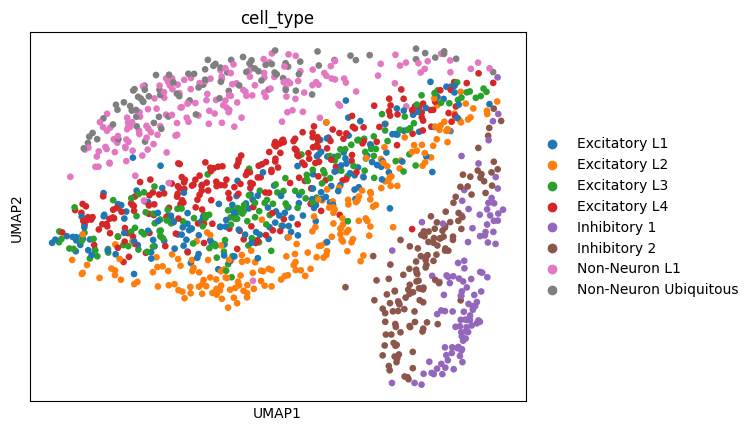

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


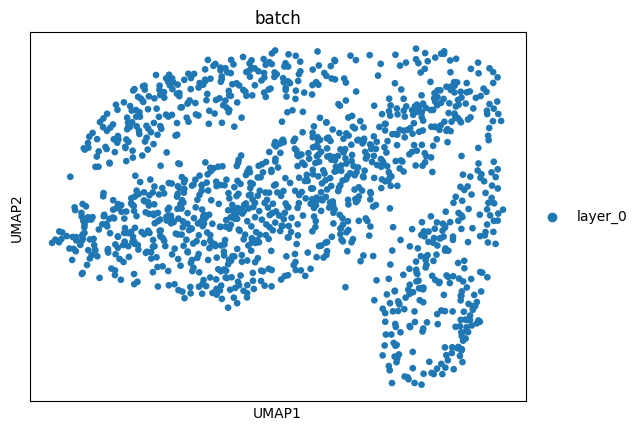

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_17/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 18	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


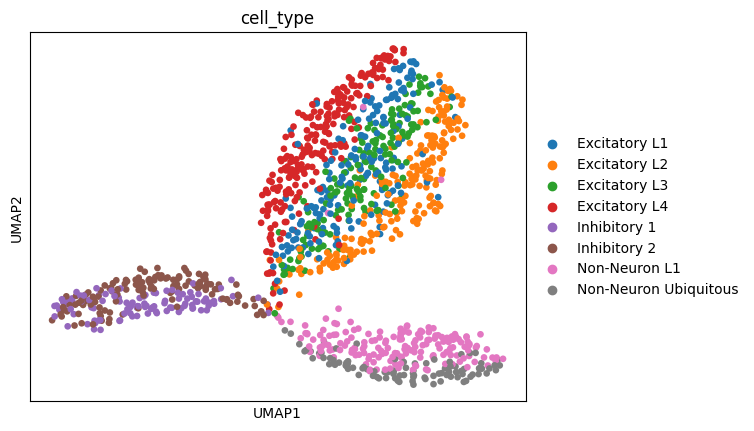

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


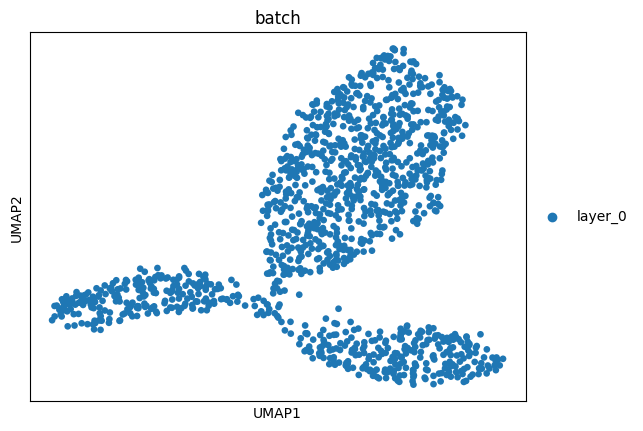

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_18/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.0	noise_metagene_parameter: 4.0	random_state: 19	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


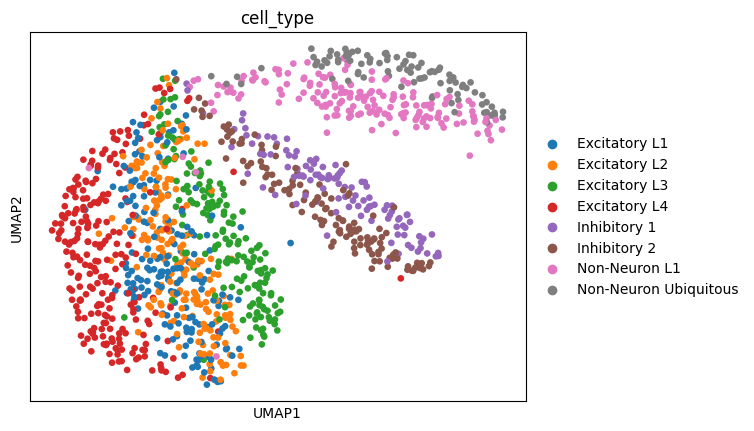

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


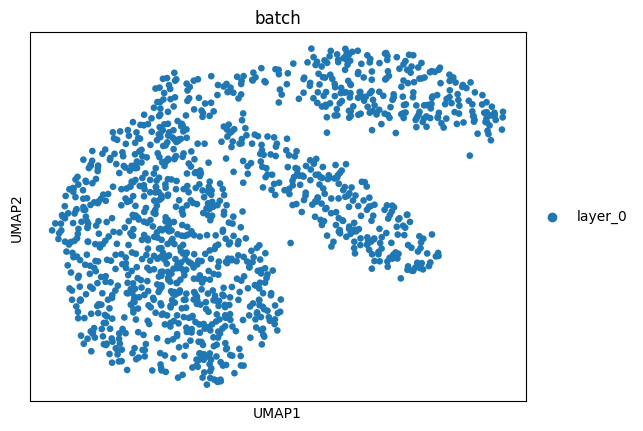

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.0_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_19/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 0	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


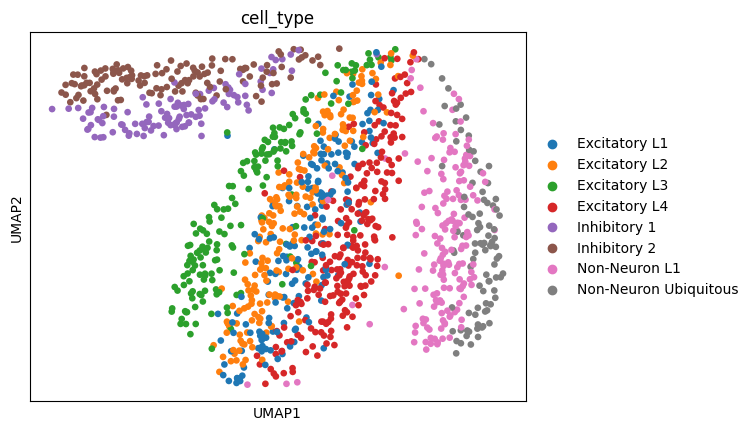

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


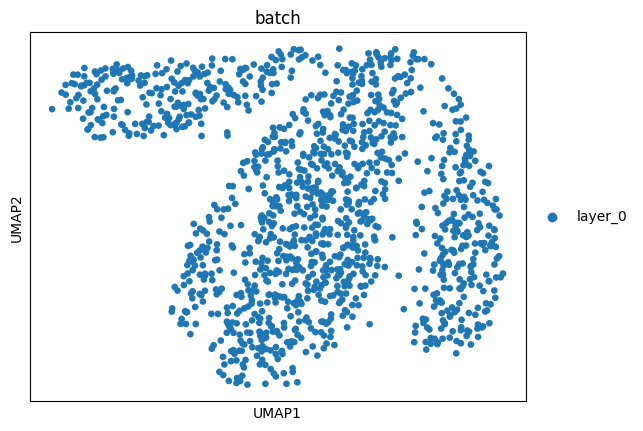

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_0/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 1	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


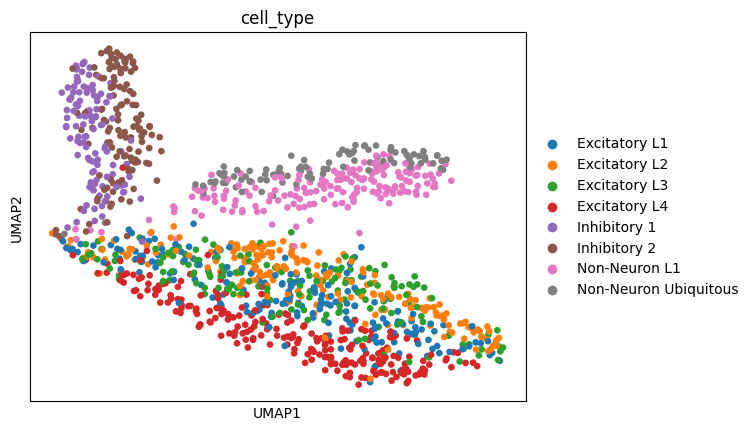

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


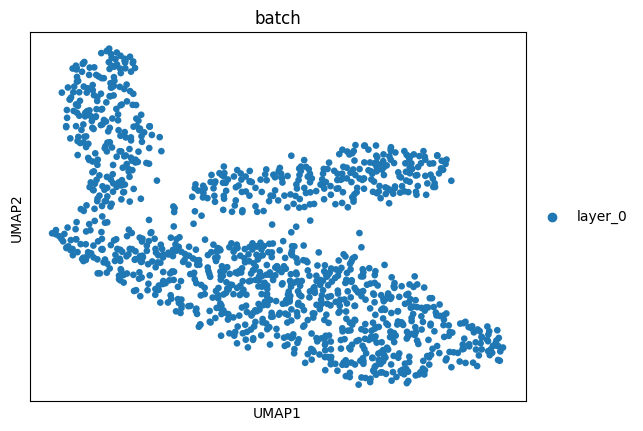

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_1/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 2	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


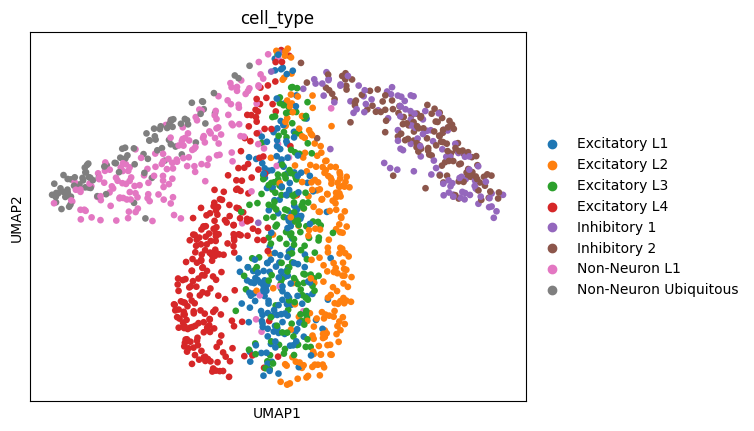

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


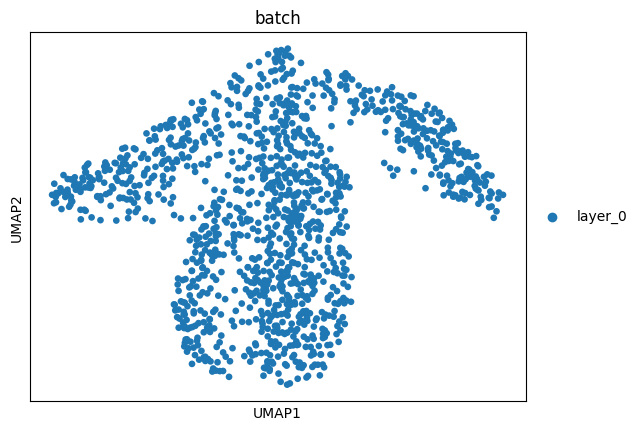

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_2/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 3	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


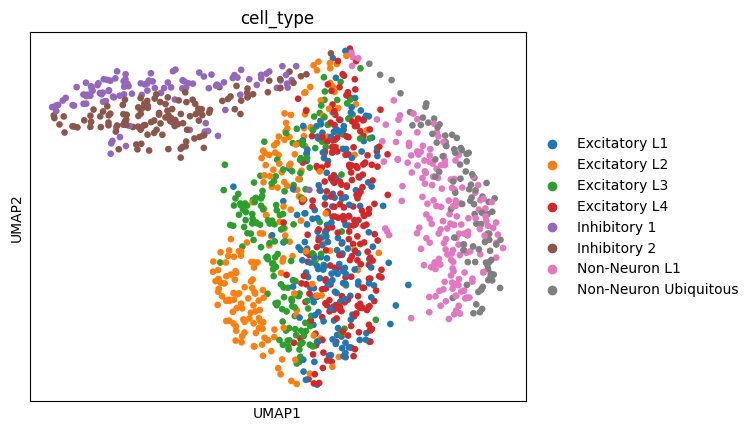

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


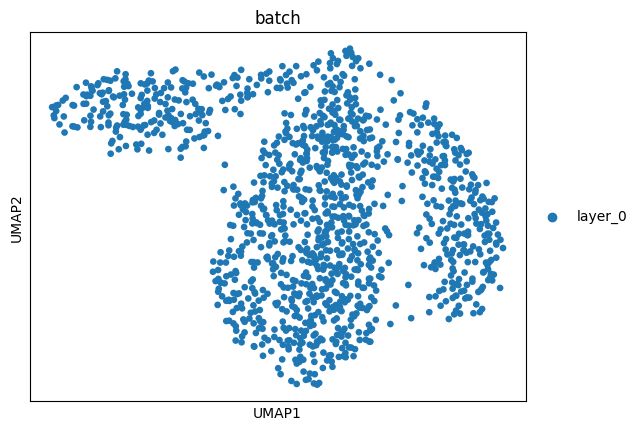

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_3/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 4	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


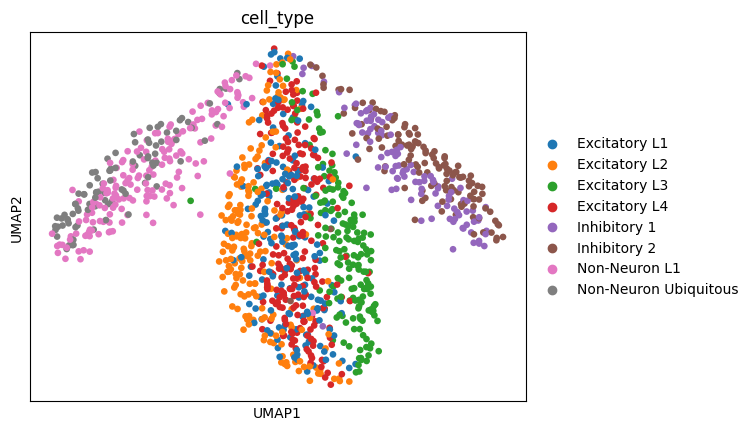

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


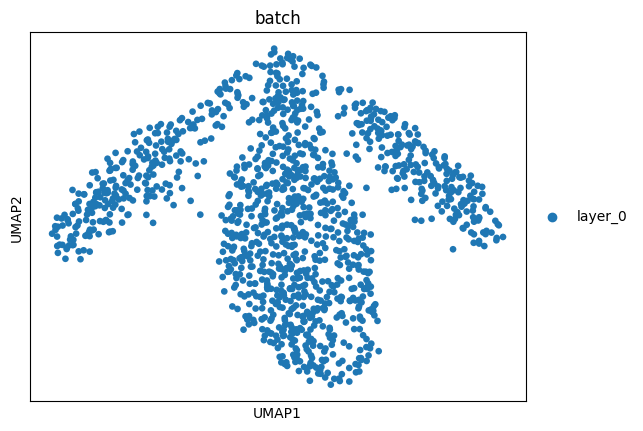

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_4/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 5	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


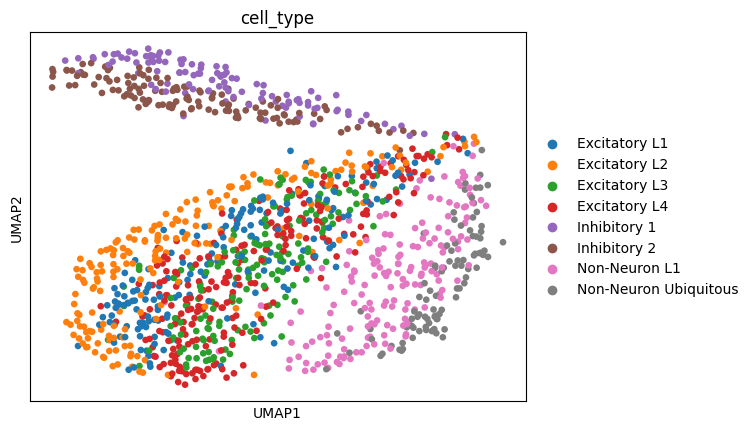

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


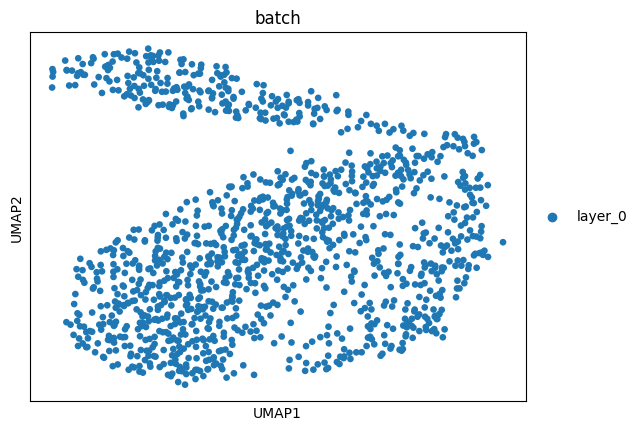

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_5/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 6	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


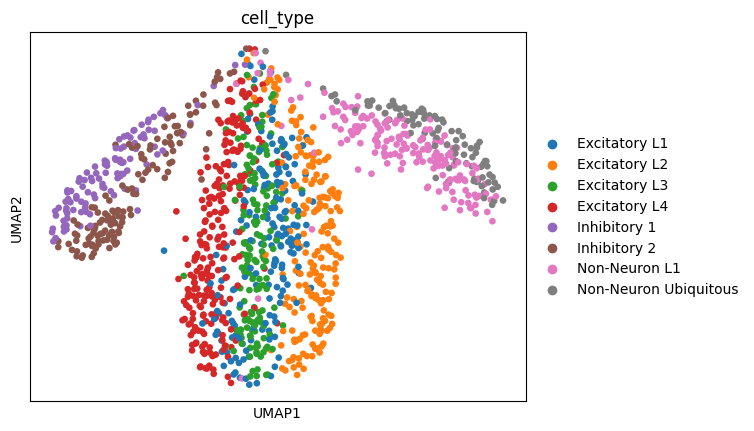

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


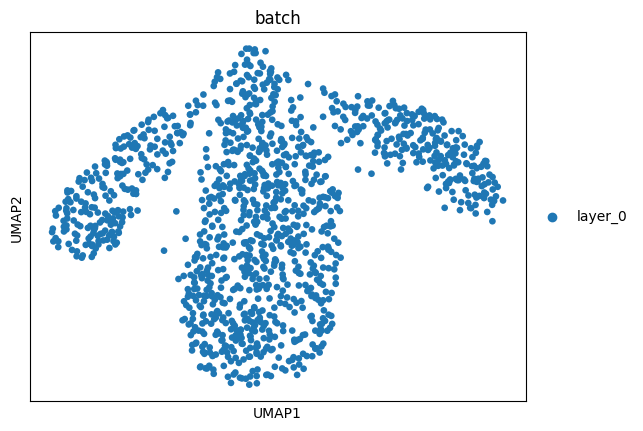

../../data/synthetic_cortex/final_hierarchical/num_replicates_1/synthetic_1296_100_sigY-scale-1.5_sigX-scale-1.5_noise-metagene-parameter_4.0/random_state_6/processed_dataset.h5ad
sigX_scale: 1.5	sigY_scale: 1.5	noise_metagene_parameter: 4.0	random_state: 7	num_replicates: 1	
layer_0
Simulating layer-annotated expression...
         Falling back to preprocessing with `sc.pp.pca` and default params.


/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


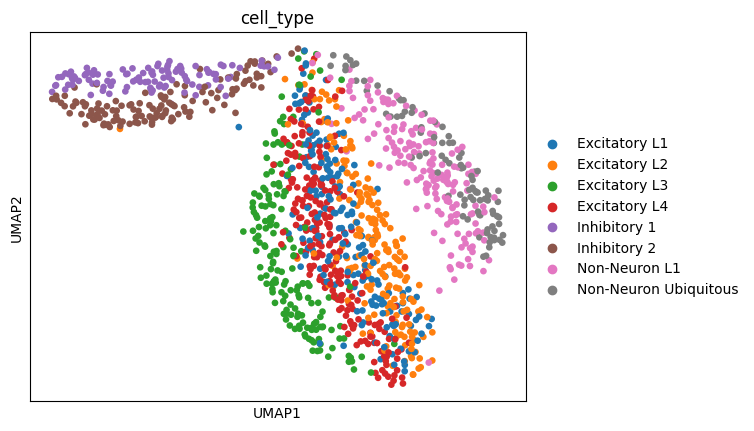

/work/magroup/shahula/bin/miniconda3/envs/popari_distribution/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


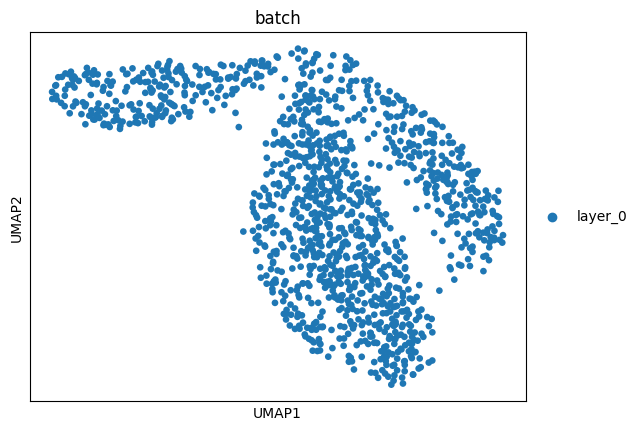

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [19]:
import itertools

root_path = Path("../../data/synthetic_cortex/final_hierarchical/")
num_genes = 100

cell_type_definitions = {
    "Excitatory L1":         [0.5, 0, 0, 0, 0, 1, 0, 0, 0],
    "Excitatory L2":         [0.5, 0, 0, 0, 0, 0, 1, 0, 0],
    "Excitatory L3":         [0.5, 0, 0, 0, 0, 0, 0, 1, 0],
    "Excitatory L4":         [0.5, 0, 0, 0, 0, 0, 0, 0, 1],
    "Inhibitory 1":          [0, 0.5, 0, 1, 0, 0, 0, 0, 0],
    "Inhibitory 2":          [0, 0.5, 0, 0, 1, 0, 0, 0, 0],
    "Non-Neuron L1":         [0, 0, 1, 0, 0, 0.5, 0, 0, 0],
    "Non-Neuron Ubiquitous": [0, 0, 1, 0, 0, 0, 0, 0, 0],
}

layer_distributions = {
    "L1": {
        "Excitatory L1": 0.43,
        "Inhibitory 1": 0.1,
        "Non-Neuron L1": 0.4,
        "Non-Neuron Ubiquitous": 0.07,
    },
    "L2": {
        "Excitatory L2": 0.93,
        "Non-Neuron Ubiquitous": 0.07,
    },
    "L3": {
        "Excitatory L3": 0.53,
        "Inhibitory 1": 0.1,
        "Inhibitory 2": 0.3,
        "Non-Neuron Ubiquitous": 0.07,
    },
    "L4": {
        "Excitatory L4": 0.73,
        "Inhibitory 1": 0.1,
        "Inhibitory 2": 0.1,
        "Non-Neuron Ubiquitous": 0.07,
    },
}


metagene_variation_probabilities = [0, 0.3, 0, 0, 0.3, 0, 0.3, 0.3, 0.3]

grid_size = 36
default_parameters = {
    "layer": {
        "spatial_distributions": layer_distributions,
        "cell_type_definitions": cell_type_definitions,
        "metagene_variation_probabilities": metagene_variation_probabilities,
        "width": 1,
        "height": 1,
        "grid_size": grid_size,
    } 
}


sigX_scale_options = np.linspace(1.0, 3.0, 5)
num_replicates_options = range(1, 2, 1)
sigY_scale_options = np.linspace(1.0, 3.0, 5)
noise_metagene_parameter_options = np.linspace(4.0, 4.0, 1)

options = itertools.product(sigX_scale_options, sigY_scale_options, noise_metagene_parameter_options, num_replicates_options, np.arange(20))
counter = 0
for sigX_scale, sigY_scale, noise_metagene_parameter, num_replicates, random_state in options:
    print(f"sigX_scale: {sigX_scale}\t"
          f"sigY_scale: {sigY_scale}\t"
          f"noise_metagene_parameter: {noise_metagene_parameter}\t"
          f"random_state: {random_state}\t"
          f"num_replicates: {num_replicates}\t"
    )


    simulation_parameters = {
        'num_real_metagenes': 9,
        'num_noise_metagenes': 0,
        'sigY_scale': sigY_scale,
        'sigX_scale': sigX_scale,
        "real_metagene_parameter": 8.0,
        "noise_metagene_parameter": noise_metagene_parameter,
        'lambda_s': 1.,
    }
    
    replicate_simulation_parameters = {}
    replicate_parameters = {}
    
    for replicate in range(num_replicates):
        replicate_simulation_parameters[f"layer_{replicate}"] = simulation_parameters
        replicate_parameters[f"layer_{replicate}"] = default_parameters["layer"]
        
    run_path = root_path / f"num_replicates_{num_replicates}" / f"synthetic_{grid_size**2}_{num_genes}_sigY-scale-{sigY_scale}_sigX-scale-{sigX_scale}_noise-metagene-parameter_{noise_metagene_parameter}" / f"random_state_{random_state}"
    run_path.mkdir(exist_ok=True, parents=True)

    multireplicate_dataset = MultiReplicateSyntheticDataset(num_genes, replicate_parameters, SyntheticDataset, random_state=random_state, verbose=1)
    
    for replicate in range(num_replicates):
        multireplicate_dataset.datasets[f"layer_{replicate}"].domain_canvas.load_domains(layer_domains)
    
    multireplicate_dataset.assign_layer_labels()
    multireplicate_dataset.simulate_expression(replicate_simulation_parameters)

    # Actually spatial downsampling
    # Only handles sparsity up to a certain level, due to method of choosing independent set
        
    multireplicate_dataset.calculate_neighbors(coord_type="grid", n_neighs=4, delaunay=False)    

    rng = np.random.default_rng(seed=0)
    sparsity = 0.15
    for name, dataset in multireplicate_dataset.datasets.items():
        num_cells, num_genes = dataset.shape
        num_dropout_cells = np.rint(sparsity * num_cells).astype(int)
        
        adjacency_list = adjacency_matrix_to_list(dataset.obsp["adjacency_matrix"])
        
        for gene_index in range(num_genes):
            independent_set = sample_graph_iid(adjacency_list, set(range(num_cells)), num_cells)
        
            dropout_cells = independent_set[:num_dropout_cells]
            dataset.X[dropout_cells, gene_index] = 0

    (replicate_names, datasets) = zip(*multireplicate_dataset.datasets.items())
    
    # Sanity check plot
    replicate_names, dataset_copies = zip(*multireplicate_dataset.datasets.items())
    merged_dataset = ad.concat(dataset_copies, label="batch", keys=replicate_names, merge="unique", uns_merge="unique", pairwise=True)                                                                                                                                        
    
    sc.pp.neighbors(merged_dataset)
    sc.tl.umap(merged_dataset)
    
    fig, ax = plt.subplots()
    sc.pl.umap(merged_dataset, color="cell_type", ax=ax)
    
    fig, ax = plt.subplots()
    sc.pl.umap(merged_dataset, color="batch", ax=ax)
    
    
    save_anndata(run_path/ "processed_dataset.h5ad", datasets)
    
    print(run_path/ "processed_dataset.h5ad")
        
#     # Initialize
#     test = Popari(
#         K=11,
#         lambda_Sigma_x_inv=1e-4,
#         dataset_path=run_path/"processed_dataset.h5ad",
#         initialization_method="leiden",
#         verbose=0,
#         prior_x_modes=None,
#         random_state=0
#     )
    
#     print(f"Test total expression: {test.datasets[0].X.sum()}")
#     for index, dataset in enumerate(datasets):
#         sklearn_results = train_sklearn_NMF(dataset, 11, random_state, label_key="cell_type")
#         report_sklearn_NMF(sklearn_results, label_key="cell_type")

#         test.datasets[index].obsm["sklearn_cell_embedding"] = sklearn_results.obsm["normalized_X"]
        
#     tl.leiden(test, target_clusters=8, use_rep="sklearn_cell_embedding")
    
# #     compute_confusion_matrix(test, predictions="leiden", labels="cell_type_general")
# #     plot_confusion_matrix(test, labels="cell_type_general")

#     tl.compute_empirical_correlations(test, feature="ground_truth_X", output="ground_truth_empirical_correlation")                           
#     tl.multireplicate_heatmap(test, uns="ground_truth_empirical_correlation", aspect=1, cmap="bwr", vmin=-10, vmax=10)
#     plt.show()
    
# #     plot_in_situ(test, color="cell_type_general")
#     plt.show()